In [1]:
#######################################################################################
# Read Me Section:
## Name:
# Kaylen Smith Darnbrook
# Student ID:
# 2135667
# Course:
# M.S.c Machine Learning and Artificial Intelligence
# Module:
## DemonstrationProgressiveFaceGeneration
## Description: 
# This module is responsible for the creation and evaluation of the Curricullum Learning Based Generative Accumulation Of Photons.
# 
# This module is responsible for creating the experimentation and creation of
# pipeline for the generation of faces using the Generative Accumulation Of Photons.
# The module will also be responsible for the analysis of the faces generated.
# It uses the FFHQ256 dataset to train the model. The model is then saved to the
# 'models' directory. The model is then used to generate faces from the FFHQ256 dataset.
# A single model and cascade model implementation of GAP is used. The model is trained
# using the Adam optimizer and the loss function is the PhotonLoss Function. Each model
# is trained for 30 epochs. The models are compared using the Psnr, SSIM and Perceptual
# loss metric.
#####################################################################################

In [2]:
# Import Relevant Libraries:

# Import modules for system managment, io and file management 
import os 
import sys
import time 
import random

# Import modules for data manipulation and analysis
import numpy as np
import pandas as pd
import scipy as sp

# Import modules for data visualisation
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})
sns.set_context("notebook")
from PIL import Image

# Import modules for Deep learning
import torch

from torch.utils.data import DataLoader
torch.set_float32_matmul_precision('medium')
torch.autograd.set_detect_anomaly(True)

# Pytorch Lightning Modules:
import pytorch_lightning as pL
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping, LearningRateMonitor
from pytorch_lightning.callbacks import LearningRateMonitor

# Import modules for model selection and evaluation.
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Import the DataLoader
#from BinomDataset4 import FacesDataset
from PoissonDataset10 import FacesDataset
from PoissonValidator2 import ValidationSetGenerator
from OriginalGAPUNet import UNet
import wandb 
from pytorch_lightning.loggers import WandbLogger

# Visualisation Software
import time
import numpy as np
import lpips

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.14 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


In [3]:
'''
Samples an image using Generative Accumulation of Photons (GAP) based on an initial photon image.
If the initial photon image contains only zeros the model samples from scratch. 
If it contains photon numbers, the model performs diversity denoising.

        Parameters:
                input_image (torch tensor): the initial photon image, containing integers (batch, channel, y, x).  
                model: the network used to predict the next phton location.
                max_photons (int): stop sampling when image contains more photons. 
                max_its (int): stop sampling after max_its iterations. 
                max_psnr (float): stop sampling when pseudo PSNR is larger max_psnr
                save_every_n (int): store and return images at every nth step. 
                augment (bool): use 8-fold data augmentation (default is False) 
                beta (float): photon number is increased exponentially by factor beta in each step.
        Returns:
                denoised (numpy array): denoised image at the end of that sampling process.
                photons (numpy array): photon image at the end of the sampling process.
                stack (list): list of numpy arrays containing intermediate results.
                i (int) number of executed iterations.
'''
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            break
            
        if psnr > max_psnr:
            break
    
        denoised = model(photons)
        denoised.detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    return denoised[...].detach().cpu().numpy(), photons[...].detach().cpu().numpy(), stack, i

In [4]:
# Wraps around the sample_image_3 function to generate the faces.
def Sample_Image(input_image, model,  max_psnr, max_its = 1000, beta = 0.005, save_every_n = 10, device = 'cuda'):
    channels = 3
    batch_size = 1
    pixels_x = 128
    pixels_y = 128

    model = model.to(device)
    model.eval()
    input_image = input_image.to(device)

    denoised, photons, stack, i = sample_image_3(input_image, model, max_its = max_its, max_psnr = max_psnr, 
                                                 beta = beta, save_every_n = save_every_n)
    return denoised, photons, stack, i

In [5]:
# Sets the plotting parameters for the visualisation of the images.
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["savefig.facecolor"] = "red"
plt.rc("text", usetex = False)
plt.rc("font", family = "Times New Roman")
plt.rcParams["axes.grid"] = False

In [6]:
## Configuration
# Set the seed for reproducibility
seed = 42
np.random.seed(seed)
torch.manual_seed(seed)

# Set the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")
GREYSCALE = False

# Set the path to the data
root_path = r"ffhq256_dataset\ffhq256" 
out_dir =r"TestSet"
Batch_Size = 32
load_pretained = False
NUM_Features = 128 * 128
max_epochs = 30
patience = 10
minpsnr = -40
maxpsnr = 32

Device: cuda


In [7]:
# Generates plots of the Psnr, SSIM and Perceptual Loss from the data.
from IPython.display import display
def Plot_Creater(Psnr_Distribution, SSIM_Distribution, Perceptual_Distribution, minpsnr, maxpsnr):
    Psnr_Distribution = Psnr_Distribution.copy()
    SSIM_Distribution = SSIM_Distribution.copy()
    Perceptual_Distribution = Perceptual_Distribution.copy()
    Psnr_Distribution = pd.DataFrame(Psnr_Distribution, columns = ["PSNR"])
    Psnr_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution.shape[0])
    Psnr_Distribution["PSNR_Average"] = Psnr_Distribution["PSNR"].rolling(window = 12).mean()
    Psnr_Distribution["PSNR_Variance"] = Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Upper"] = Psnr_Distribution["PSNR_Average"] + Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Lower"] = Psnr_Distribution["PSNR_Average"] - Psnr_Distribution["PSNR"].rolling(window = 12).std()   
    Psnr_Distribution.dropna(inplace = True)
    display(Psnr_Distribution.describe())

    SSIM_Distribution = pd.DataFrame(SSIM_Distribution, columns = ["SSIM"])
    SSIM_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution.shape[0])
    SSIM_Distribution["SSIM_Average"] = SSIM_Distribution["SSIM"].rolling(window = 12).mean()
    SSIM_Distribution["SSIM_Variance"] = SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Upper"] = SSIM_Distribution["SSIM_Average"] + SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Lower"] = SSIM_Distribution["SSIM_Average"] - SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution.dropna(inplace = True)
    display(SSIM_Distribution.describe())

    Perceptual_Distribution = pd.DataFrame(Perceptual_Distribution, columns = ["1-PL"])
    Perceptual_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution.shape[0])
    Perceptual_Distribution["1-PL_Average"] = Perceptual_Distribution["1-PL"].rolling(window = 12).mean()
    Perceptual_Distribution["1-PL_Variance"] = Perceptual_Distribution["1-PL"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Upper"] = Perceptual_Distribution["1-PL_Average"] + Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Lower"] = Perceptual_Distribution["1-PL_Average"] - Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution.dropna(inplace = True)
    display(Perceptual_Distribution.describe())

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
    Psnr_Area = np.trapz(Psnr_Distribution["PSNR_Average"].values, Psnr_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("PSNR")
    plt.title("Psnr vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
    SSIM_Area = np.trapz(SSIM_Distribution["SSIM_Average"].values, SSIM_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("SSIM")
    plt.title("SSIM vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.scatterplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red") 
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
    Perceptual_Area = np.trapz(Perceptual_Distribution["1-PL_Average"].values, Perceptual_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("1-Perceptual_Loss")
    plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
    plt.show()

    print(f"Psnr Area: {Psnr_Area}, SSIM Area: {SSIM_Area}, Perceptual Area: {Perceptual_Area}")

    print("Mean Psnr",Psnr_Distribution["PSNR"].mean())
    print("Std Psnr",Psnr_Distribution["PSNR"].std()) 
    print("Min Psnr",Psnr_Distribution["PSNR"].min()) 
    print("Max Psnr",Psnr_Distribution["PSNR"].max())
    print("Mean Roll Var",Psnr_Distribution["PSNR_Variance"].mean())

    print("Mean SSIM",SSIM_Distribution["SSIM"].mean())
    print("Std SSIM",SSIM_Distribution["SSIM"].std()) 
    print("Min SSIM",SSIM_Distribution["SSIM"].min()) 
    print("Max SSIM",SSIM_Distribution["SSIM"].max())
    print("Mean Roll SSIM",SSIM_Distribution["SSIM_Variance"].mean())

    print("Mean 1-PL",Perceptual_Distribution["1-PL"].mean())
    print("Std 1-PL",Perceptual_Distribution["1-PL"].std()) 
    print("Min 1-PL",Perceptual_Distribution["1-PL"].min()) 
    print("Max 1-PL",Perceptual_Distribution["1-PL"].max())
    print("Mean Roll 1-PL",Perceptual_Distribution["1-PL_Variance"].mean())

    return Psnr_Area, SSIM_Area, Perceptual_Area

In [8]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
Steps = 9
Spacing = (maxpsnr - minpsnr) // Steps
PSNR_Ranges = [(i, j) for i, j in zip(range(minpsnr, maxpsnr, Spacing), range(minpsnr + Spacing, maxpsnr + Spacing, Spacing))]
print(PSNR_Ranges)

[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32)]


In [9]:
# Generates the metric functions for the PSNR, SSIM and Pseudo_PSNR
def PSNR(original, transformed, maximum):
    mse = np.mean((original-transformed)**2)
    if mse == 0:
        return 100
    max_pixel_value = maximum
    psnr = 20 * np.log10(max_pixel_value/np.sqrt(mse))
    return psnr

def SSIM(original, transformed):
    return sp.signal.ssim(original, transformed, multichannel=True)

def Estimated_Psuedo_PSNR(transformed, image_size):
    intensity = transformed/image_size
    return 10 * np.log(intensity)

In [10]:
# Generates a plot of the random persons in the dataset.
def plot_random_persons(images, sample = 9):
    random_image_indexes=np.array(random.sample(list(range(len(images))),sample))
    images = np.array([np.asarray(Image.open(os.path.join(root_path, images[index]))) for index in random_image_indexes])

    if (np.sqrt(sample) - int(np.sqrt(sample))) == 0:
        sqrt = int(np.sqrt(sample))
        Length, width = sqrt, sqrt
    else:
        Length, width = 1, sample
    
    fig = plt.figure(figsize=(15,15))
    for index, values in enumerate(random_image_indexes):
        images = np.array(images)
        image = (images[index] - images[index].min())/(images[index].max() - images[index].min())
        plt.subplot(Length,width,index+1)
        plt.imshow(image)
        plt.title(f'Person_id: {random_image_indexes[index]}\nShape: {images[index].shape}')
    return fig

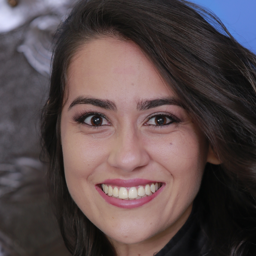

In [11]:
# Grabs the image paths from the dataset.
Image_Paths = [os.path.join(root_path, img) for img in os.listdir(root_path)]
Image_Paths 
Image.open(os.path.join(root_path, Image_Paths[50128]))

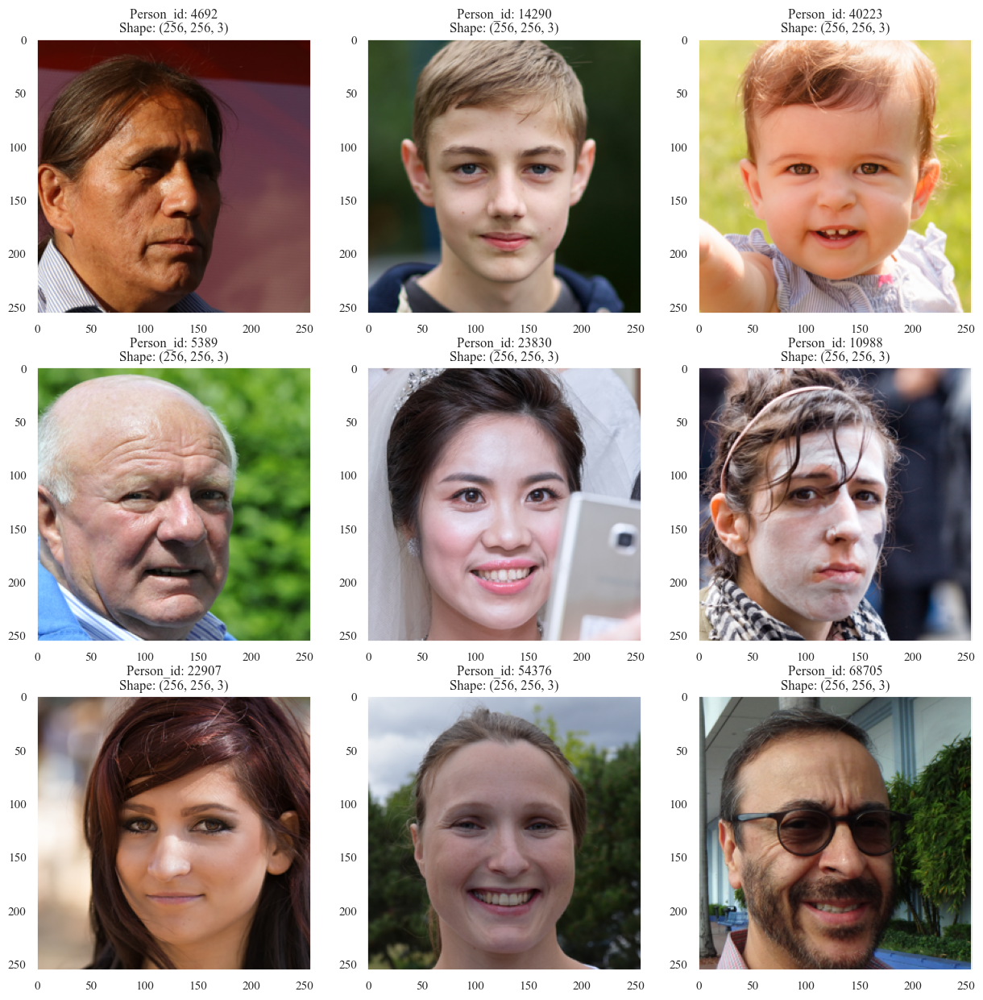

In [12]:
# Plots the Faces
fig = plot_random_persons(Image_Paths, sample = 9)

In [13]:
# Splits the data into the training and validation sets.
Directory = [path for path in os.listdir(root_path)]
rng = np.random.default_rng(seed)
indices = rng.permutation(len(Directory))
split_index = int(len(Directory) * 0.8)
train_indices = indices[:split_index]
val_indices = indices[split_index:]
train_indices.shape, val_indices.shape

((56000,), (14000,))

In [14]:
# Collects the Training and Validation Paths
Train_Paths = [Directory[index] for index in train_indices]
Val_Paths = [Directory[index] for index in val_indices]
Paths = Train_Paths.copy()
Paths.extend(Val_Paths)
np.shape(Train_Paths), np.shape(Val_Paths), np.shape(Paths)

((56000,), (14000,), (70000,))

In [15]:
# Generates the Training and Validation Datasets as well as their respective loaders.
print(PSNR_Ranges[-9][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 32


(16384, 4096)

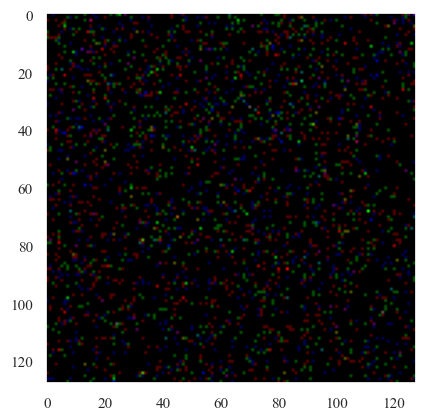

PSNR: -12.433809280395508
True PSNR: 3.038545844155673


In [16]:
# Grabs a sample image from the dataset and evaluates the PSNR.
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(42)
ImageNoise = ImageNoise.detach().cpu().numpy().transpose(1,2,0)
image_target = image_target.detach().cpu().numpy().transpose(1,2,0)
normalised_noisy_image = ImageNoise/ImageNoise.mean()
normalised_image_target = image_target/image_target.mean()
normalised_image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
normalised_noisy_image = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
true_psnr = psnr(normalised_image_target, normalised_noisy_image, data_range = normalised_image_target.max() - normalised_image_target.min())
plt.imshow(normalised_noisy_image)
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")
print(f"True PSNR: {true_psnr}")

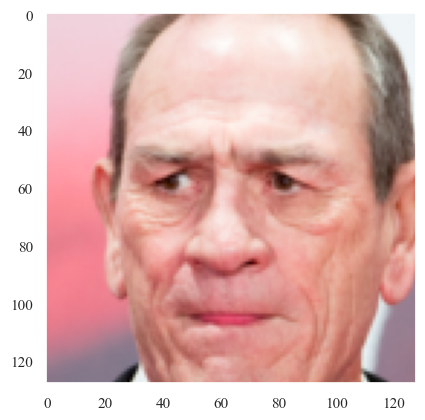

In [17]:
# Compares the original image with the noisy image.
plt.imshow(normalised_image_target)
plt.show()

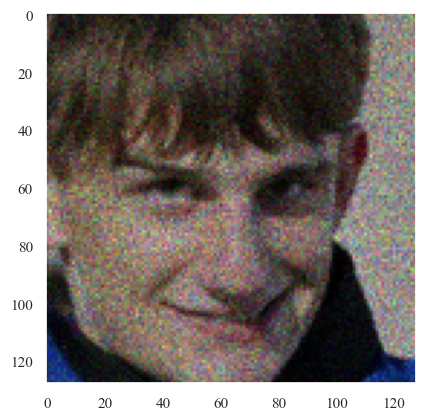

PSNR: 12.973918914794922
True PSNR: 14.419126430147635


In [18]:
# Grabs a sample image from the dataset and evaluates the PSNR.
ImageNoise_2, psnr_map_2, image_target_2 = Train_Dataset.__getitem__(42)
ImageNoise_2 = ImageNoise_2.detach().cpu().numpy().transpose(1,2,0)
image_target_2 = image_target_2.detach().cpu().numpy().transpose(1,2,0)
normalised_noisy_image_2 = ImageNoise/ImageNoise.mean()
normalised_image_target_2 = image_target/image_target.mean()
normalised_image_target_2 = (image_target_2 - image_target_2.min())/(image_target_2.max() - image_target_2.min())
normalised_noisy_image_2 = (ImageNoise_2 - ImageNoise_2.min())/(ImageNoise_2.max() - ImageNoise_2.min())
true_psnr_2 = psnr(normalised_image_target_2, normalised_noisy_image_2, data_range = normalised_image_target_2.max() - normalised_image_target_2.min())
plt.imshow(normalised_noisy_image_2)
plt.show()
print(f"PSNR: {psnr_map_2.min().detach().cpu().numpy()}")
print(f"True PSNR: {true_psnr_2}")

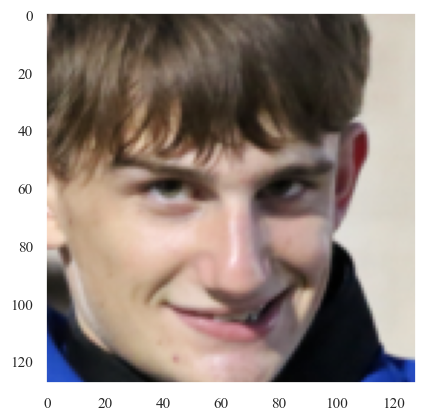

In [19]:
# Compares the original image with the noisy image.
plt.imshow(normalised_image_target_2)
plt.show()

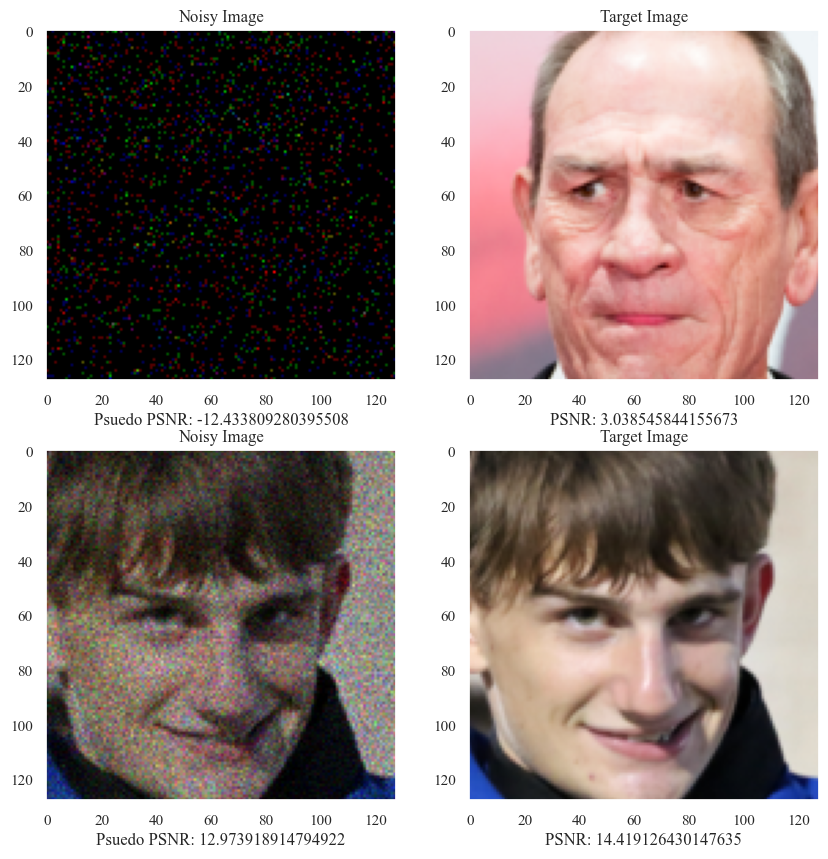

In [20]:
# Generates the model and loads the model.
figure, axes = plt.subplots(nrows = 2,ncols = 2, figsize = (10,10))
axes[0,0].imshow(normalised_noisy_image)
axes[0,0].set_title("Noisy Image")
axes[0,0].set_xlabel(f"Psuedo PSNR: {psnr_map.min().detach().cpu().numpy()}")
axes[0,1].imshow(normalised_image_target)
axes[0,1].set_title("Target Image")
axes[0,1].set_xlabel(f"PSNR: {true_psnr}")
axes[1,0].imshow(normalised_noisy_image_2)
axes[1,0].set_title("Noisy Image")
axes[1,0].set_xlabel(f"Psuedo PSNR: {psnr_map_2.min().detach().cpu().numpy()}")
axes[1,1].imshow(normalised_image_target_2)
axes[1,1].set_title("Target Image")
axes[1,1].set_xlabel(f"PSNR: {true_psnr_2}")
plt.show()

In [21]:
# Grabs the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
Noisy_Images_Paths = []
Psnr_Maps_Paths = []
Image_Targets_Paths = []
with open(r"Validation_File_PathNames\NoisyImageNames.txt", "r") as File:
    for line in File.readlines():
        Noisy_Images_Paths.append(line[:-1])
with open(r"Validation_File_PathNames\Psnr_MapNames.txt", "r") as File:
    for line in File.readlines():
        Psnr_Maps_Paths.append(line[:-1])
with open(r"Validation_File_PathNames\TargetImageNames.txt", "r") as File:
    for line in File.readlines():
        Image_Targets_Paths.append(line[:-1])
len(Noisy_Images_Paths), len(Psnr_Maps_Paths), len(Image_Targets_Paths)

(10, 10, 10)

In [22]:
# Generates dictionaries to store the Validation Noisy Images, PSNR Maps and Target Images.
Validation_Noisy_Images = {}
Validation_Psnr_Maps = {}
Validation_Target_Images = {}
val_Steps = 10
val_minpsnr = -40
val_maxpsnr = 40
val_Spacing = (val_maxpsnr - val_minpsnr) // val_Steps
val_psnr_ranges = [(i, j) for i, j in zip(range(val_minpsnr, val_maxpsnr, val_Spacing), range(val_minpsnr + val_Spacing, val_maxpsnr + val_Spacing, val_Spacing))]
print(len(val_psnr_ranges))
FaceValidators = [ValidationSetGenerator(root_dir= root_path, out_dir=out_dir, names = Paths, minPSNR= val_psnr_ranges[i][0], targetPSNR = val_psnr_ranges[i][1], augment= True, sample_size = 100, grayscale= GREYSCALE, amplification_factor= 1e2) for i in range(len(val_psnr_ranges))]
FaceValidators[0].out_dir
print(val_psnr_ranges)
for index in range(len(val_psnr_ranges)):
    psnr_label = str(val_psnr_ranges[index][0]) + str(val_psnr_ranges[index][1])
    print(f"Loading Validation Data for {index} Val_Dataset at psnr range {psnr_label}")
    FaceValidator = FaceValidators[index]
    File_Path_NI = Noisy_Images_Paths[index]
    File_Path_PSM = Psnr_Maps_Paths[index]
    File_Path_TI = Image_Targets_Paths[index]
    Noisy_Images, Psnr_Maps, Target_Images = FaceValidator.Load_Noisy_Faces(File_Path_NI, File_Path_PSM, File_Path_TI, device=device)
    Validation_Noisy_Images[psnr_label] = Noisy_Images
    Validation_Psnr_Maps[psnr_label] = Psnr_Maps
    Validation_Target_Images[psnr_label] = Target_Images
len(Validation_Noisy_Images), len(Validation_Psnr_Maps), len(Validation_Target_Images)

10
[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32), (32, 40)]
Loading Validation Data for 0 Val_Dataset at psnr range -40-32
Loading Validation Data for 1 Val_Dataset at psnr range -32-24
Loading Validation Data for 2 Val_Dataset at psnr range -24-16
Loading Validation Data for 3 Val_Dataset at psnr range -16-8
Loading Validation Data for 4 Val_Dataset at psnr range -80
Loading Validation Data for 5 Val_Dataset at psnr range 08
Loading Validation Data for 6 Val_Dataset at psnr range 816
Loading Validation Data for 7 Val_Dataset at psnr range 1624
Loading Validation Data for 8 Val_Dataset at psnr range 2432
Loading Validation Data for 9 Val_Dataset at psnr range 3240


(10, 10, 10)

In [23]:
Validation_Noisy_Images.keys()

dict_keys(['-40-32', '-32-24', '-24-16', '-16-8', '-80', '08', '816', '1624', '2432', '3240'])

In [24]:
# Generates a sample image from the Validation Noisy Images across different noise levels
# and evaluates the visualisation of the image.
ValidationNoisyTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationPsnrTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationTargetTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
for index, key in enumerate(Validation_Noisy_Images.keys()):
    ValidationNoisyTest_Batch[index] = Validation_Noisy_Images[key][-10]
    ValidationPsnrTest_Batch[index] = Validation_Psnr_Maps[key][-10].view(1, 3, 128, 128)
    ValidationTargetTest_Batch[index] = Validation_Target_Images[key][-10]
ValidationNoisyTest_Batch.shape, ValidationPsnrTest_Batch.shape, ValidationTargetTest_Batch.shape

(torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]))

In [25]:
# Moves the validation data to the gpu
ValidationNoisyTest_Batch = ValidationNoisyTest_Batch.to(device)
ValidationPsnrTest_Batch = ValidationPsnrTest_Batch.to(device)
ValidationTargetTest_Batch = ValidationTargetTest_Batch.to(device)

In [ ]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [32]:
# Creates the directory to save the model in.
name = "FaceGenerationUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/" 

In [33]:
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


2.4679296 0.0 2.458251476287842 0.8903902769088745
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 17.583152770996094
18.004363313772235 25.543781375231273 inf


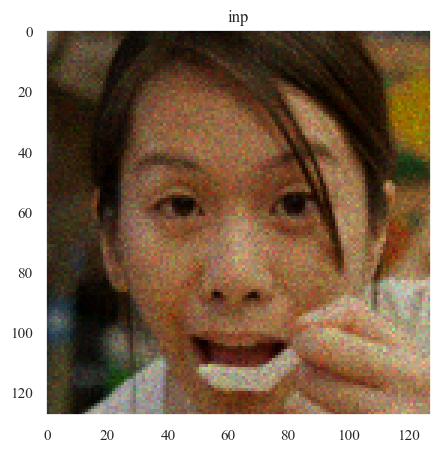

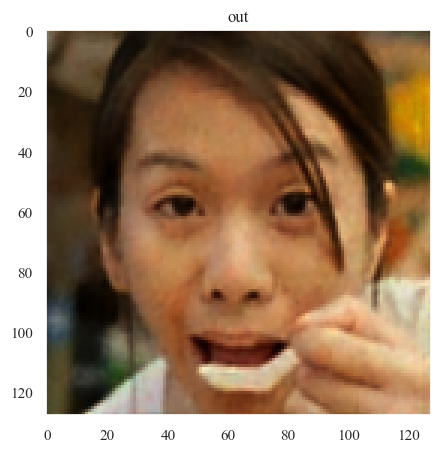

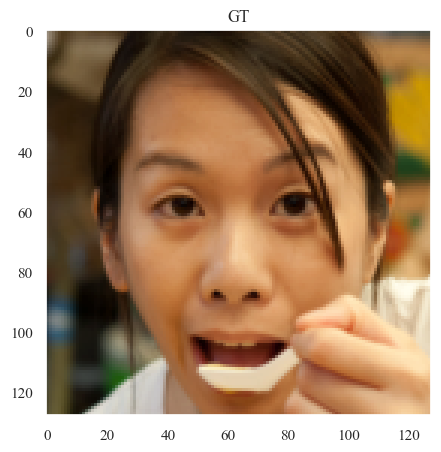

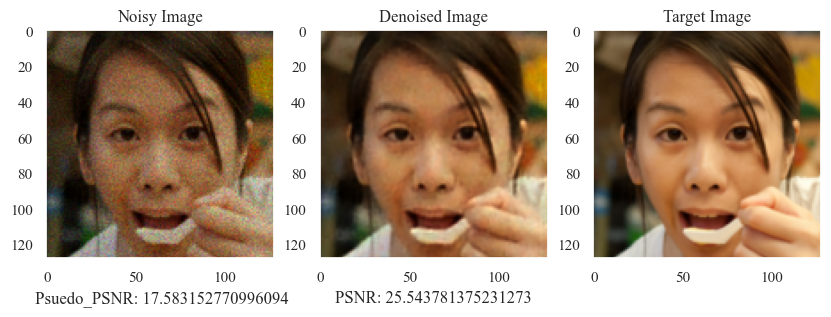

In [126]:
# Generates a smaple image from the dataset, denoises it and evaluates the visual quality of the denoised image
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")


ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

Psnr = psnr(ImageNoise.permute(1,2,0).detach().cpu().numpy(), image_target.permute(1,2,0).detach().cpu().numpy(), data_range = image_target.max().item() - image_target.min().item())

Psnr_out = psnr(out.permute(1,2,0).detach().cpu().numpy(), image_target.permute(1,2,0).detach().cpu().numpy(), data_range = image_target.max().item() - image_target.min().item())

Pnsr_Target = psnr(image_target.permute(1,2,0).detach().cpu().numpy(), image_target.permute(1,2,0).detach().cpu().numpy(), data_range = image_target.max().item() - image_target.min().item())

print(Psnr, Psnr_out, Pnsr_Target)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

figure, axes = plt.subplots(nrows = 1,ncols = 3, figsize = (10,10))
axes[0].imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy())
axes[0].set_title("Noisy Image")
axes[0].set_xlabel(f" Psuedo_PSNR: {Psnr_map.min().detach().cpu().numpy()}")
axes[1].imshow(out.permute(1,2,0).detach().cpu().numpy())
axes[1].set_title("Denoised Image")
axes[1].set_xlabel(f"PSNR: {Psnr_out}")
axes[2].imshow(image_target.permute(1,2,0).detach().cpu().numpy())
axes[2].set_title("Target Image")
plt.show()

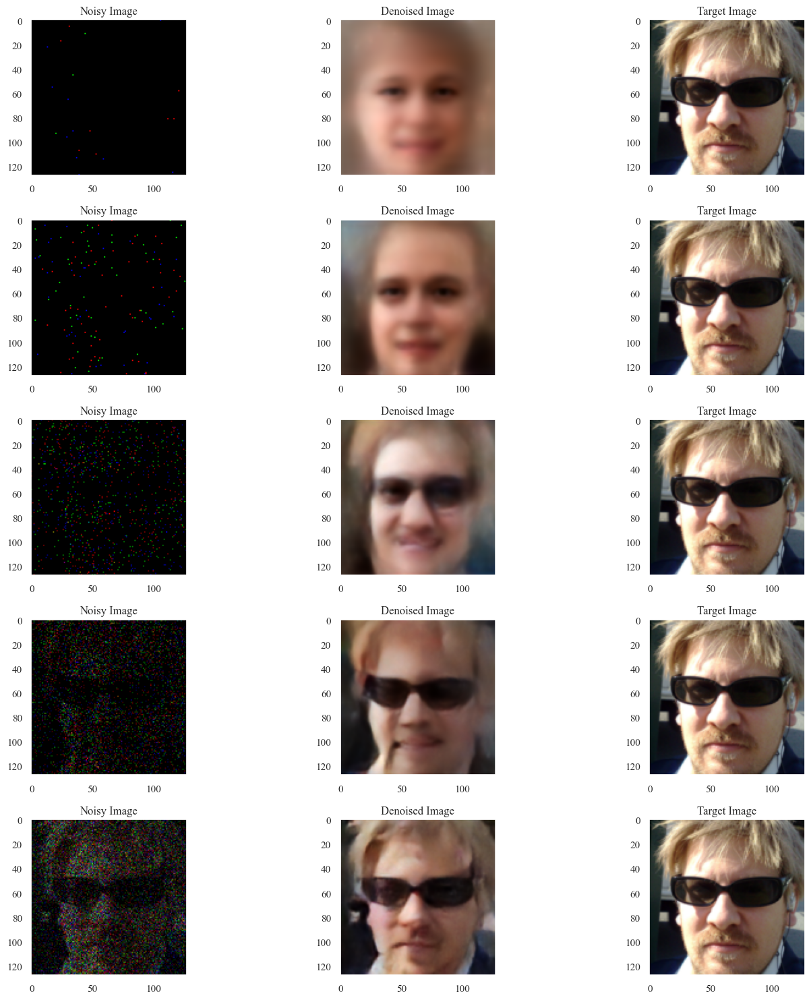

In [108]:
# Generates a smaple image from the dataset, denoises it and evaluates the visual quality of the denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

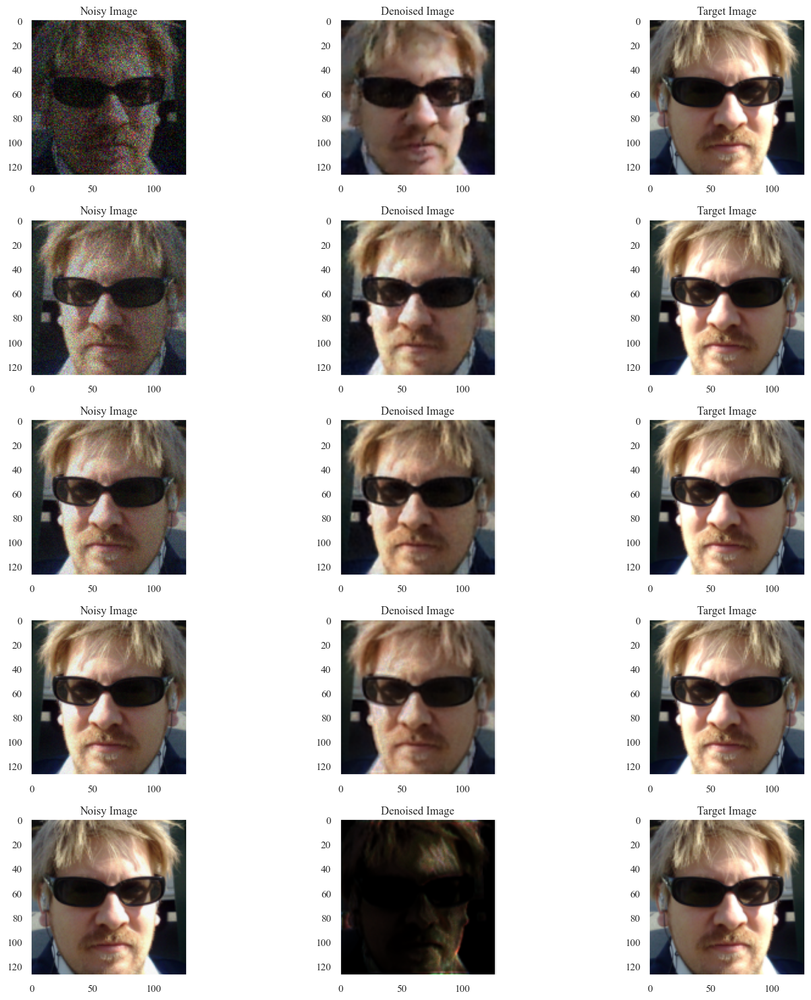

In [109]:
# continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

torch.Size([1, 3, 128, 128])
-33.6932189928148
-32.443831330892166
-30.480885081161325
-28.22309451896559
-26.270831905065673
-24.290901042849697
-22.23193863603242
-20.093960900872734
-18.067458214265123
-15.873956226059772
-13.874817014748299
-11.742133117210257
-9.666102698353482
-7.548264112718208
-5.4532007491603105
-3.3524756323123626
-1.2195661515999665
0.8907850649657698
2.9999941832440453
5.113393034966721
7.221725716047747
9.354721834552128
11.480920752877463
13.59576221542439
15.713366383985468
17.83120376086433
19.945903503716107
22.063618339747777
24.183342723478898
26.30359087346846
28.42163491404035
30.541091249051743


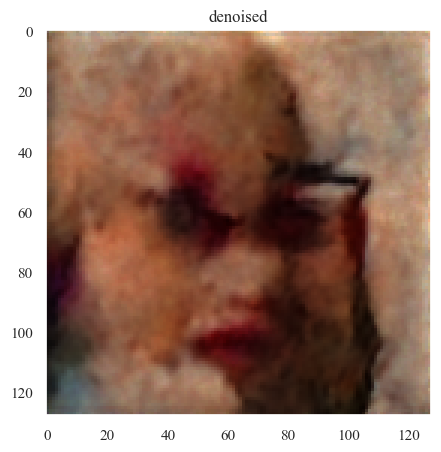

_______________________________________ 317
time (s): 96.06261706352234 time per image (s) 96.06261706352234


<Figure size 640x480 with 0 Axes>

In [22]:
# Generates an unseen image from the dataset, denoises it and evaluates the visual quality of the denoised image
ImageNoise, Psnr_map, image_target = ValidationNoisyTest_Batch[0], ValidationPsnrTest_Batch[0], ValidationTargetTest_Batch[0]
model = model.to(device)
model.eval()
inp_img = ImageNoise.unsqueeze(0).to(device)
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
vmax = np.percentile(image_target.detach().cpu().numpy(), 99.9)

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 3
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 128
pixels_y = 128

#inp_img =  ImageNoise.unsqueeze(0).to(device)
print(inp_img.shape)
model = model.to(device)

for i in range(1):
    
    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image_3(inp_img,
                                                        model.to(device), 
                                                        max_its=1000,
                                                        beta = 0.10,
                                                        save_every_n = 30,
                                                        max_psnr = PSNR_Ranges[-1][1])
denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
plt.figure(figsize=(5,5))
plt.imshow(denoised[0].transpose(1,2,0),vmin = 0, vmax = vmax)
plt.title('denoised')
plt.show()
plt.clf()
print('_______________________________________', iterations)
endTime = time.time()
elapsedTime = endTime - startTime
print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

In [155]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_1 = np.array(Psnr_Distribution)
SSIM_Distribution_1 = np.array(SSIM_Distribution)
Perceptual_Distribution_1 = np.array(Perceptual_Distribution)
Psnr_Distribution_1.shape, SSIM_Distribution_1.shape, Perceptual_Distribution_1.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [123]:
# Generates the dataframe for the Psnr
Psnr_Distribution_1 = pd.DataFrame(Psnr_Distribution_1, columns = ["PSNR"])
Psnr_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_1.shape[0])
Psnr_Distribution_1["PSNR_Average"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_1["PSNR_Variance"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Upper"] = Psnr_Distribution_1["PSNR_Average"] + Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Lower"] = Psnr_Distribution_1["PSNR_Average"] - Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1.dropna(inplace = True)
Psnr_Distribution_1.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,22.946108,-3.559511,22.851904,1.419083,24.270986,21.432821
std,6.524294,20.564969,6.396547,0.340836,6.361009,6.449925
min,9.534812,-39.119021,13.076077,0.703284,14.475742,11.329538
25%,16.927605,-21.339266,16.770744,1.188115,18.092826,15.316895
50%,22.823743,-3.559511,22.721654,1.358948,24.025030,21.420345
75%,29.226769,14.220245,29.881936,1.612756,31.285603,28.237103
max,35.376661,32.000000,31.961869,2.553532,33.917736,30.955282


In [124]:
# Generates the dataframe for the SSIM
SSIM_Distribution_1 = pd.DataFrame(SSIM_Distribution_1, columns = ["SSIM"])
SSIM_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_1.shape[0])
SSIM_Distribution_1["SSIM_Average"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_1["SSIM_Variance"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Upper"] = SSIM_Distribution_1["SSIM_Average"] + SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Lower"] = SSIM_Distribution_1["SSIM_Average"] - SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1.dropna(inplace = True)
SSIM_Distribution_1.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.673632,-3.559511,0.670108,0.050748,0.720856,0.619359
std,0.217673,20.564969,0.211923,0.020682,0.194796,0.229635
min,0.185041,-39.119021,0.332490,0.009061,0.396513,0.252586
25%,0.477732,-21.339266,0.456092,0.034303,0.514691,0.390345
50%,0.705189,-3.559511,0.694195,0.052941,0.749749,0.638867
75%,0.886519,14.220245,0.885591,0.066979,0.920308,0.835858
max,0.971518,32.000000,0.950868,0.107478,0.990535,0.934394


In [125]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_1 = pd.DataFrame(Perceptual_Distribution_1, columns = ["1-PL"])
Perceptual_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_1.shape[0])
Perceptual_Distribution_1["1-PL_Average"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_1["1-PL_Variance"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Upper"] = Perceptual_Distribution_1["1-PL_Average"] + Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Lower"] = Perceptual_Distribution_1["1-PL_Average"] - Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1.dropna(inplace = True)
Perceptual_Distribution_1.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.465052,-3.119021,0.461664,0.055355,0.471579,0.451749
std,0.299528,20.310653,0.294188,0.028444,0.298115,0.290840
min,-0.052407,-38.238042,0.098707,0.010989,0.101214,0.093494
25%,0.132980,-20.678532,0.124758,0.033289,0.127995,0.120599
50%,0.619635,-3.119021,0.667601,0.053993,0.686700,0.654774
75%,0.735786,14.440489,0.716669,0.072825,0.727453,0.707677
max,0.914533,32.000000,0.824970,0.242917,0.836123,0.814135


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

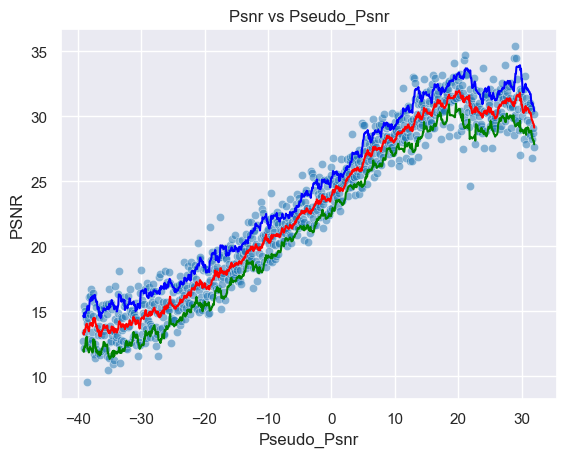

In [126]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_1 = np.trapz(Psnr_Distribution_1["PSNR_Average"].values, Psnr_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

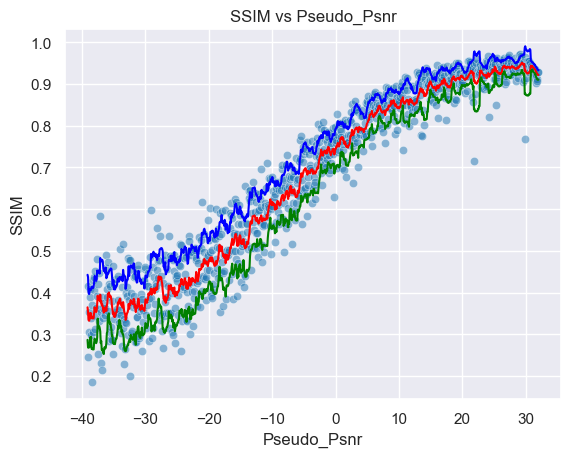

In [127]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.scatterplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_1 = np.trapz(SSIM_Distribution_1["SSIM_Average"].values, SSIM_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

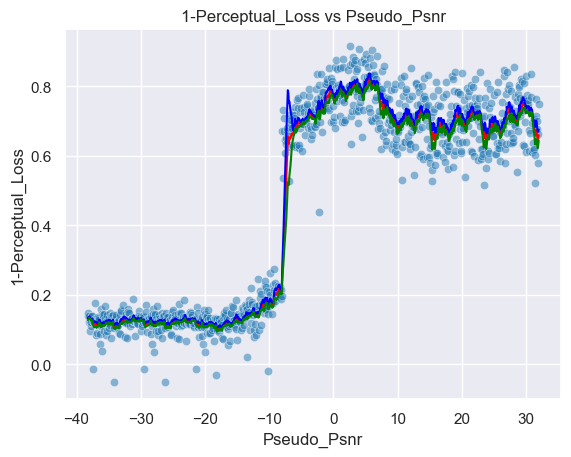

In [128]:
# Generates the plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_1 = np.trapz(Perceptual_Distribution_1["1-PL_Average"].values, Perceptual_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [129]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_1), print(SSIM_Area_1), print(Perceptual_Area_1)

1625.3343218156792
47.65957568391943
32.43177531425892


(None, None, None)

In [130]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_1["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_1["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_1["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_1["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_1["PSNR_Variance"].mean())

Mean Psnr 22.946107974973163
Std Psnr 6.524294312550647
Min Psnr 9.534811680980802
Max Psnr 35.37666074161767
Mean Roll Var 1.4190828863838074


In [131]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_1["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_1["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_1["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_1["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_1["SSIM_Variance"].mean())

Mean SSIM 0.6736319
Std SSIM 0.21767307817935944
Min SSIM 0.18504057824611664
Max SSIM 0.9715179800987244
Mean Roll SSIM 0.05074841963372095


In [132]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_1["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_1["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_1["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_1["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_1["1-PL_Variance"].mean())

Mean 1-PL 0.4650525
Std 1-PL 0.29952818155288696
Min 1-PL -0.05240678787231445
Max 1-PL 0.914533257484436
Mean Roll 1-PL 0.0553552430007652


In [133]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Highest PSNR Range
print(PSNR_Ranges[-1][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-1][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-1][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

24 32


(16384, 4096)

In [23]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [25]:
# Trains the model using the Pytorch Lightning Trainer for the Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [25]:
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\call.py:54: Detected KeyboardInterrupt, attempting graceful shutdown...


In [156]:
name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/" 

In [157]:
# Loads the model from the checkpoint for the Second Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [27]:
# Validates the trained model on the Training Data for the Second Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1706543117761612    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1706543117761612}]

In [28]:
# Validates the trained model on the Validation Set for the Second Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17073354125022888    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17073354125022888}]

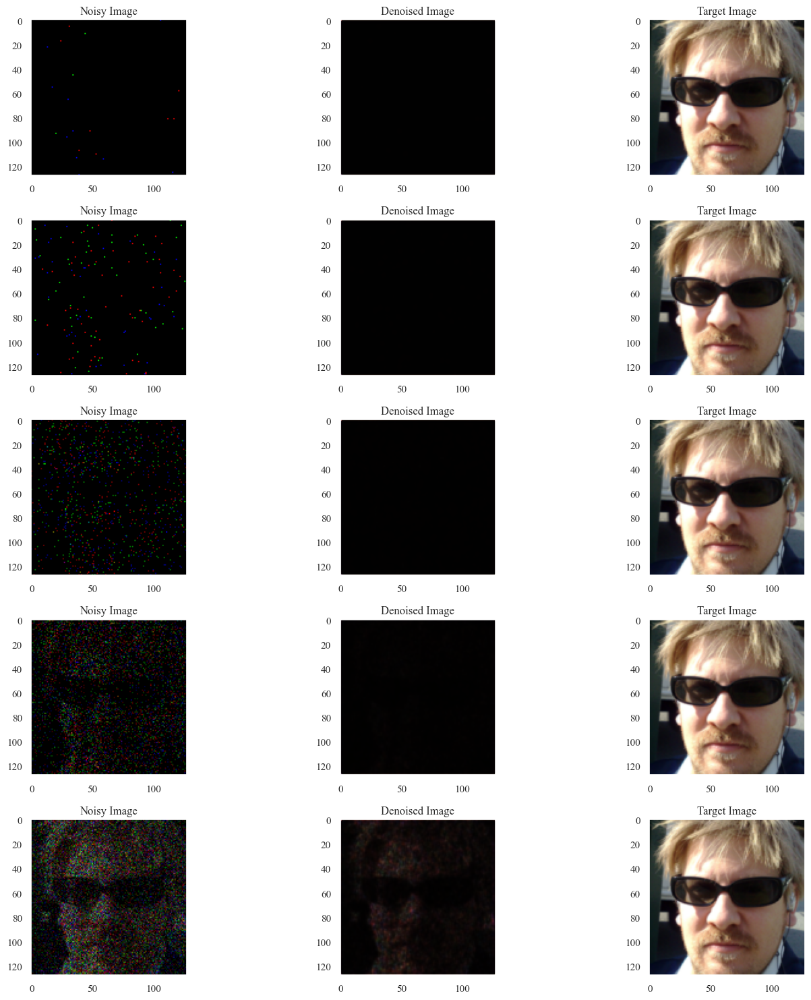

In [29]:
# Generates the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

1.8706633 0.07893094 1.8311978578567505 1.0418883562088013
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 24.642314910888672
24.642454558616635 24.64245501369784 0.0


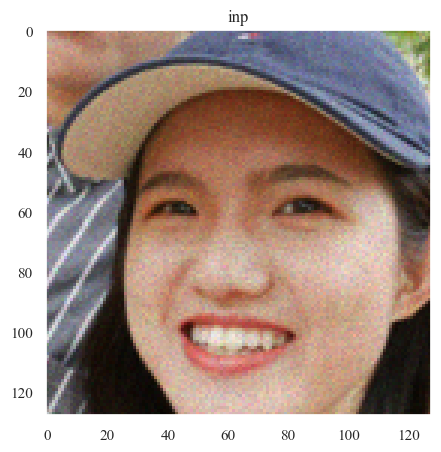

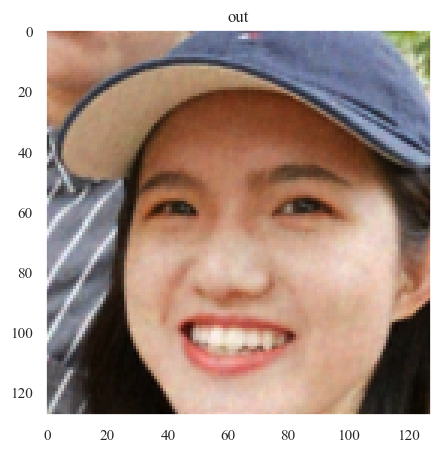

Text(0.5, 1.0, 'GT')

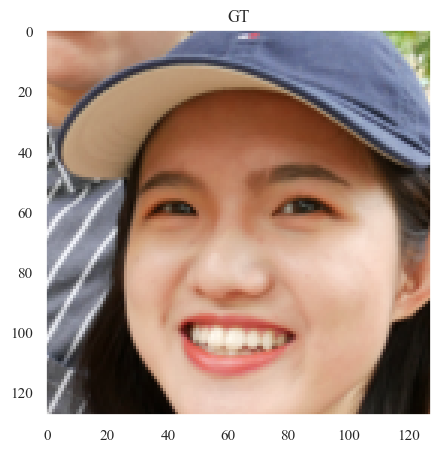

In [30]:
# # Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

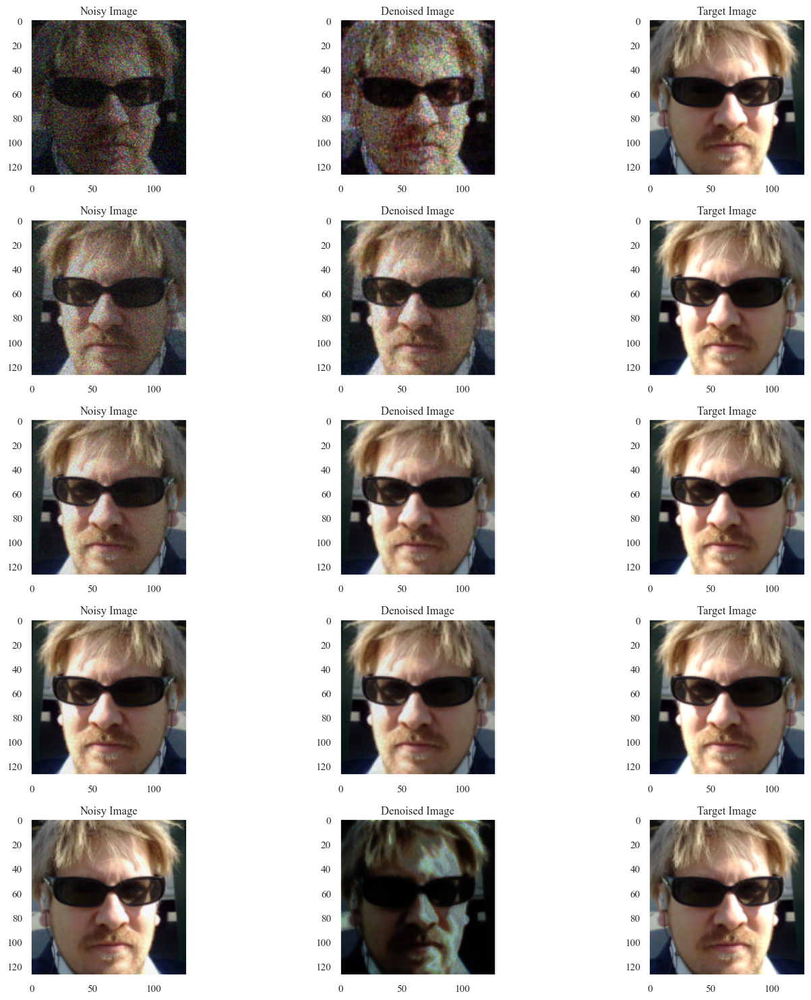

In [31]:
# Plots for a sample image the Noisy Image, its corresponding denoised image 
# and the target image for the Highest PSNR Range.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [158]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_2 = np.array(Psnr_Distribution)
SSIM_Distribution_2 = np.array(SSIM_Distribution)
Perceptual_Distribution_2 = np.array(Perceptual_Distribution)
Psnr_Distribution_2.shape, SSIM_Distribution_2.shape, Perceptual_Distribution_2.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [137]:
# Generates the dataframe for the Psnr
Psnr_Distribution_2 = pd.DataFrame(Psnr_Distribution_2, columns = ["PSNR"])
Psnr_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_2.shape[0])
Psnr_Distribution_2["PSNR_Average"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_2["PSNR_Variance"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Upper"] = Psnr_Distribution_2["PSNR_Average"] + Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Lower"] = Psnr_Distribution_2["PSNR_Average"] - Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2.dropna(inplace = True)
Psnr_Distribution_2.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,15.309023,-3.559511,15.098508,1.573481,16.671988,13.525027
std,12.847046,20.564969,12.654149,0.406509,12.713951,12.607177
min,0.072885,-39.119021,3.268055,0.711929,4.463653,1.761109
25%,4.370616,-21.339266,4.312837,1.282565,5.877285,2.895324
50%,8.679818,-3.559511,8.129908,1.504145,9.923594,6.464473
75%,27.280841,14.220245,26.591410,1.907295,28.413225,24.495030
max,42.707022,32.000000,40.028957,2.734805,41.830967,38.226946


In [138]:
# Generates the dataframe for the SSIM
SSIM_Distribution_2 = pd.DataFrame(SSIM_Distribution_2, columns = ["SSIM"])
SSIM_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_2.shape[0])
SSIM_Distribution_2["SSIM_Average"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_2["SSIM_Variance"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Upper"] = SSIM_Distribution_2["SSIM_Average"] + SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Lower"] = SSIM_Distribution_2["SSIM_Average"] - SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2.dropna(inplace = True)
SSIM_Distribution_2.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.479050,-3.559511,0.474578,0.064175,0.538753,0.410403
std,0.279164,20.564969,0.268369,0.030869,0.260634,0.279320
min,0.125353,-39.119021,0.230535,0.003099,0.262149,0.154741
25%,0.252990,-21.339266,0.264450,0.042993,0.326354,0.208523
50%,0.349298,-3.559511,0.312054,0.063226,0.382616,0.252285
75%,0.752588,14.220245,0.724634,0.086358,0.822098,0.642929
max,0.990214,32.000000,0.984580,0.151812,0.993716,0.981374


In [139]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_2 = pd.DataFrame(Perceptual_Distribution_2, columns = ["1-PL"])
Perceptual_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_2.shape[0])
Perceptual_Distribution_2["1-PL_Average"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_2["1-PL_Variance"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Upper"] = Perceptual_Distribution_2["1-PL_Average"] + Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Lower"] = Perceptual_Distribution_2["1-PL_Average"] - Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2.dropna(inplace = True)
Perceptual_Distribution_2.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.380334,-3.119021,0.376671,0.059863,0.386228,0.367114
std,0.234896,20.310653,0.224821,0.032495,0.228676,0.221134
min,-0.051564,-38.238042,0.104692,0.011073,0.106856,0.100934
25%,0.147896,-20.678532,0.135559,0.027887,0.139594,0.131706
50%,0.354267,-3.119021,0.385508,0.054765,0.391524,0.379276
75%,0.592686,14.440489,0.608242,0.085103,0.619489,0.589513
max,0.872927,32.000000,0.765393,0.146431,0.781813,0.754410


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

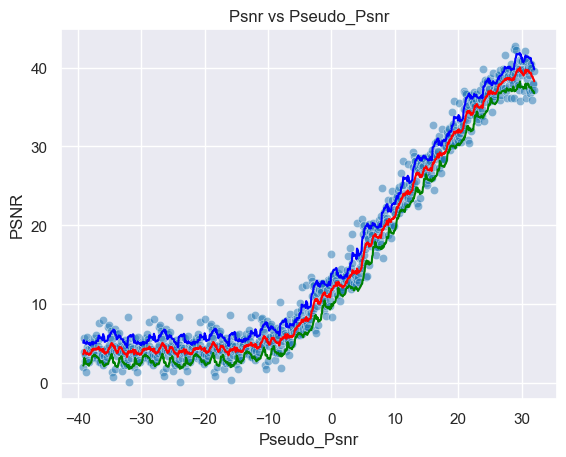

In [140]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_2 = np.trapz(Psnr_Distribution_2["PSNR_Average"].values, Psnr_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

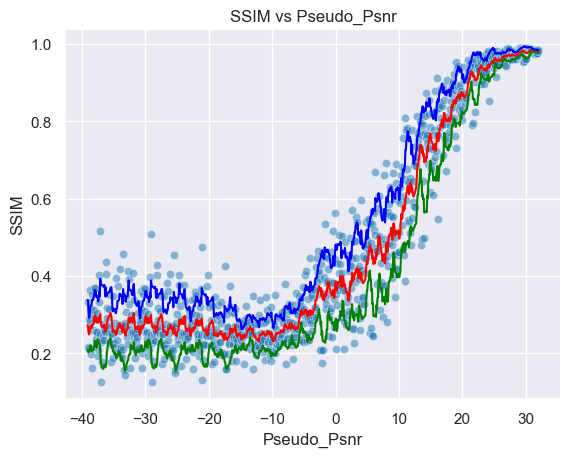

In [141]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_2 = np.trapz(SSIM_Distribution_2["SSIM_Average"].values, SSIM_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

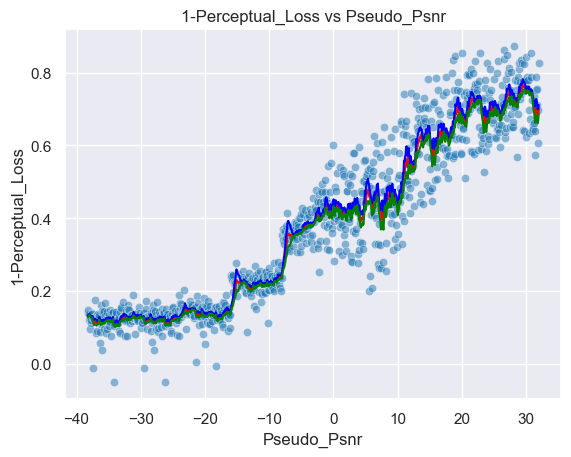

In [142]:
# Plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_2 = np.trapz(Perceptual_Distribution_2["1-PL_Average"].values, Perceptual_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [143]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_2), print(SSIM_Area_2), print(Perceptual_Area_2)

1073.3225725066152
33.73936939057174
26.453612165403314


(None, None, None)

In [144]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_2["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_2["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_2["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_2["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_2["PSNR_Variance"].mean())

Mean Psnr 15.309023177870603
Std Psnr 12.847045676927152
Min Psnr 0.0728851471473138
Max Psnr 42.70702244849568
Mean Roll Var 1.5734805180190787


In [145]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_2["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_2["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_2["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_2["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_2["SSIM_Variance"].mean())

Mean SSIM 0.4790502
Std SSIM 0.2791635990142822
Min SSIM 0.12535303831100464
Max SSIM 0.9902143478393555
Mean Roll SSIM 0.06417542498013469


In [146]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_2["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_2["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_2["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_2["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_2["1-PL_Variance"].mean())

Mean 1-PL 0.38033426
Std 1-PL 0.2348962128162384
Min 1-PL -0.05156397819519043
Max 1-PL 0.8729273080825806
Mean Roll 1-PL 0.059862767122001


In [147]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Second Highest PSNR Range
print(PSNR_Ranges[-2][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-2][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-2][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

16 32


(16384, 4096)

In [15]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [148]:
# Trains the model using the Pytorch Lightning Trainer for the Second Highest PSNR Range.
name = "FaceGenerationUNet128x128-16-32"
CHECKPOINT_PATH = "./models/" 

In [30]:
# Trains the model using the Pytorch Lightning Trainer for the Second Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [31]:
# Tests the model on the Training Data for the Second Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1690238118171692    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1690238118171692}]

In [32]:
# Tests the model on the Validation Data for the Second Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.168021097779274     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.168021097779274}]

In [149]:
# Generates the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


2.131276 0.008663723 2.0606579689979725 0.9443458914756775
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 29.831119537353516
29.83101798987167 29.83101798987167 0.0


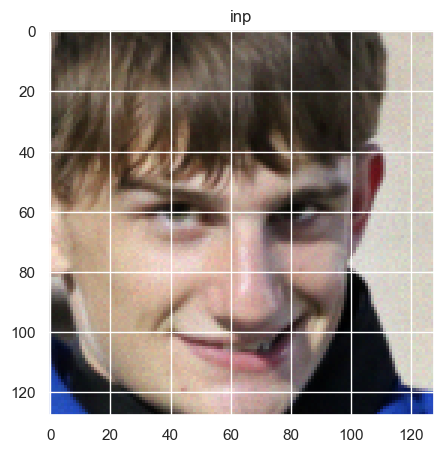

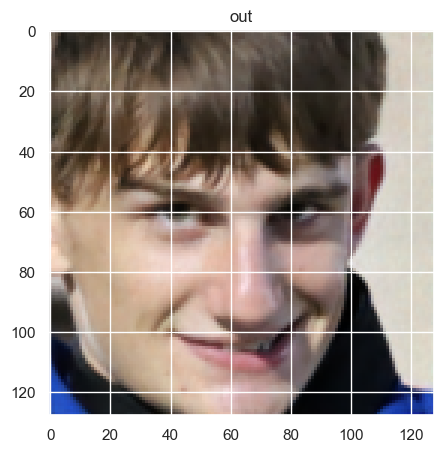

Text(0.5, 1.0, 'GT')

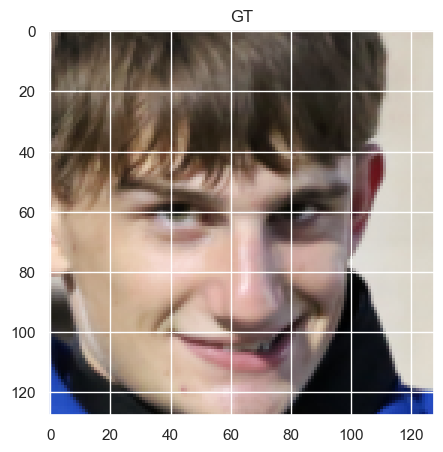

In [57]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

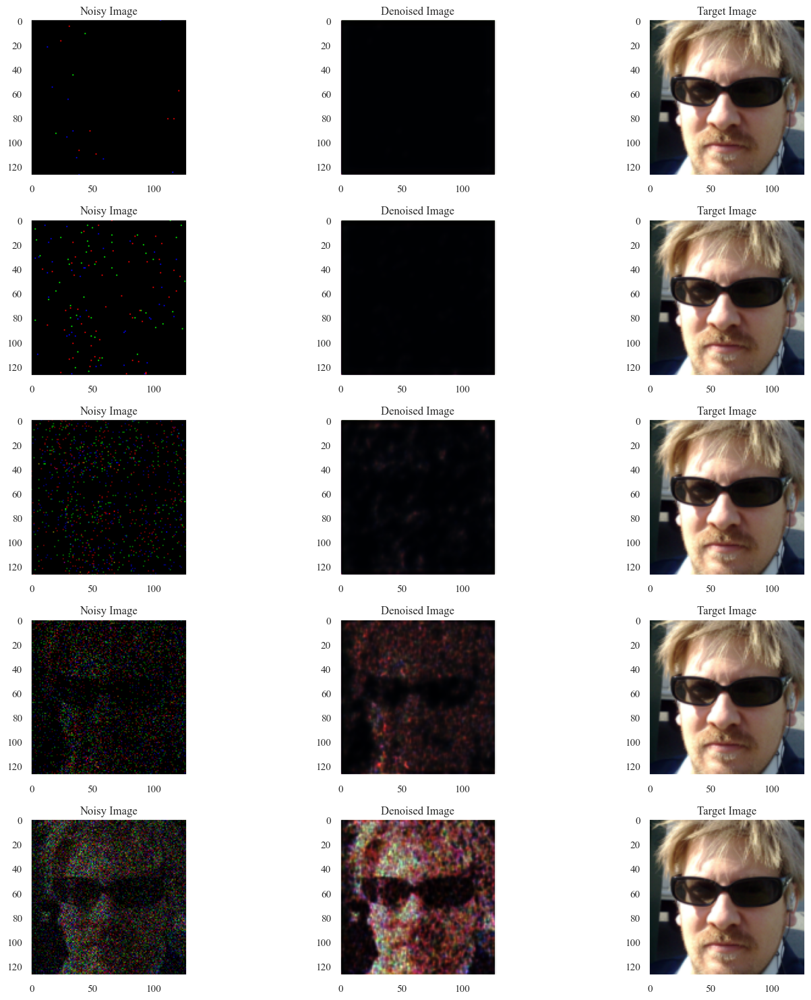

In [35]:
# Plots for a sample image the Noisy Image, its corresponding denoised image across the psnr range
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

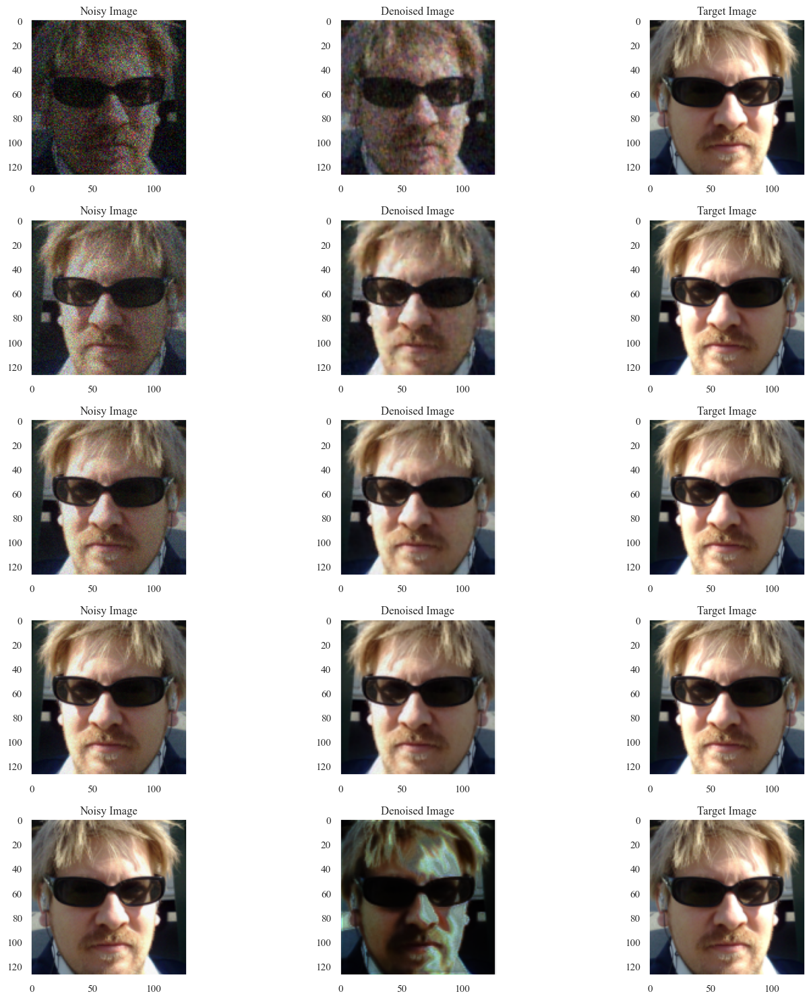

In [36]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [150]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_3 = np.array(Psnr_Distribution)
SSIM_Distribution_3 = np.array(SSIM_Distribution)
Perceptual_Distribution_3 = np.array(Perceptual_Distribution)
Psnr_Distribution_3.shape, SSIM_Distribution_3.shape, Perceptual_Distribution_3.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,17.476732,-3.559511,17.253827,1.544828,18.798655,15.708999
std,13.170010,20.564969,13.020906,0.398194,13.013678,13.040294
min,-0.977322,-39.119021,2.083342,0.583940,3.283610,0.618535
25%,4.897682,-21.339266,4.351027,1.247150,5.712328,2.879533
50%,13.029345,-3.559511,12.231061,1.502917,14.179599,10.535208
75%,30.725619,14.220245,30.260580,1.846320,31.954475,28.298196
max,43.086295,32.000000,40.229468,2.736193,42.081296,38.516946


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.467976,-3.559511,0.462962,0.053422,0.516384,0.409540
std,0.336271,20.564969,0.329144,0.033184,0.323808,0.337671
min,0.074541,-39.119021,0.126401,0.003210,0.152122,0.091073
25%,0.164923,-21.339266,0.170480,0.029314,0.212212,0.125814
50%,0.312775,-3.559511,0.290272,0.044118,0.389895,0.197337
75%,0.874713,14.220245,0.854931,0.075831,0.915879,0.791138
max,0.990892,32.000000,0.985264,0.160912,0.992776,0.981919


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.406033,-3.119021,0.402340,0.060239,0.411845,0.392835
std,0.242749,20.310653,0.233598,0.029968,0.237149,0.230151
min,-0.052538,-38.238042,0.104623,0.011230,0.106789,0.100869
25%,0.151161,-20.678532,0.133230,0.030459,0.136983,0.130436
50%,0.356848,-3.119021,0.378746,0.059333,0.393500,0.366717
75%,0.632842,14.440489,0.663075,0.084760,0.674252,0.648743
max,0.874345,32.000000,0.768317,0.130162,0.784521,0.757397


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

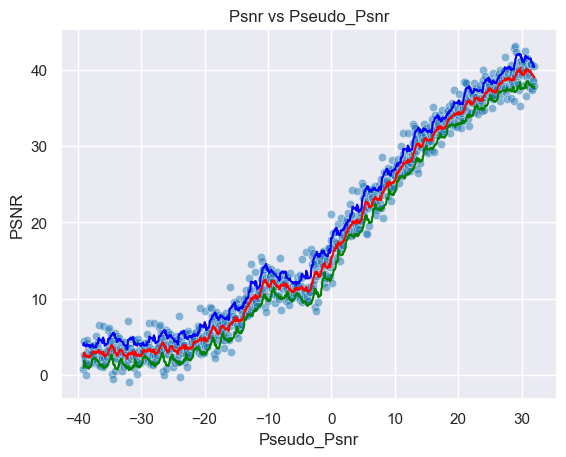

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

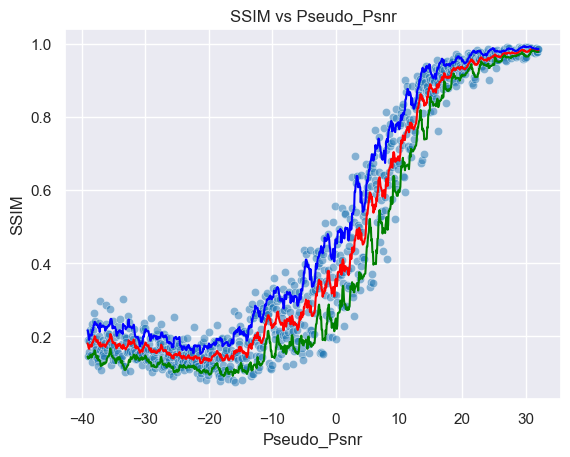

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

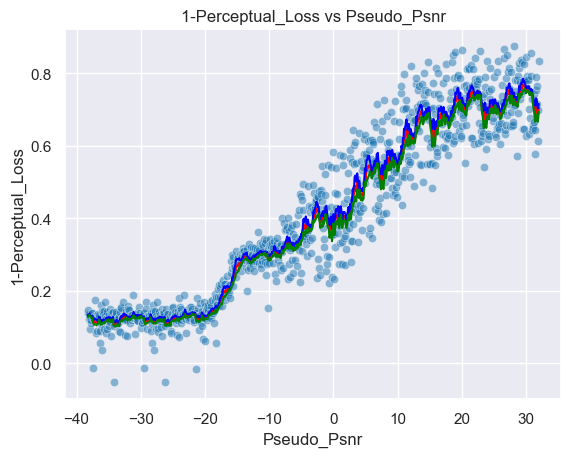

Psnr Area: 1226.8014669584213, SSIM Area: 32.9159662862442, Perceptual Area: 28.258403923474376
Mean Psnr 17.476731994864274
Std Psnr 13.17001035966289
Min Psnr -0.9773218639003984
Max Psnr 43.08629528054826
Mean Roll Var 1.5448278887806828
Mean SSIM 0.4679763
Std SSIM 0.336270809173584
Min SSIM 0.07454143464565277
Max SSIM 0.9908919334411621
Mean Roll SSIM 0.05342205873301846
Mean 1-PL 0.40603325
Std 1-PL 0.24274924397468567
Min 1-PL -0.05253767967224121
Max 1-PL 0.8743445873260498
Mean Roll 1-PL 0.06023933452061115


(1226.8014669584213, 32.9159662862442, 28.258403923474376)

In [59]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Second Highest PSNR Range.
Plot_Creater(Psnr_Distribution_3, SSIM_Distribution_3, Perceptual_Distribution_3, minpsnr, maxpsnr)

In [60]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Third Highest PSNR Range
print(PSNR_Ranges[-3][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-3][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-3][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

8 32


(16384, 4096)

In [61]:
# Creates the directory to save the model in for the Third Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-8-32"
CHECKPOINT_PATH = "./models/" 

In [30]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores


INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [31]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [62]:
# Loads the model from the checkpoint for the Third Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [33]:
# Validates the trained model on the Train Set for the Third Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16800330579280853    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16800330579280853}]

In [34]:
# Validates the trained model on the Validation Set for the Third Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17225416004657745    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17225416004657745}]

1.8662884 0.0 1.8587325811386108 1.0729268789291382
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 31.52573013305664
31.525616561905878 31.525616561905878 0.0


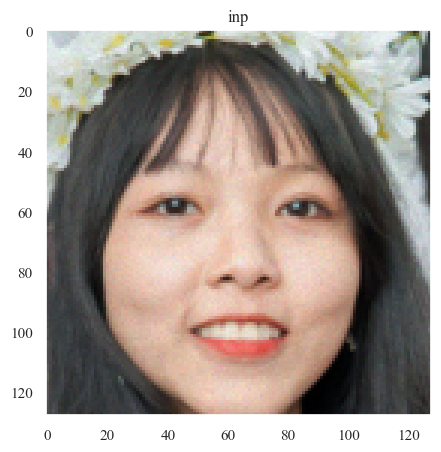

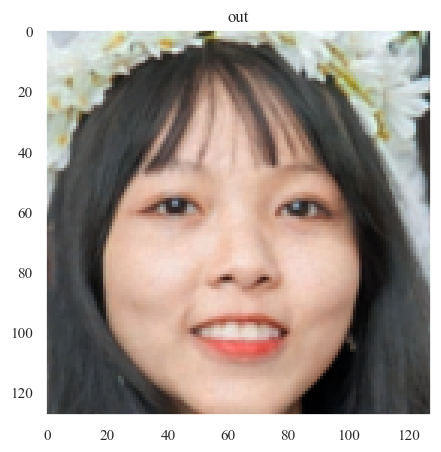

Text(0.5, 1.0, 'GT')

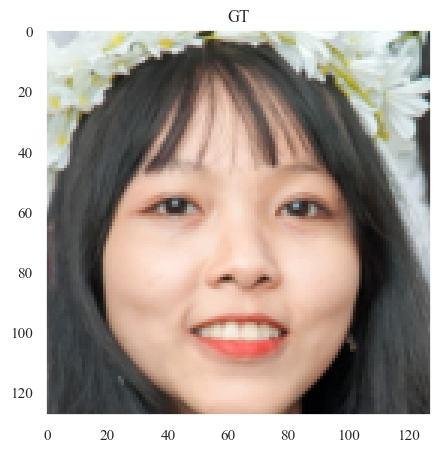

In [35]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

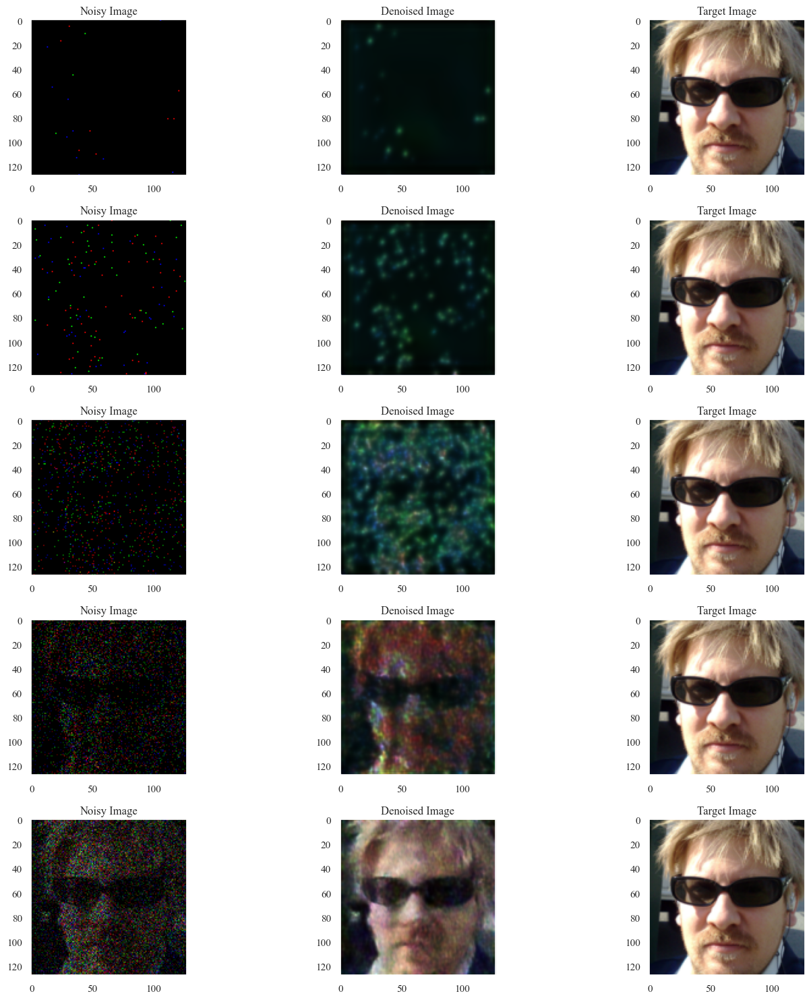

In [36]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

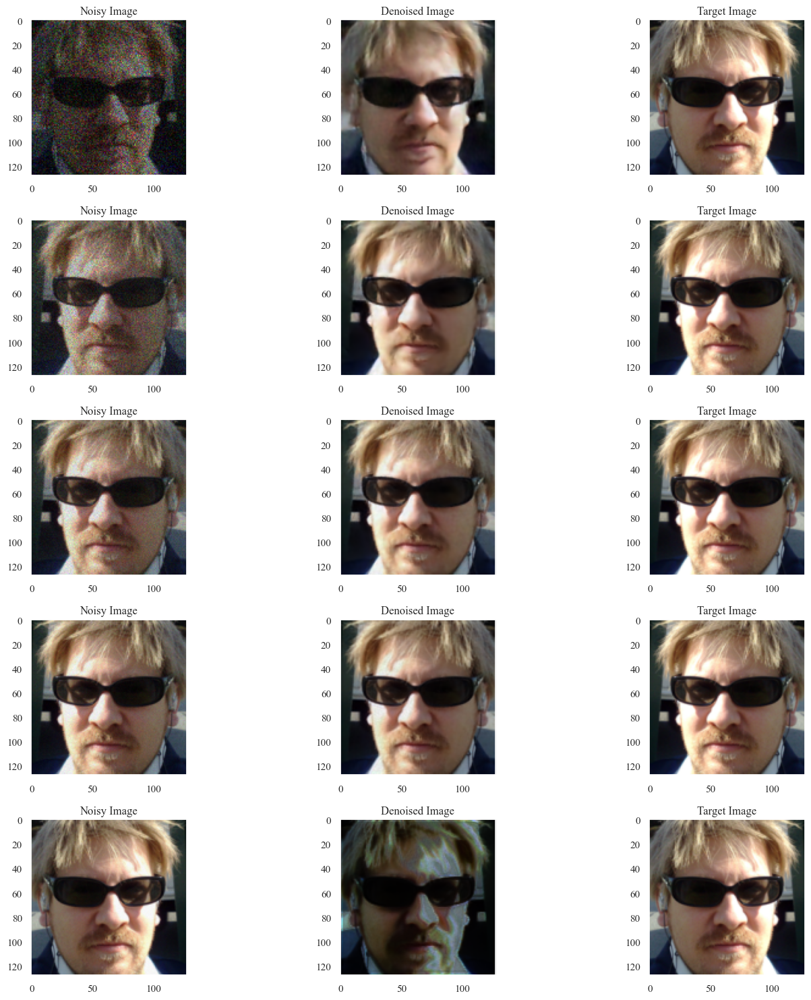

In [37]:
# Continuation of above
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [63]:
# # Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Third Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_4 = np.array(Psnr_Distribution)
SSIM_Distribution_4 = np.array(SSIM_Distribution)
Perceptual_Distribution_4 = np.array(Perceptual_Distribution)
Psnr_Distribution_4.shape, SSIM_Distribution_4.shape, Perceptual_Distribution_4.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,21.001139,-3.559511,20.811117,1.323155,22.134273,19.487962
std,11.882575,20.564969,11.766223,0.333783,11.848052,11.693353
min,3.768909,-39.119021,6.594083,0.556220,7.678365,5.118328
25%,8.735113,-21.339266,8.043170,1.095330,9.399122,7.108038
50%,19.673579,-3.559511,19.367418,1.297386,20.846387,17.826543
75%,32.481033,14.220245,32.405482,1.548923,33.857463,31.132919
max,43.173986,32.000000,40.311155,2.488702,42.246746,38.589062


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.526828,-3.559511,0.521771,0.039015,0.560786,0.482757
std,0.363230,20.564969,0.359774,0.025634,0.352594,0.368601
min,0.054268,-39.119021,0.090029,0.002848,0.110746,0.062377
25%,0.153173,-21.339266,0.154451,0.020081,0.194842,0.116793
50%,0.497624,-3.559511,0.450266,0.032407,0.550997,0.354683
75%,0.926676,14.220245,0.926891,0.051653,0.947554,0.904535
max,0.991339,32.000000,0.985769,0.137452,0.992659,0.982622


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.458049,-3.119021,0.454351,0.055432,0.463671,0.445031
std,0.289767,20.310653,0.284068,0.026186,0.287536,0.280714
min,-0.056061,-38.238042,0.102119,0.011593,0.104473,0.098054
25%,0.142564,-20.678532,0.128433,0.028201,0.132276,0.124705
50%,0.523402,-3.119021,0.526692,0.058256,0.557621,0.495763
75%,0.734915,14.440489,0.737019,0.074004,0.747924,0.726137
max,0.912006,32.000000,0.813860,0.128119,0.829217,0.804460


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

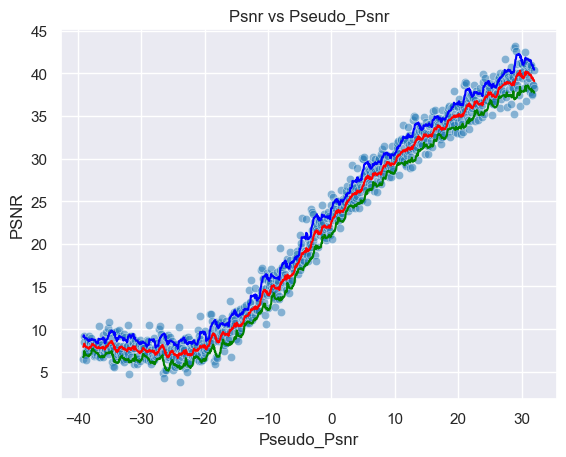

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

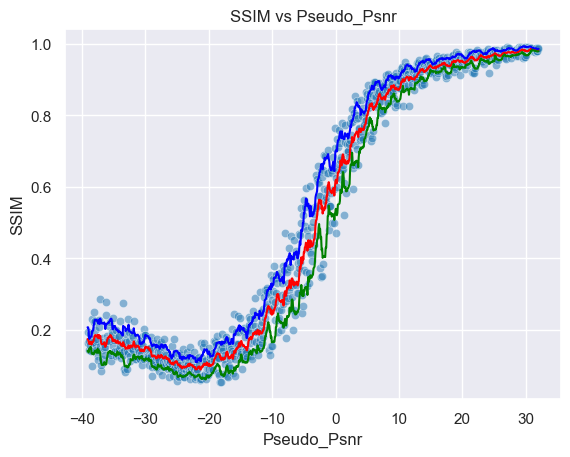

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

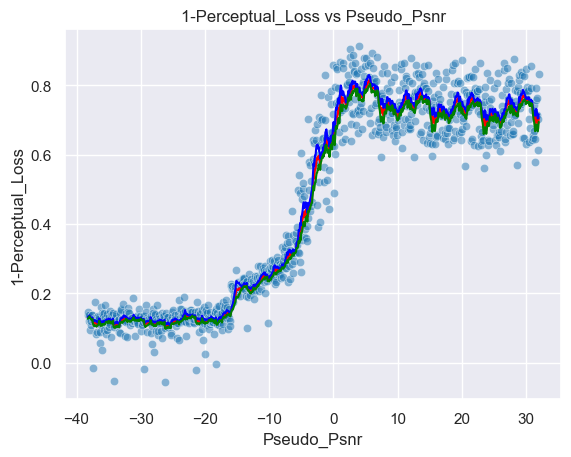

Psnr Area: 1479.8513384556045, SSIM Area: 37.10331506914437, Perceptual Area: 31.915713734369522
Mean Psnr 21.001139254750992
Std Psnr 11.882574717052762
Min Psnr 3.7689090201993523
Max Psnr 43.173986166448415
Mean Roll Var 1.3231553984906073
Mean SSIM 0.5268282
Std SSIM 0.36323022842407227
Min SSIM 0.054268330335617065
Max SSIM 0.991339385509491
Mean Roll SSIM 0.03901459875939012
Mean 1-PL 0.45804903
Std 1-PL 0.28976666927337646
Min 1-PL -0.05606067180633545
Max 1-PL 0.9120064973831177
Mean Roll 1-PL 0.05543236146286514


(1479.8513384556045, 37.10331506914437, 31.915713734369522)

In [64]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Third Highest PSNR Range.
Plot_Creater(Psnr_Distribution_4, SSIM_Distribution_4, Perceptual_Distribution_4, minpsnr, maxpsnr)

In [65]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fourth Highest PSNR Range 
print(PSNR_Ranges[-4][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-4][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-4][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

0 32


(16384, 4096)

In [66]:
# Creates the directory to save the model in for the Fourth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-0-32"
CHECKPOINT_PATH = "./models/" 

In [33]:
# Trains the model using the Pytorch Lightning Trainer for the Fourth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [34]:
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [67]:
# Loads the model from the checkpoint for the Fourth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [36]:
# Validates the trained model on the Train Set for the Fourth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16749678552150726    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16749678552150726}]

In [37]:
# Validates the trained model on the Validation Set for the Fourth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16721151769161224    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16721151769161224}]

2.6738317 0.05326358 2.524693727493286 0.9693971872329712
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 23.112802505493164
23.11203843444353 23.11203843444353 -2.588596909321764e-07


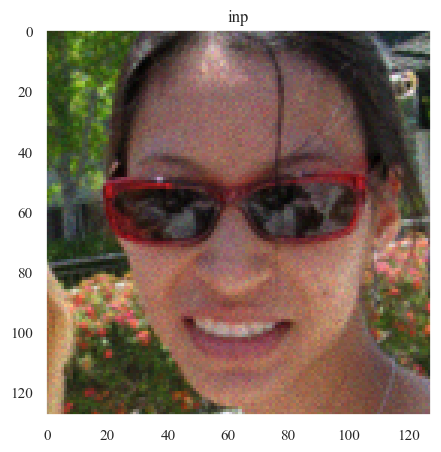

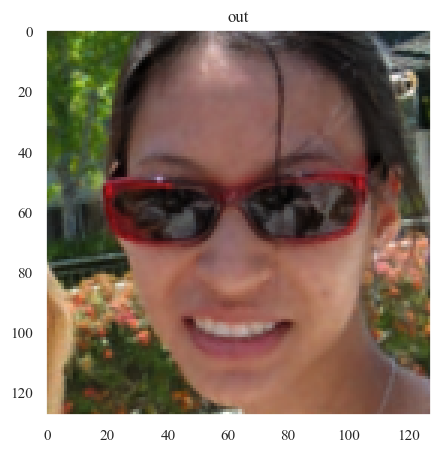

Text(0.5, 1.0, 'GT')

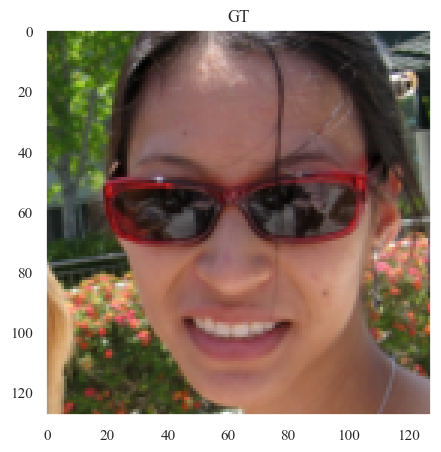

In [38]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

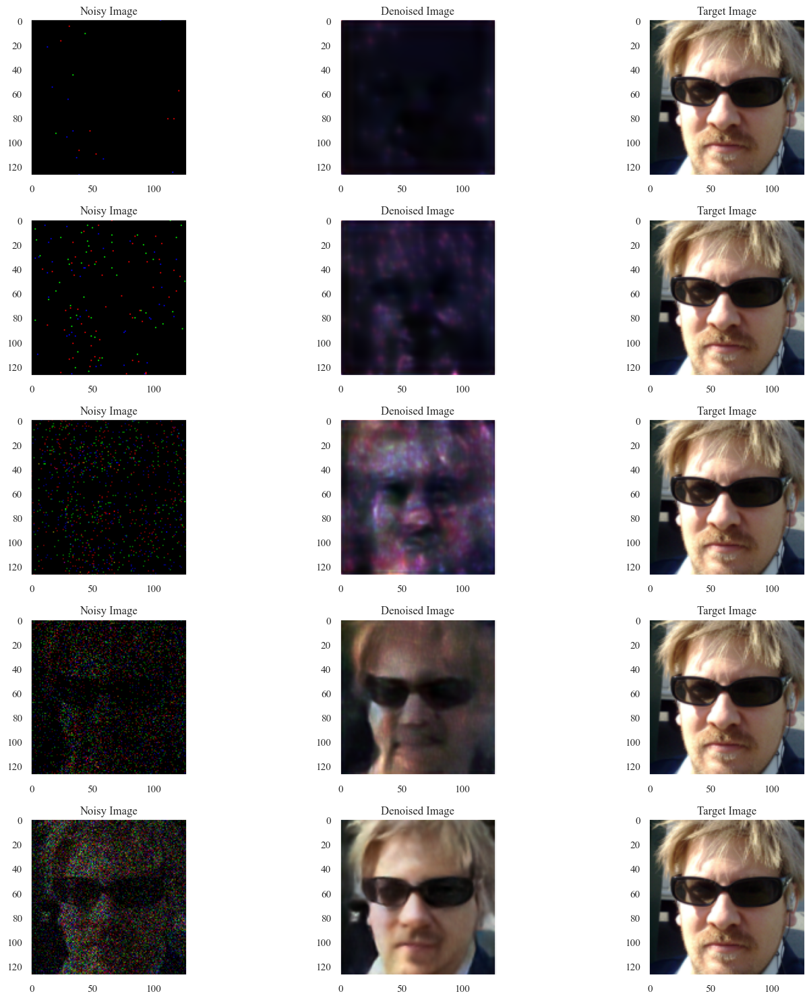

In [39]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

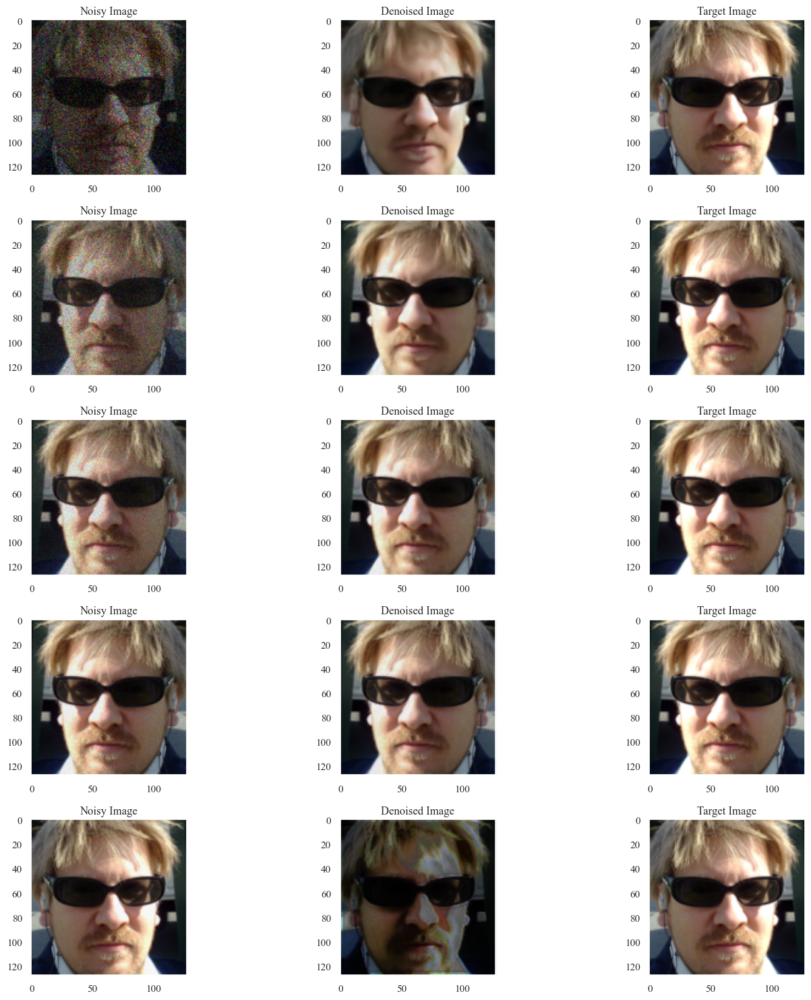

In [40]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [68]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fourth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_5 = np.array(Psnr_Distribution)
SSIM_Distribution_5 = np.array(SSIM_Distribution)
Perceptual_Distribution_5 = np.array(Perceptual_Distribution)
Psnr_Distribution_5.shape, SSIM_Distribution_5.shape, Perceptual_Distribution_5.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,23.076582,-3.559511,22.893254,1.269128,24.162382,21.624126
std,10.599095,20.564969,10.506823,0.289538,10.607388,10.413339
min,6.260430,-39.119021,8.655815,0.476279,9.289318,7.284028
25%,12.173102,-21.339266,11.770338,1.075124,12.598766,10.699390
50%,23.226821,-3.559511,22.956043,1.261724,24.370635,21.589426
75%,32.756765,14.220245,32.672886,1.450090,34.077527,31.405257
max,43.119214,32.000000,40.312316,2.474484,42.211458,38.617572


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.607255,-3.559511,0.602354,0.035897,0.638251,0.566457
std,0.321357,20.564969,0.319251,0.019489,0.310131,0.329274
min,0.104079,-39.119021,0.172124,0.002703,0.186356,0.133493
25%,0.239056,-21.339266,0.225277,0.020300,0.268830,0.191507
50%,0.686737,-3.559511,0.663504,0.033740,0.729820,0.599554
75%,0.932396,14.220245,0.932016,0.050012,0.951007,0.911758
max,0.991142,32.000000,0.985667,0.093091,0.992455,0.982643


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.478210,-3.119021,0.474514,0.051172,0.483681,0.465347
std,0.311836,20.310653,0.307826,0.021187,0.310700,0.305076
min,-0.055785,-38.238042,0.097552,0.011177,0.102143,0.091560
25%,0.132357,-20.678532,0.123053,0.032440,0.126675,0.119786
50%,0.635577,-3.119021,0.684103,0.052308,0.700015,0.663628
75%,0.767879,14.440489,0.751305,0.068637,0.760551,0.740623
max,0.935555,32.000000,0.880538,0.109434,0.889895,0.874120


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

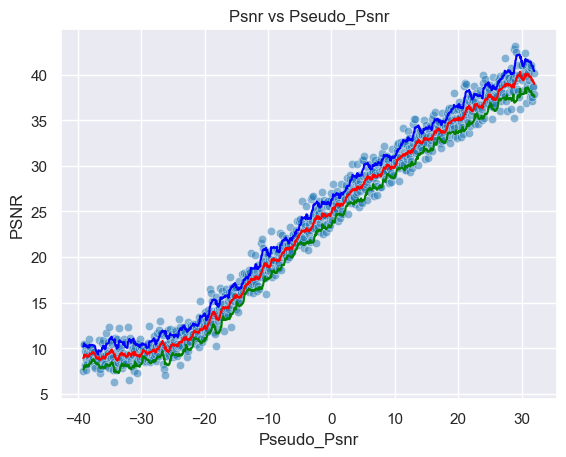

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

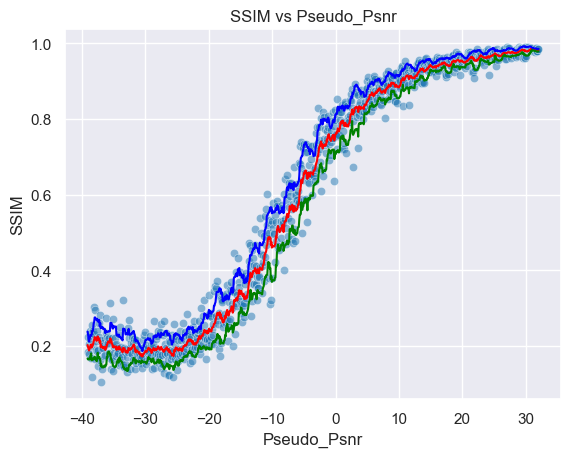

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

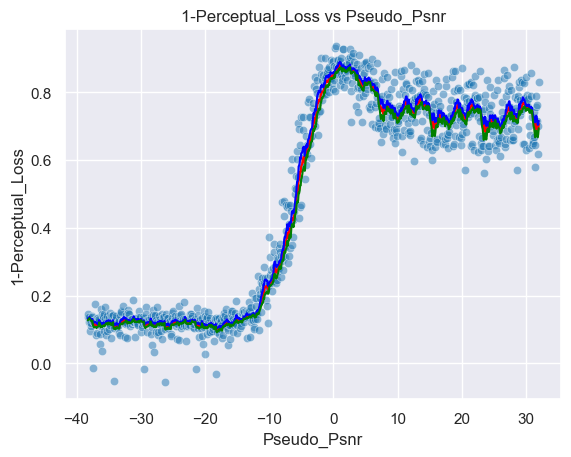

Psnr Area: 1628.0613337606437, SSIM Area: 42.83962282044471, Perceptual Area: 33.33354978434103
Mean Psnr 23.0765816331265
Std Psnr 10.599095073272638
Min Psnr 6.260429917572115
Max Psnr 43.11921392994223
Mean Roll Var 1.2691279156833588
Mean SSIM 0.6072551
Std SSIM 0.3213571310043335
Min SSIM 0.10407931357622147
Max SSIM 0.9911417961120605
Mean Roll SSIM 0.035896856541818574
Mean 1-PL 0.4782103
Std 1-PL 0.31183579564094543
Min 1-PL -0.055785417556762695
Max 1-PL 0.9355549216270447
Mean Roll 1-PL 0.051171708380766304


(1628.0613337606437, 42.83962282044471, 33.33354978434103)

In [69]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fourth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_5, SSIM_Distribution_5, Perceptual_Distribution_5, minpsnr, maxpsnr)

In [77]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fifth Highest PSNR Range
print(PSNR_Ranges[-5][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-5][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-5][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-8 32


(16384, 4096)

In [78]:
# Creates the directory to save the model in for the Fifth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m8-32"
CHECKPOINT_PATH = "./models/" 

In [26]:
# Trains the model using the Pytorch Lightning Trainer for the Fifth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [27]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [79]:
# Loads the model from the checkpoint for the Fifth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [29]:
# # Validates the trained model on the Train Set for the Fifth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16543367505073547    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16543367505073547}]

In [30]:
# Validates the trained model on the Validation Set for the Fifth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16517487168312073    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16517487168312073}]

2.6738317 0.05326358 2.524693727493286 0.9693971872329712
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 12.638736724853516
12.64013298709633 12.64013298709633 -2.588596909321764e-07


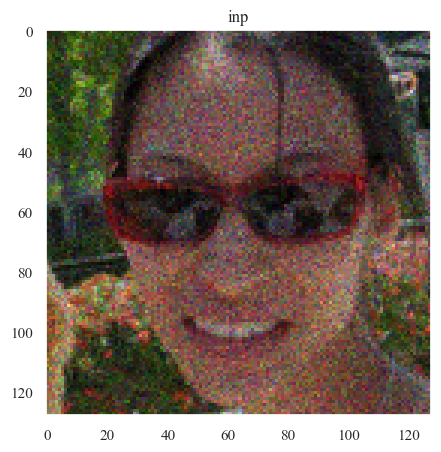

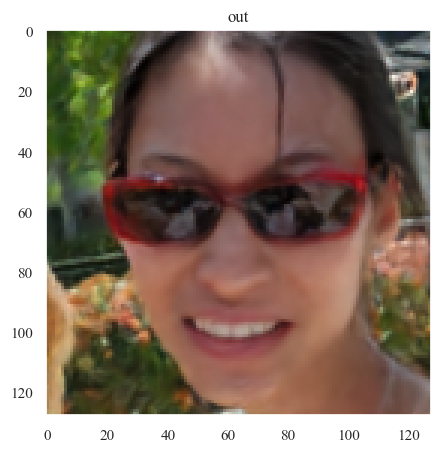

Text(0.5, 1.0, 'GT')

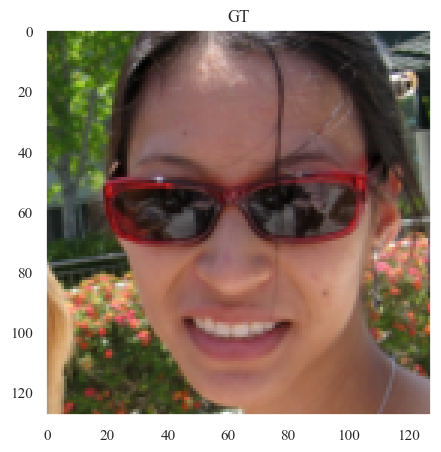

In [31]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image. 
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

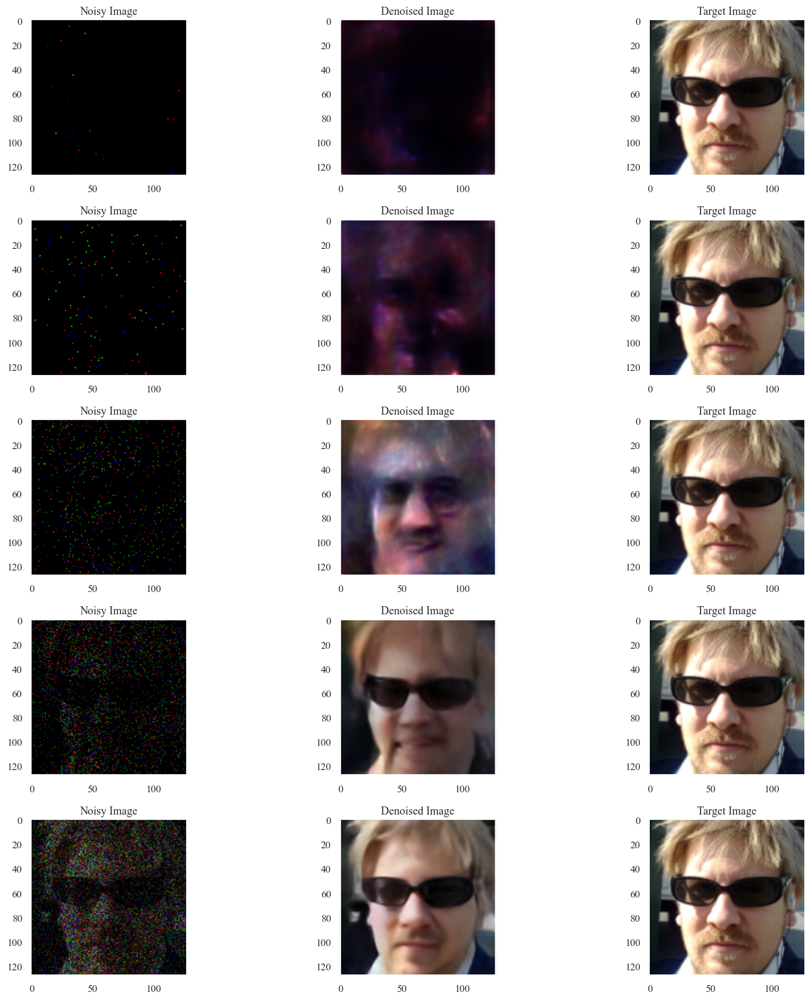

In [32]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

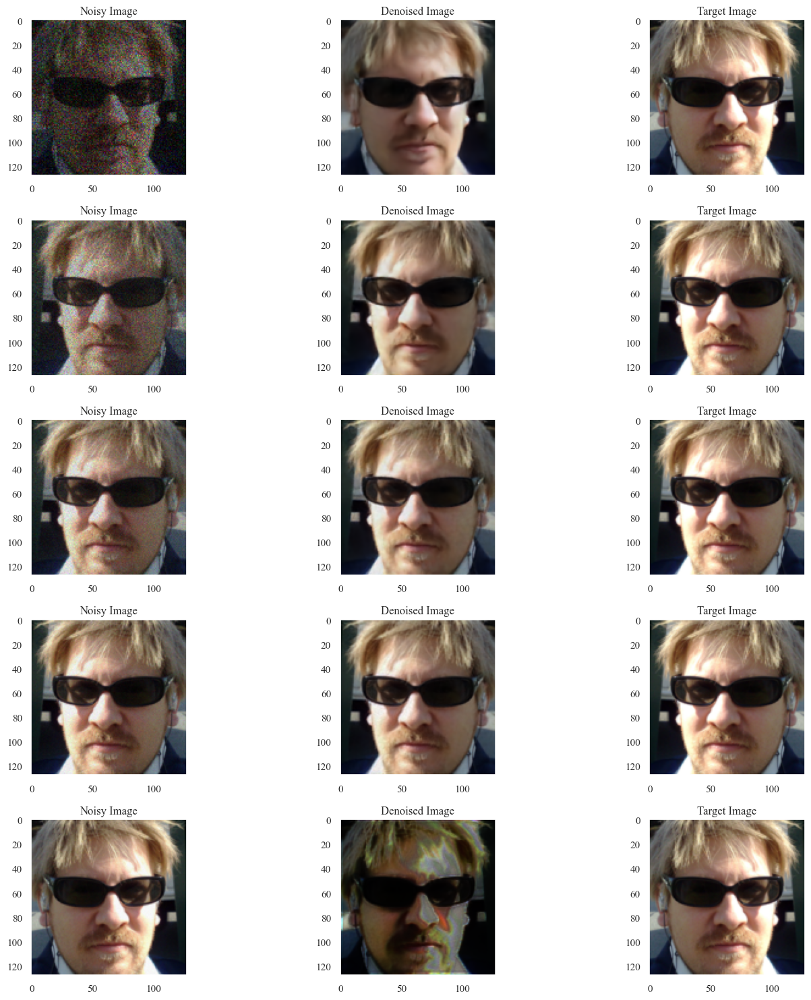

In [33]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [80]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fifth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_6 = np.array(Psnr_Distribution)
SSIM_Distribution_6 = np.array(SSIM_Distribution)
Perceptual_Distribution_6 = np.array(Perceptual_Distribution)
Psnr_Distribution_6.shape, SSIM_Distribution_6.shape, Perceptual_Distribution_6.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,23.014843,-3.559511,22.812927,1.377986,24.190913,21.434941
std,10.933365,20.564969,10.864040,0.332129,10.867596,10.870635
min,3.188678,-39.119021,5.161793,0.639212,6.301654,3.774042
25%,13.047508,-21.339266,13.057883,1.131168,13.899851,11.911549
50%,23.958114,-3.559511,23.733895,1.337408,25.087717,22.257353
75%,32.710042,14.220245,32.604063,1.555699,34.025840,31.324860
max,42.990586,32.000000,40.144888,2.693931,42.148761,38.425408


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.625289,-3.559511,0.620052,0.035085,0.655137,0.584967
std,0.319104,20.564969,0.317916,0.018244,0.310231,0.326441
min,0.077679,-39.119021,0.130531,0.002623,0.154671,0.097387
25%,0.271190,-21.339266,0.266626,0.020396,0.306286,0.228810
50%,0.729913,-3.559511,0.715605,0.032951,0.772006,0.660963
75%,0.931197,14.220245,0.930996,0.050078,0.950481,0.910295
max,0.990658,32.000000,0.985125,0.079094,0.992067,0.982077


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.481161,-3.119021,0.477471,0.051233,0.486608,0.468334
std,0.312133,20.310653,0.308199,0.020520,0.310921,0.305591
min,-0.055657,-38.238042,0.096028,0.011088,0.102205,0.089850
25%,0.131928,-20.678532,0.122770,0.033483,0.126361,0.119248
50%,0.638703,-3.119021,0.688205,0.054275,0.702179,0.666619
75%,0.768943,14.440489,0.751937,0.068574,0.761100,0.740976
max,0.935692,32.000000,0.882320,0.096036,0.890125,0.877324


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

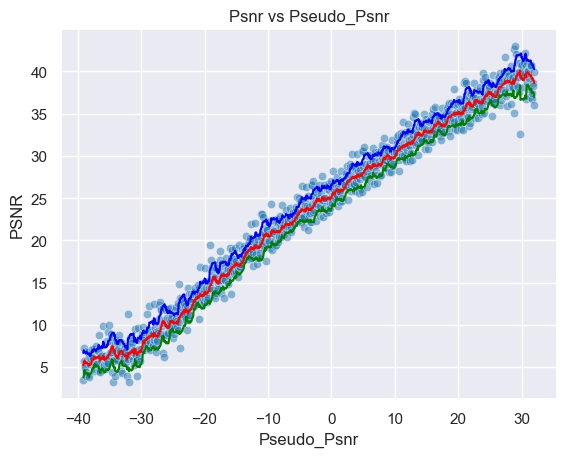

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

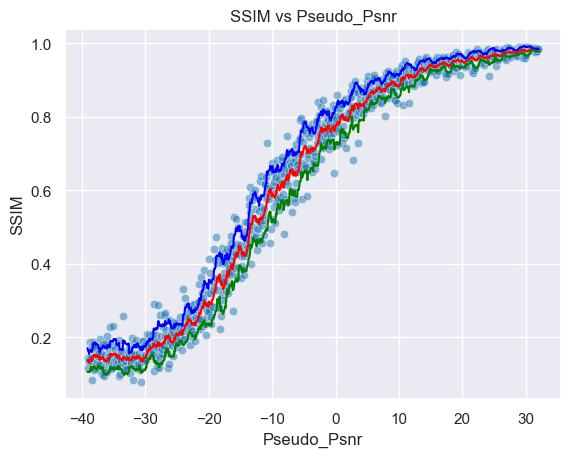

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

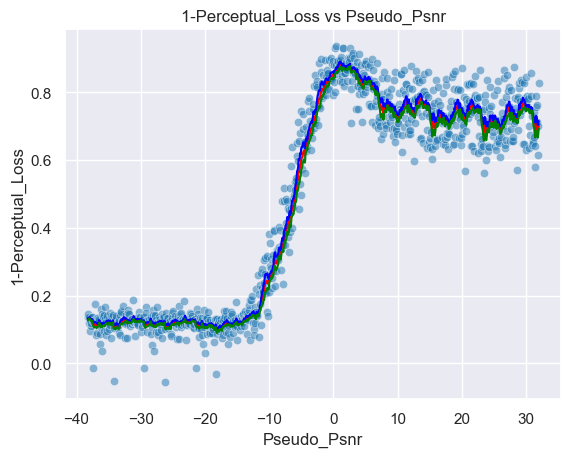

Psnr Area: 1622.5047576842203, SSIM Area: 44.10228747662335, Perceptual Area: 33.54151225845859
Mean Psnr 23.014842754768065
Std Psnr 10.93336534969373
Min Psnr 3.188678233027087
Max Psnr 42.99058586945893
Mean Roll Var 1.377986094562574
Mean SSIM 0.625289
Std SSIM 0.31910350918769836
Min SSIM 0.07767888158559799
Max SSIM 0.9906578660011292
Mean Roll SSIM 0.03508496908940626
Mean 1-PL 0.48116133
Std 1-PL 0.31213295459747314
Min 1-PL -0.0556567907333374
Max 1-PL 0.9356919527053833
Mean Roll 1-PL 0.05123283896432092


(1622.5047576842203, 44.10228747662335, 33.54151225845859)

In [81]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fifth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_6, SSIM_Distribution_6, Perceptual_Distribution_6, minpsnr, maxpsnr)

In [82]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Sixth Highest PSNR Range
print(PSNR_Ranges[-6][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-6][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-6][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-16 32


(16384, 4096)

In [83]:
# Creates the directory to save the model in for the Sixth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m16-32"
CHECKPOINT_PATH = "./models/" 

In [38]:
# Trains the model using the Pytorch Lightning Trainer for the Sixth Highest PSNR Range. 
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [39]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [84]:
# Loads the model from the checkpoint for the Sixth Highest PSNR Range. 
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [41]:
# Validates the trained model on the Train Set for the Sixth Highest PSNR Range. 
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16143381595611572    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16143381595611572}]

In [42]:
# Validates the trained model on the Validation Set for the Sixth Highest PSNR Range. 
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1638680398464203    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1638680398464203}]

1.8394917 0.0 1.8394917249679565 1.0387717485427856
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 11.567646026611328
11.570069049207962 11.570069049207962 0.0


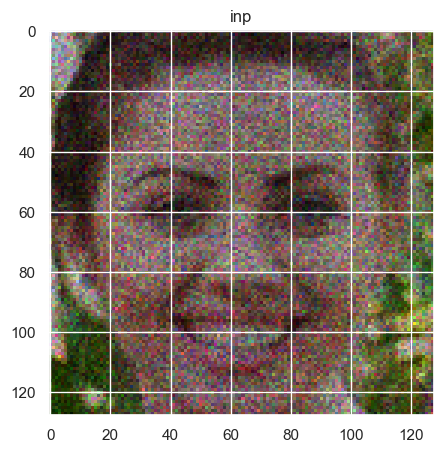

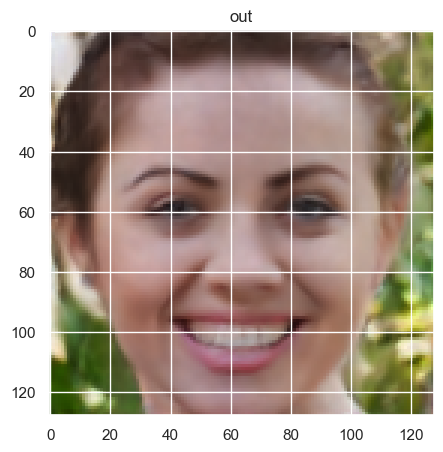

Text(0.5, 1.0, 'GT')

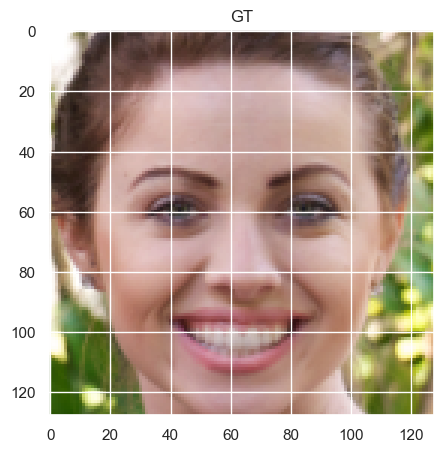

In [43]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

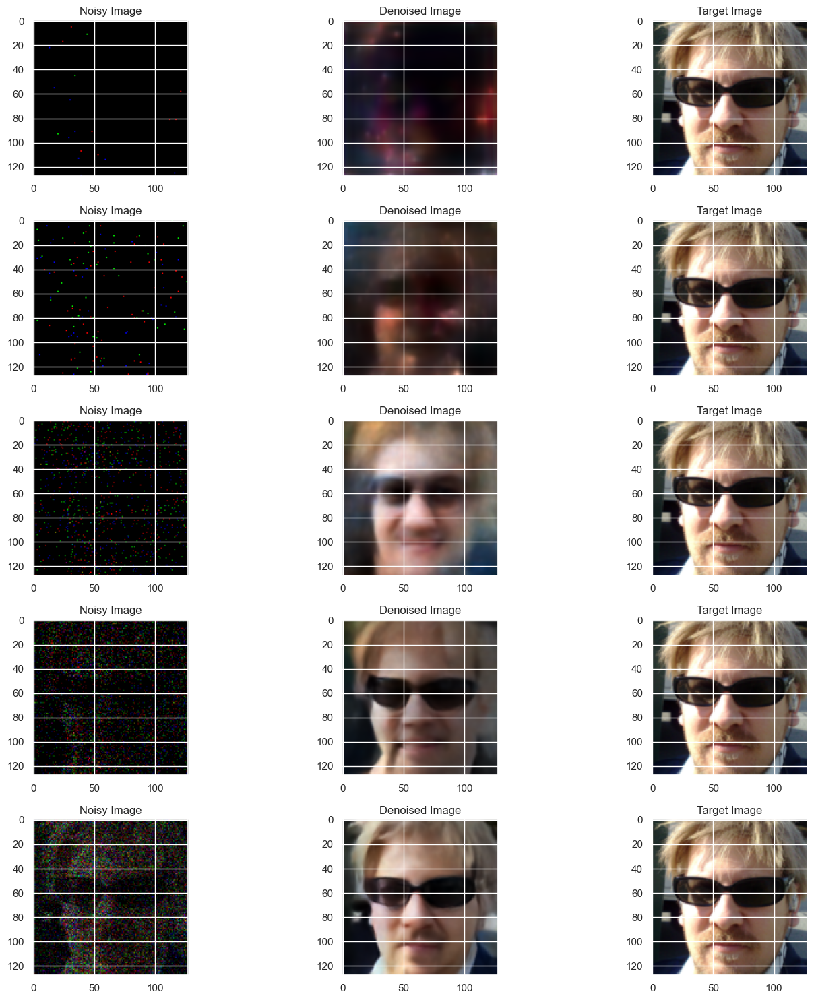

In [44]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

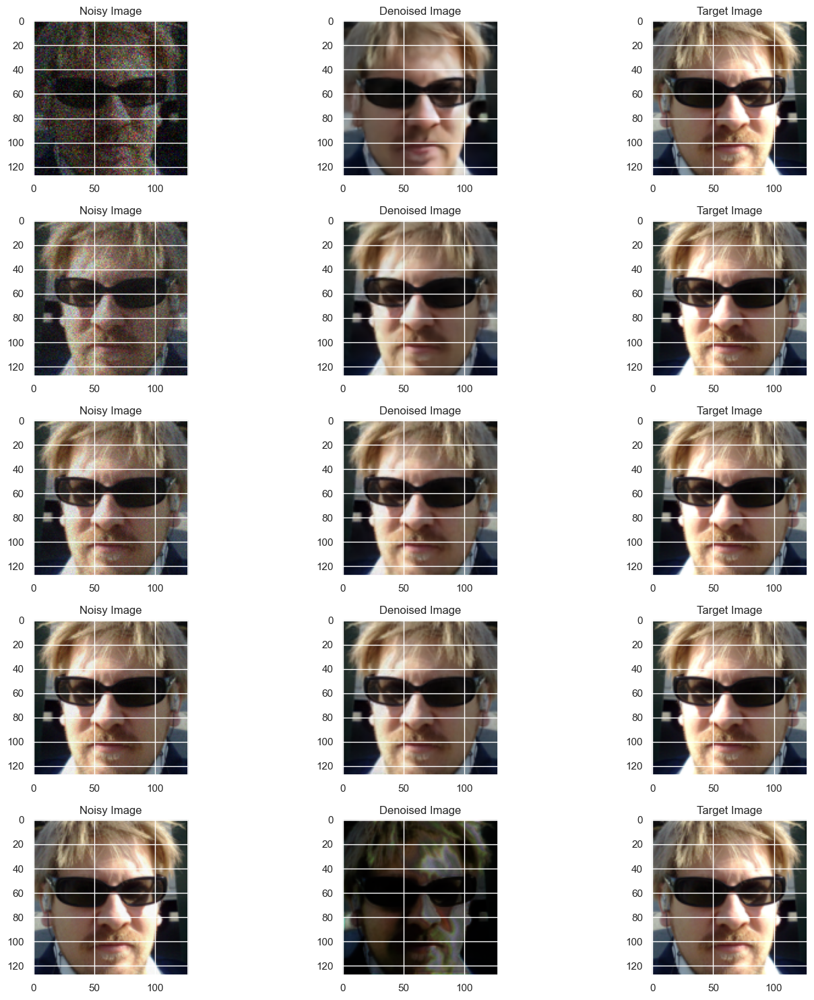

In [45]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [85]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Sixth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_7 = np.array(Psnr_Distribution)
SSIM_Distribution_7 = np.array(SSIM_Distribution)
Perceptual_Distribution_7 = np.array(Perceptual_Distribution)
Psnr_Distribution_7.shape, SSIM_Distribution_7.shape, Perceptual_Distribution_7.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,23.653765,-3.559511,23.469046,1.386892,24.855938,22.082153
std,9.992108,20.564969,9.913793,0.343644,9.920139,9.919355
min,4.624082,-39.119021,7.020336,0.586904,8.224360,5.799302
25%,15.340585,-21.339266,15.570605,1.139533,16.457212,14.331917
50%,23.874526,-3.559511,23.740817,1.326810,25.145503,22.308532
75%,32.404785,14.220245,32.355713,1.586468,33.850948,31.067423
max,42.601373,32.000000,39.771432,2.509739,41.653123,38.011492


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.648724,-3.559511,0.643450,0.037714,0.681165,0.605736
std,0.295720,20.564969,0.294657,0.018397,0.285194,0.304937
min,0.083583,-39.119021,0.117361,0.002631,0.143649,0.085835
25%,0.383935,-21.339266,0.379593,0.022053,0.418528,0.337605
50%,0.732208,-3.559511,0.717447,0.039247,0.774738,0.663438
75%,0.927231,14.220245,0.927422,0.052461,0.949022,0.905514
max,0.989530,32.000000,0.983830,0.086855,0.990957,0.980798


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.479789,-3.119021,0.476121,0.051723,0.485308,0.466935
std,0.312686,20.310653,0.308677,0.020700,0.311405,0.306065
min,-0.054489,-38.238042,0.094623,0.011149,0.097263,0.090170
25%,0.130540,-20.678532,0.122318,0.032983,0.125873,0.118981
50%,0.635571,-3.119021,0.685941,0.054438,0.700516,0.664485
75%,0.767276,14.440489,0.749923,0.068857,0.759709,0.739494
max,0.933947,32.000000,0.884413,0.097776,0.892426,0.878041


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

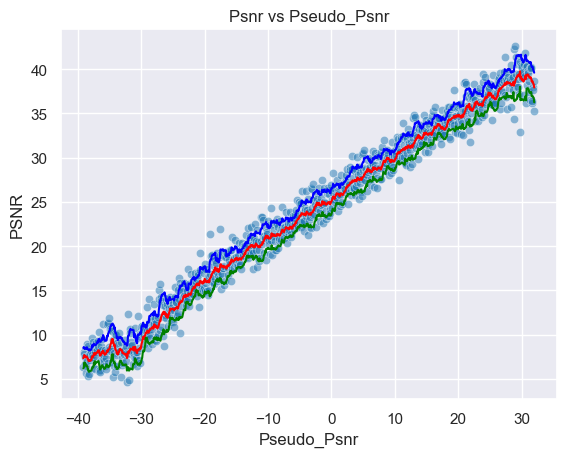

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

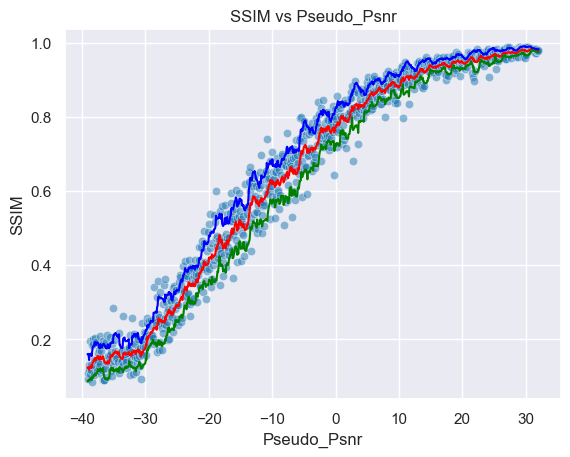

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

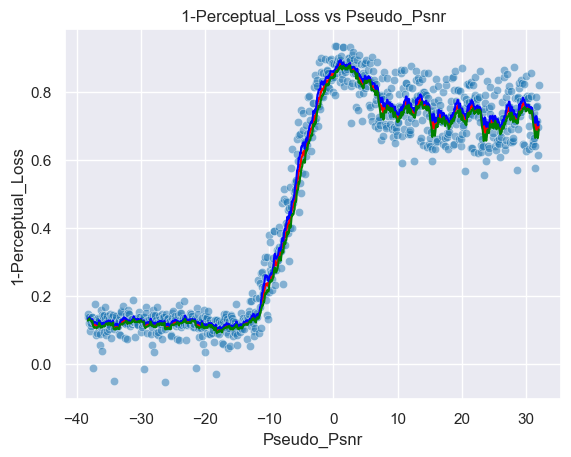

Psnr Area: 1669.1617203599085, SSIM Area: 45.76893525757103, Perceptual Area: 33.44672329500069
Mean Psnr 23.653764977102746
Std Psnr 9.992107940404432
Min Psnr 4.624081830074246
Max Psnr 42.60137265375775
Mean Roll Var 1.3868922526825613
Mean SSIM 0.6487245
Std SSIM 0.29571953415870667
Min SSIM 0.08358288556337357
Max SSIM 0.9895300269126892
Mean Roll SSIM 0.03771431697085752
Mean 1-PL 0.47978917
Std 1-PL 0.31268569827079773
Min 1-PL -0.0544886589050293
Max 1-PL 0.933946967124939
Mean Roll 1-PL 0.051723485826522204


(1669.1617203599085, 45.76893525757103, 33.44672329500069)

In [86]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Sixth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_7, SSIM_Distribution_7, Perceptual_Distribution_7, minpsnr, maxpsnr)

In [87]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Seventh Highest PSNR Range
print(PSNR_Ranges[-7][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-7][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-7][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-24 32


(16384, 4096)

In [88]:
# Creates the directory to save the model in for the Seventh Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m24-32"
CHECKPOINT_PATH = "./models/" 

In [50]:
# Trains the model using the Pytorch Lightning Trainer for the Seventh Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [51]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [89]:
# Loads the model from the checkpoint for the Seventh Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [53]:
# Validates the trained model on the Train Set for the Seventh Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1553330421447754    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1553330421447754}]

In [54]:
# Validates the trained model on the Validation Set for the Seventh Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.157734215259552     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.157734215259552}]

1.7697597 0.18044609 1.7697596549987793 0.9299913644790649
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -11.806774139404297
-11.839551707267402 -11.839551707267402 -2.588596909321764e-07


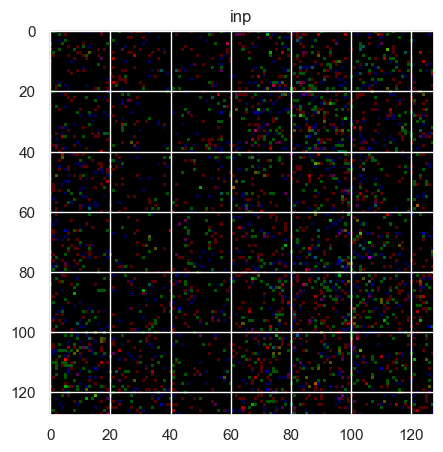

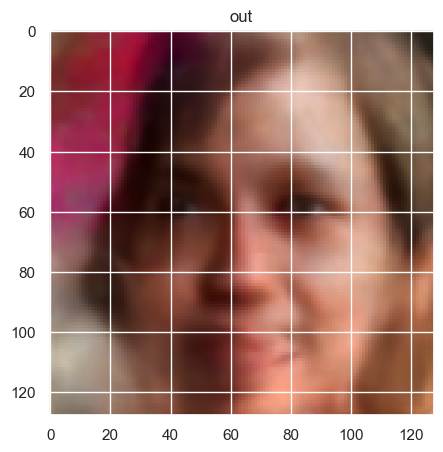

Text(0.5, 1.0, 'GT')

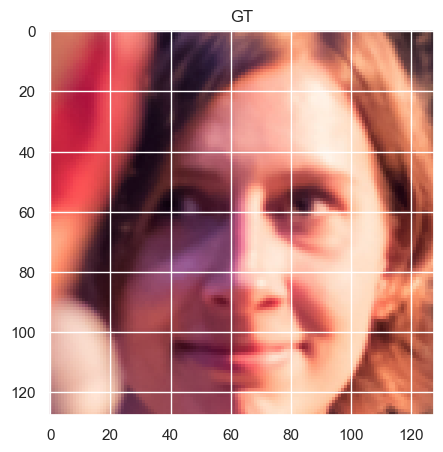

In [55]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

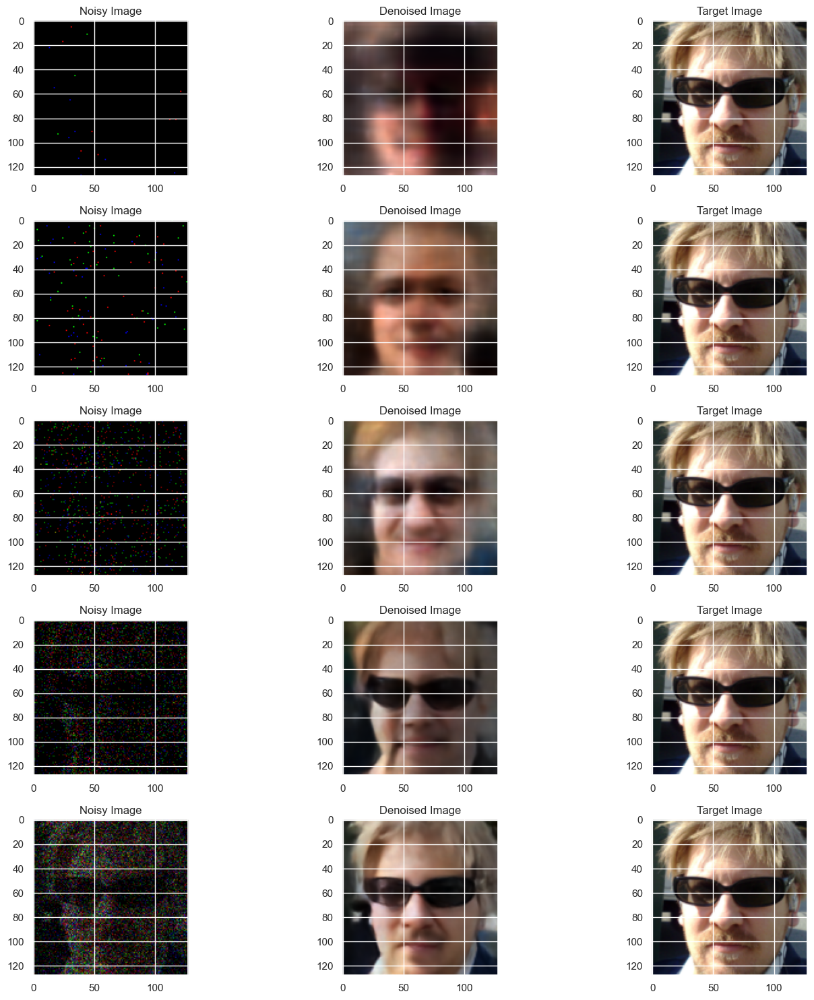

In [56]:
# Plots for a sample image the Noisy Image, its corresponding denoised image and the Target Image.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

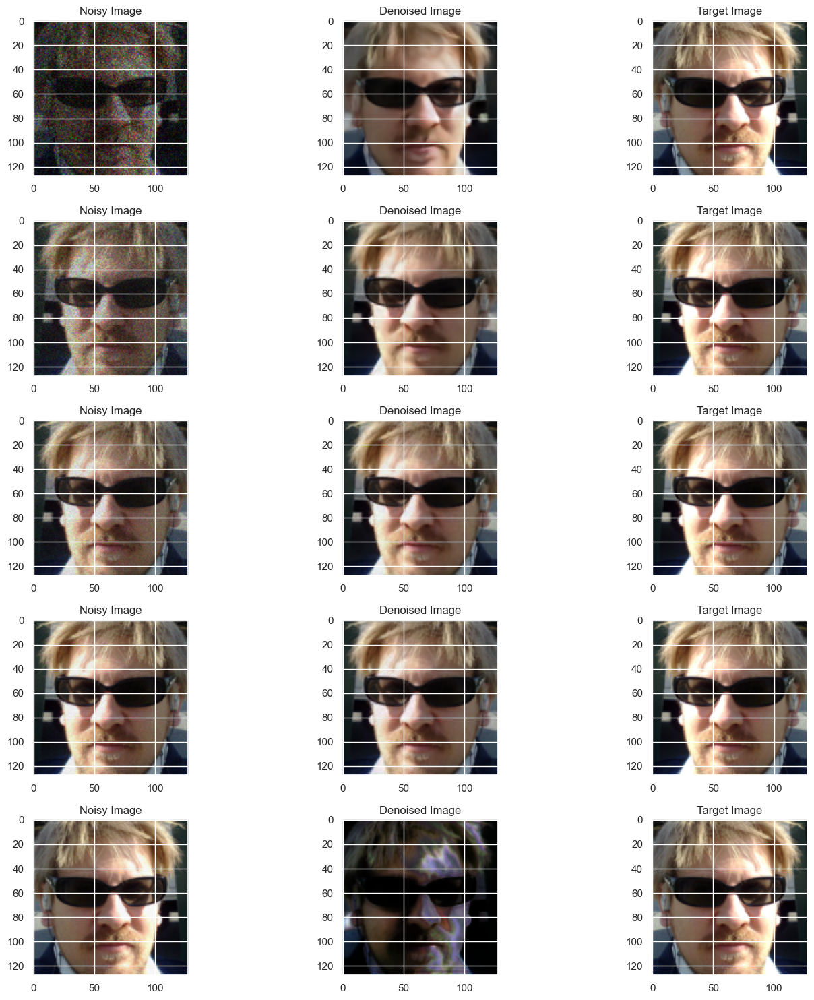

In [57]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [90]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Seventh Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_8 = np.array(Psnr_Distribution)
SSIM_Distribution_8 = np.array(SSIM_Distribution)
Perceptual_Distribution_8 = np.array(Perceptual_Distribution)
Psnr_Distribution_8.shape, SSIM_Distribution_8.shape, Perceptual_Distribution_8.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,24.062033,-3.559511,23.884254,1.437492,25.321747,22.446762
std,9.276923,20.564969,9.190336,0.390360,9.171930,9.225237
min,5.084161,-39.119021,7.246243,0.707891,8.803871,5.688616
25%,16.412841,-21.339266,16.576896,1.162653,17.771590,15.120651
50%,23.867159,-3.559511,23.725141,1.358171,25.032785,22.266693
75%,32.265733,14.220245,32.291736,1.620525,33.660492,31.063567
max,42.243484,32.000000,39.404052,2.977114,41.557015,37.605080


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.669838,-3.559511,0.664881,0.040969,0.705849,0.623912
std,0.264978,20.564969,0.263088,0.019860,0.249696,0.277256
min,0.101160,-39.119021,0.161519,0.002712,0.198481,0.122842
25%,0.438155,-21.339266,0.433213,0.023082,0.489942,0.374299
50%,0.728211,-3.559511,0.713534,0.043891,0.772420,0.658109
75%,0.925084,14.220245,0.925619,0.057681,0.948526,0.902493
max,0.989446,32.000000,0.983100,0.088008,0.991388,0.979784


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.479024,-3.119021,0.475349,0.052105,0.484594,0.466104
std,0.311597,20.310653,0.307483,0.020975,0.310247,0.304837
min,-0.053165,-38.238042,0.096484,0.011075,0.099038,0.092516
25%,0.131165,-20.678532,0.123104,0.033113,0.126609,0.119726
50%,0.633678,-3.119021,0.684464,0.054600,0.699583,0.664849
75%,0.765977,14.440489,0.748053,0.069500,0.757317,0.737537
max,0.936725,32.000000,0.883137,0.099523,0.890896,0.875507


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

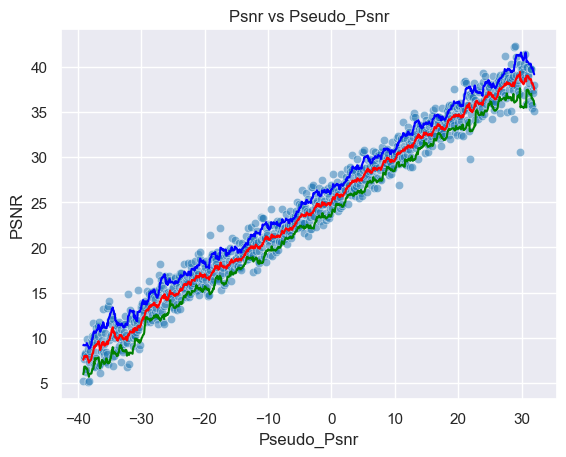

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

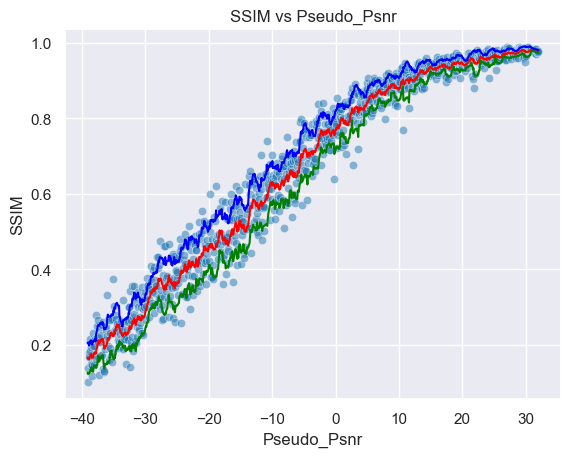

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

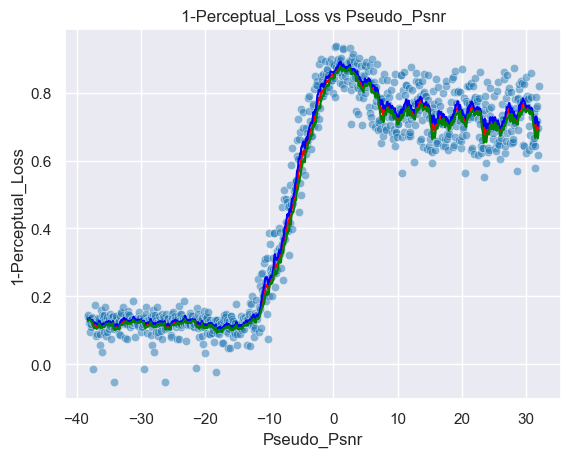

Psnr Area: 1698.7344849436681, SSIM Area: 47.29310705366071, Perceptual Area: 33.39234344354594
Mean Psnr 24.06203278699572
Std Psnr 9.276923438566342
Min Psnr 5.084161191065294
Max Psnr 42.24348444617978
Mean Roll Var 1.4374922407740287
Mean SSIM 0.6698377
Std SSIM 0.26497846841812134
Min SSIM 0.10116040706634521
Max SSIM 0.989446222782135
Mean Roll SSIM 0.040968602004018424
Mean 1-PL 0.47902372
Std 1-PL 0.31159698963165283
Min 1-PL -0.05316472053527832
Max 1-PL 0.9367249608039856
Mean Roll 1-PL 0.05210517543802013


(1698.7344849436681, 47.29310705366071, 33.39234344354594)

In [91]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Seventh Highest PSNR Range.
Plot_Creater(Psnr_Distribution_8, SSIM_Distribution_8, Perceptual_Distribution_8, minpsnr, maxpsnr)

In [92]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Eighth Highest PSNR Range
print(PSNR_Ranges[-8][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-8][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-8][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-32 32


(16384, 4096)

In [93]:
# Creates the directory to save the model in for the Eighth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m32-32"
CHECKPOINT_PATH = "./models/" 

In [80]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [81]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [82]:
# Loads the model from the checkpoint for the Eighth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14678926765918732    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14678926765918732}]

In [83]:
# Validates the trained model on the Train Set for the Eighth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14784127473831177    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14784127473831177}]

In [94]:
# Validates the trained model on the Validation Set for the Eighth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


2.0794952 0.08970372 2.071340322494507 0.8725724816322327
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -3.12359619140625
-3.082465756516881 -3.082465756516881 5.177193355766363e-07


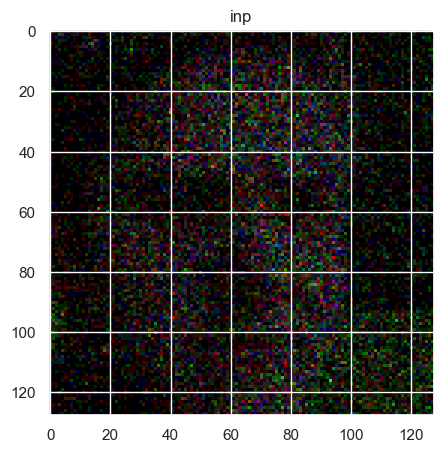

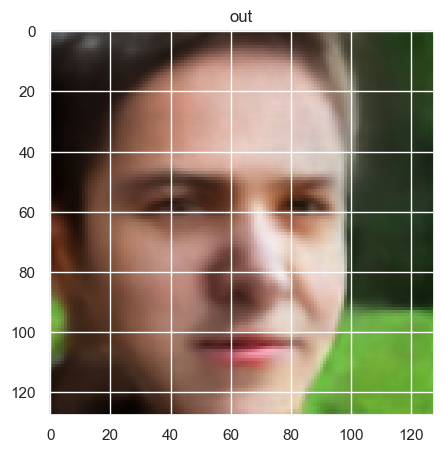

Text(0.5, 1.0, 'GT')

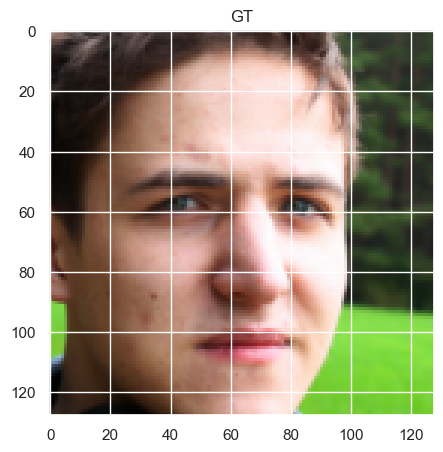

In [85]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

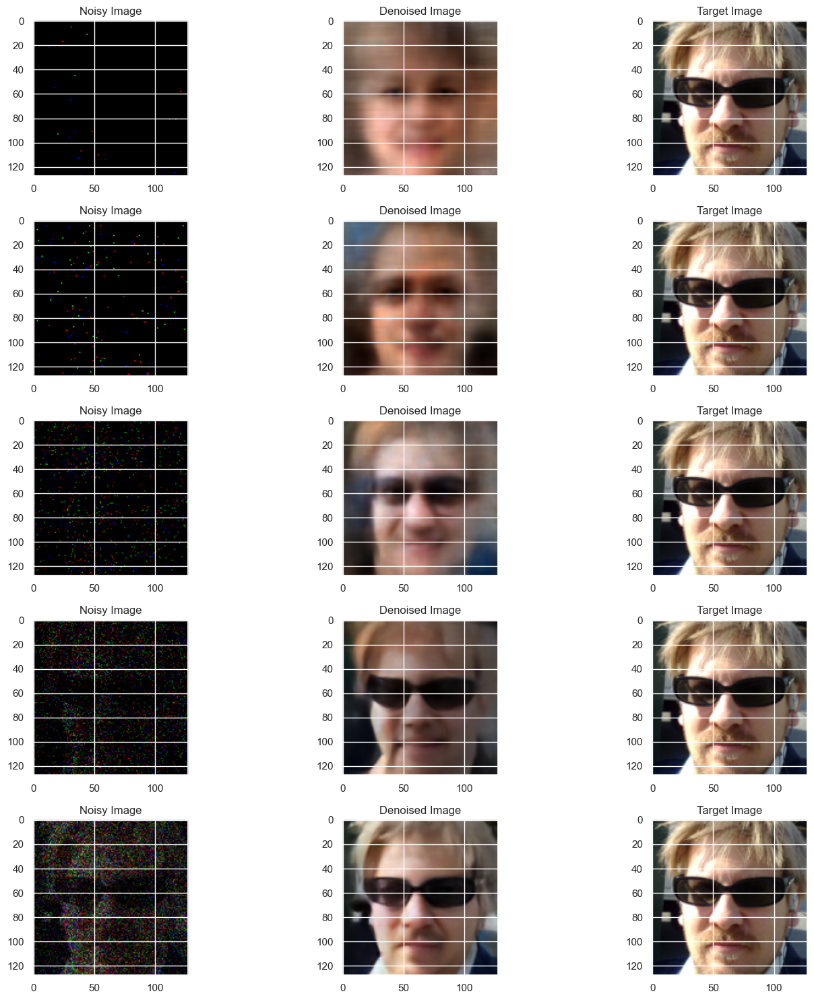

In [86]:
# # Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

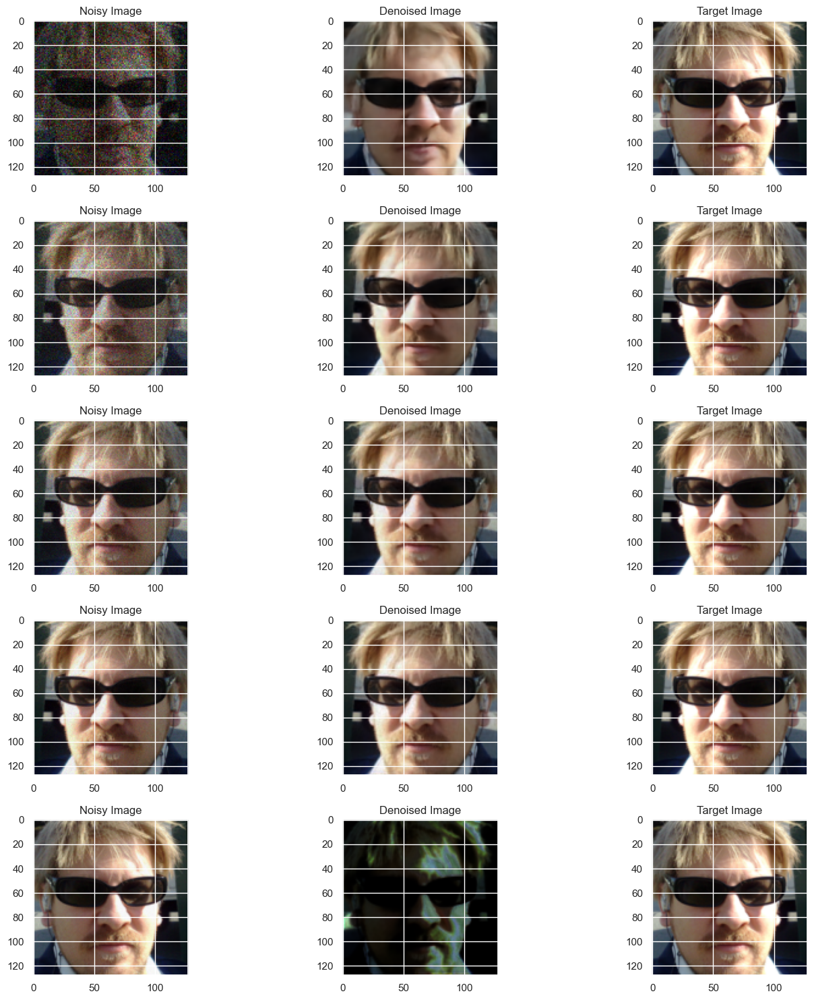

In [87]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [95]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Eighth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_9 = np.array(Psnr_Distribution)
SSIM_Distribution_9 = np.array(SSIM_Distribution)
Perceptual_Distribution_9 = np.array(Perceptual_Distribution)
Psnr_Distribution_9.shape, SSIM_Distribution_9.shape, Perceptual_Distribution_9.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,24.589073,-3.559511,24.444862,1.390022,25.834884,23.054840
std,8.462182,20.564969,8.341053,0.326039,8.378412,8.316318
min,9.802311,-39.119021,12.699134,0.764435,13.889205,11.361336
25%,16.716335,-21.339266,16.703358,1.161671,17.904252,15.283538
50%,23.867205,-3.559511,23.696782,1.350659,25.086382,22.230610
75%,32.241333,14.220245,32.246357,1.548361,33.651176,31.012780
max,42.080474,32.000000,39.094599,2.932745,41.306205,37.227486


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.684956,-3.559511,0.680966,0.044194,0.725160,0.636772
std,0.240434,20.564969,0.236294,0.021817,0.217866,0.255257
min,0.184210,-39.119021,0.306040,0.002829,0.363548,0.245633
25%,0.451085,-21.339266,0.436477,0.022789,0.490256,0.377698
50%,0.727058,-3.559511,0.711918,0.049109,0.771771,0.657082
75%,0.923061,14.220245,0.924199,0.061889,0.946839,0.900739
max,0.988988,32.000000,0.981916,0.088937,0.993669,0.978296


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.478361,-3.119021,0.474712,0.052288,0.483953,0.465472
std,0.311357,20.310653,0.307207,0.021263,0.309995,0.304537
min,-0.052932,-38.238042,0.096442,0.011035,0.098945,0.092262
25%,0.131884,-20.678532,0.123440,0.032939,0.126921,0.119887
50%,0.631211,-3.119021,0.682848,0.054682,0.697485,0.662170
75%,0.765183,14.440489,0.747638,0.069623,0.757029,0.736885
max,0.939208,32.000000,0.885094,0.102532,0.893660,0.879049


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

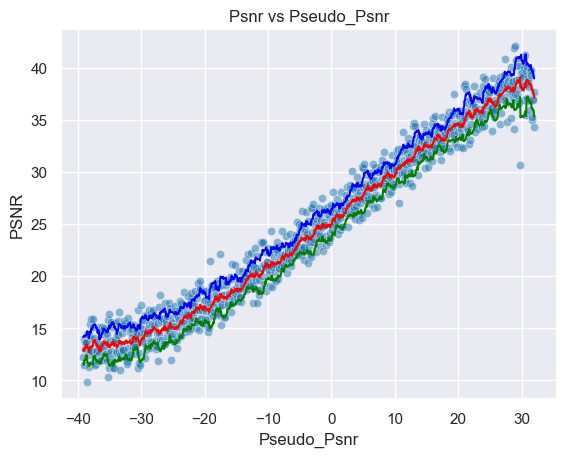

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

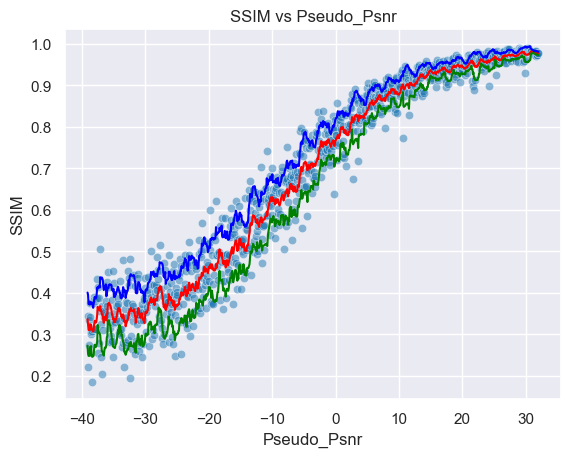

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

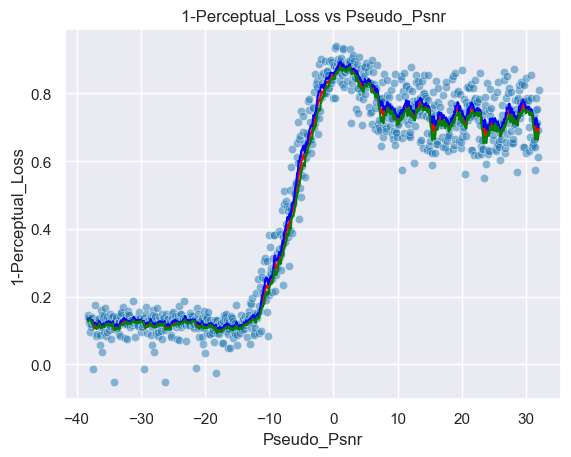

Psnr Area: 1738.447969367729, SSIM Area: 48.43159566101959, Perceptual Area: 33.34770840313596
Mean Psnr 24.58907258946609
Std Psnr 8.462182113534602
Min Psnr 9.802311125227977
Max Psnr 42.08047390659832
Mean Roll Var 1.3900220212823229
Mean SSIM 0.68495584
Std SSIM 0.24043424427509308
Min SSIM 0.18421046435832977
Max SSIM 0.9889883399009705
Mean Roll SSIM 0.04419359752291515
Mean 1-PL 0.4783605
Std 1-PL 0.31135663390159607
Min 1-PL -0.05293166637420654
Max 1-PL 0.9392081499099731
Mean Roll 1-PL 0.052287632094123244


(1738.447969367729, 48.43159566101959, 33.34770840313596)

In [96]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Eighth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_9, SSIM_Distribution_9, Perceptual_Distribution_9, minpsnr, maxpsnr)

In [97]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
print(PSNR_Ranges[-9][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 32


(16384, 4096)

In [98]:
# Creates the directory to save the model in for the Ninth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/" 

In [92]:
# Trains the model using the Pytorch Lightning Trainer for the Ninth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [93]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [99]:
# Loads the model from the checkpoint for the Ninth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [95]:
# Validates the trained model on the Train Set for the Ninth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.13473939895629883    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.13473939895629883}]

In [96]:
# Validates the trained model on the Validation Set for the Ninth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.13573947548866272    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.13573947548866272}]

1.7945433 0.11259879 1.787505865097046 0.9570897221565247
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -32.821922302246094
-33.11329952303793 -33.11329952303793 0.0


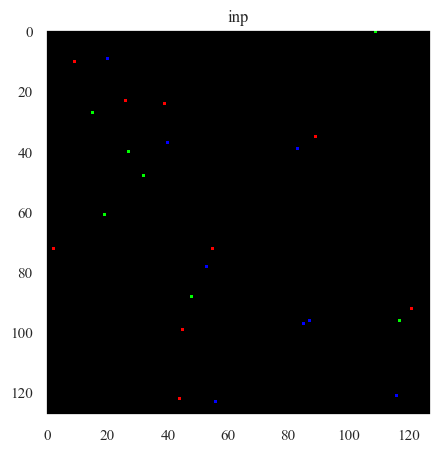

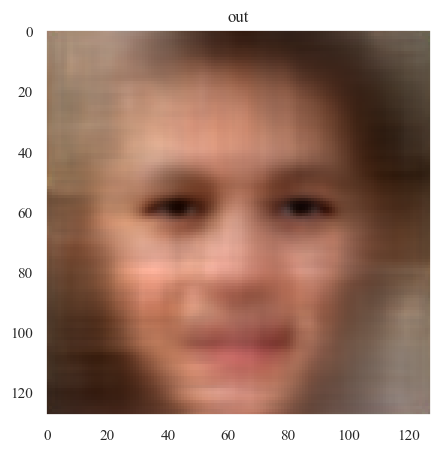

Text(0.5, 1.0, 'GT')

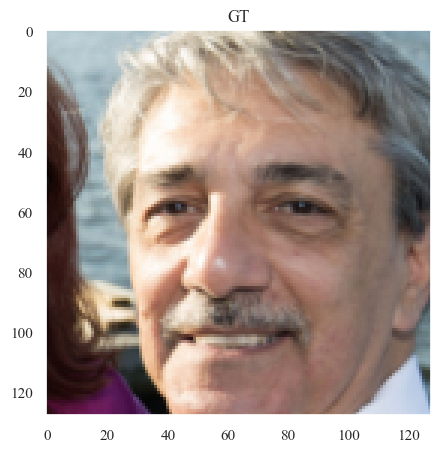

In [31]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

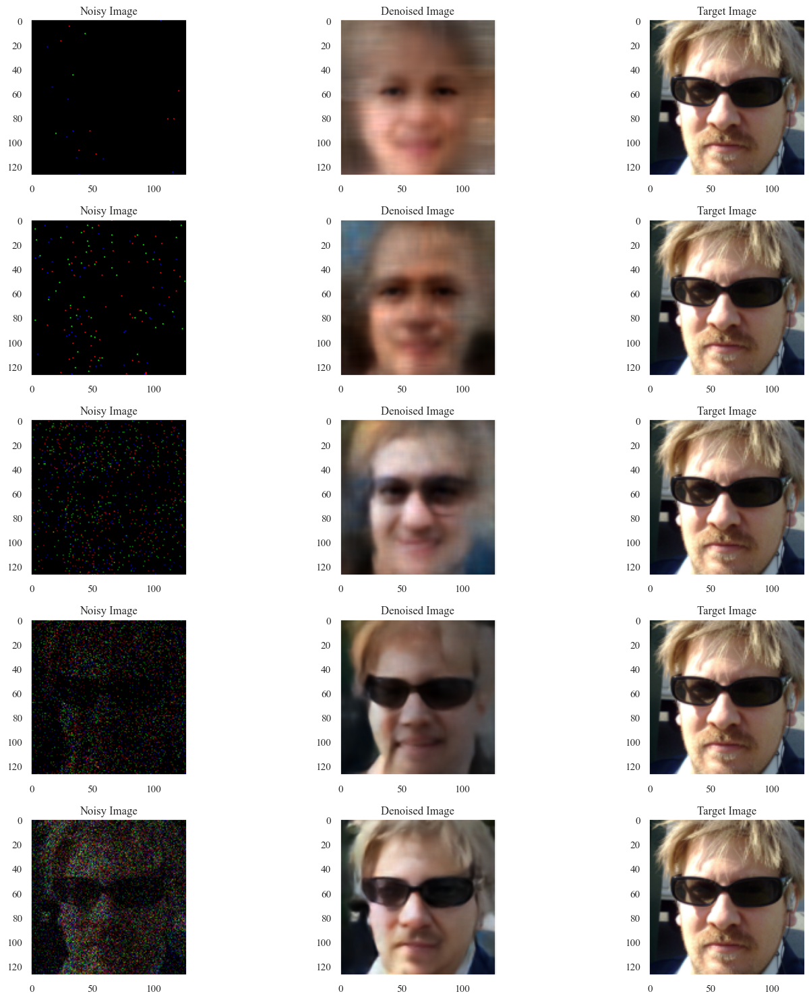

In [32]:
# Plots for a sample image the Noisy Image, its corresponding denoised image and the Target Image.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

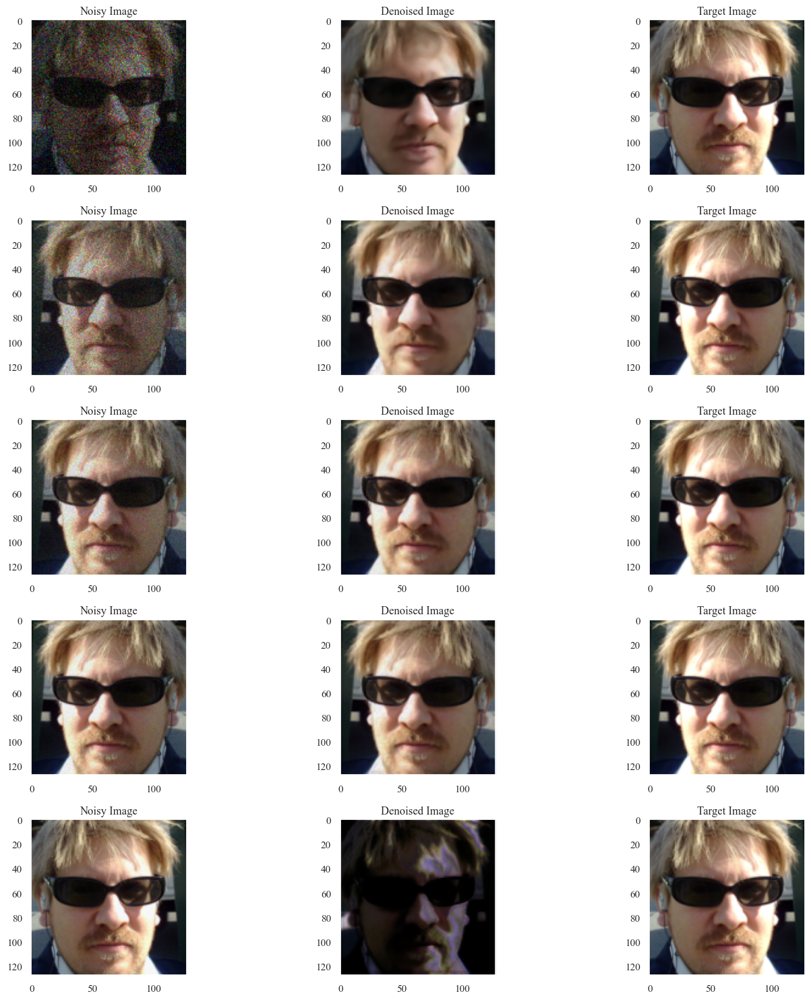

In [33]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [100]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Ninth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_10 = np.array(Psnr_Distribution)
SSIM_Distribution_10 = np.array(SSIM_Distribution)
Perceptual_Distribution_10 = np.array(Perceptual_Distribution)
Psnr_Distribution_10.shape, SSIM_Distribution_10.shape, Perceptual_Distribution_10.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,24.541814,-3.559511,24.400493,1.367283,25.767775,23.033210
std,8.328825,20.564969,8.209242,0.287022,8.204183,8.224321
min,9.575780,-39.119021,12.947029,0.783112,14.216787,11.385365
25%,16.734991,-21.339266,16.719349,1.163924,17.945560,15.259095
50%,23.798035,-3.559511,23.674836,1.334914,25.073390,22.245045
75%,32.211278,14.220245,32.179657,1.533536,33.591495,30.863879
max,41.241597,32.000000,38.479678,2.230852,40.282135,36.688277


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.686522,-3.559511,0.682646,0.044405,0.727051,0.638241
std,0.239055,20.564969,0.234683,0.022175,0.215630,0.254242
min,0.186922,-39.119021,0.323024,0.002799,0.382531,0.252143
25%,0.451659,-21.339266,0.436155,0.022892,0.490568,0.377344
50%,0.725040,-3.559511,0.713248,0.049515,0.773765,0.659966
75%,0.922911,14.220245,0.924112,0.062631,0.948092,0.898526
max,0.988982,32.000000,0.982110,0.094921,0.992813,0.978654


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.478841,-3.119021,0.475186,0.052427,0.484471,0.465901
std,0.312019,20.310653,0.307844,0.021402,0.310655,0.305153
min,-0.052713,-38.238042,0.095921,0.011046,0.098457,0.091896
25%,0.131101,-20.678532,0.123193,0.033578,0.126408,0.119664
50%,0.633075,-3.119021,0.683376,0.054652,0.698368,0.662744
75%,0.765418,14.440489,0.747903,0.069874,0.756771,0.737193
max,0.939754,32.000000,0.888751,0.102171,0.897590,0.879912


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

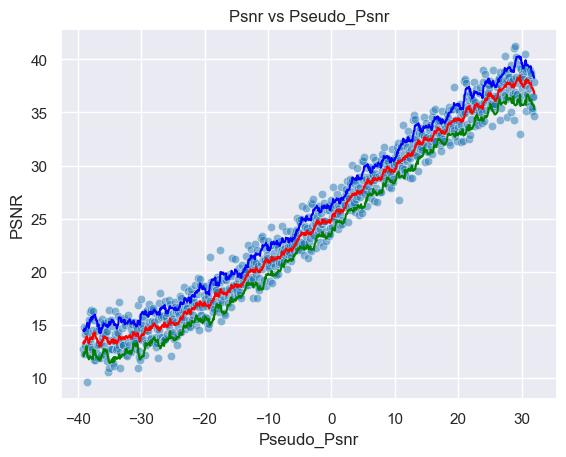

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

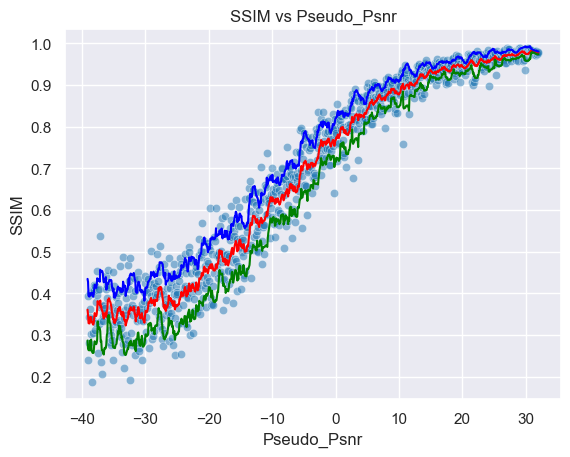

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

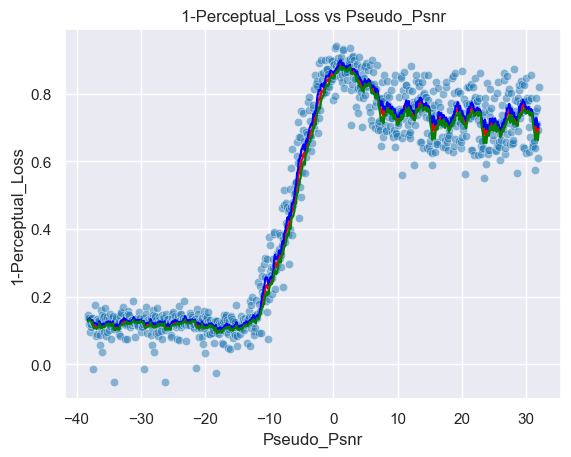

Psnr Area: 1735.2866640991324, SSIM Area: 48.550220750015356, Perceptual Area: 33.38101215290944
Mean Psnr 24.54181405358541
Std Psnr 8.328825425458975
Min Psnr 9.575780044219087
Max Psnr 41.24159748881623
Mean Roll Var 1.3672828790406115
Mean SSIM 0.6865222
Std SSIM 0.23905476927757263
Min SSIM 0.18692223727703094
Max SSIM 0.9889815449714661
Mean Roll SSIM 0.04440476000613514
Mean 1-PL 0.47884116
Std 1-PL 0.3120190501213074
Min 1-PL -0.05271291732788086
Max 1-PL 0.9397538304328918
Mean Roll 1-PL 0.05242670712205696


(1735.2866640991324, 48.550220750015356, 33.38101215290944)

In [101]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_10, SSIM_Distribution_10, Perceptual_Distribution_10, minpsnr, maxpsnr)

In [162]:
len(Psnr_Distribution_3)

900

In [163]:
# Combines the data from the 9 uniformly spaced PSNR ranges into a single dataframe.
uniform = np.linspace(-40, 32, 900)
Psnr_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Psnr_Distribution_m40_32":Psnr_Distribution_1, "Psnr_Distribution_24_32":Psnr_Distribution_2, "Psnr_Distribution_16_24":Psnr_Distribution_3, 
                                  "Psnr_Distribution_8_16":Psnr_Distribution_4, "Psnr_Distribution_0_8":Psnr_Distribution_5, "Psnr_Distribution_m8_0":Psnr_Distribution_6, 
                                  "Psnr_Distribution_m16_m8":Psnr_Distribution_7, "Psnr_Distribution_m24_m16":Psnr_Distribution_8, "Psnr_Distribution_m32_m24":Psnr_Distribution_9, 
                                  "Psnr_Distribution_m40_m32":Psnr_Distribution_10})
Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
0,-40.000000,13.931335,2.965824,1.777926,7.752539,9.160633,4.535405,6.772977,5.889728,12.586182,13.717225
1,-39.919911,11.197247,0.114115,-1.148825,5.176312,6.927507,2.028131,4.931785,4.720398,10.493051,11.517101
2,-39.839822,15.486684,4.662463,3.402446,9.440553,10.916509,6.430429,8.531198,8.505072,13.517928,14.417404
3,-39.759733,12.448342,4.534579,3.375430,8.410361,8.484501,5.849281,7.143838,8.007141,12.737026,12.690738
4,-39.679644,11.442880,4.333899,2.964611,7.634672,8.111434,5.372209,7.071775,7.530274,11.199945,11.443750
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,26.798373,35.897502,37.385477,37.564773,37.513525,37.438087,36.369437,35.779117,35.294556,35.384882
896,31.759733,28.674237,38.076608,38.637447,38.658097,38.710158,38.585698,38.001324,37.457242,36.968291,36.523914
897,31.839822,29.096009,37.915652,38.517878,38.626107,38.647540,38.333242,37.690644,37.036801,36.917625,36.430834
898,31.919911,30.148988,39.544179,40.497673,40.417423,40.142340,39.998694,38.658032,37.966968,37.688475,37.843776


In [164]:
# Generates the smoothed Psnr Distribution for the combined data.
Smoothed_Psnr_Distribution = Psnr_Distribution.rolling(window=10).mean()
Smoothed_Psnr_Distribution = Smoothed_Psnr_Distribution.dropna()
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,3.765767,2.517077,8.025613,9.042207,5.356223,7.417773,7.688767,12.716801,13.221672
10,-39.559511,13.361748,3.859848,2.614678,8.070743,9.034447,5.467407,7.497255,7.979554,12.998515,13.356386
11,-39.479422,13.514017,4.051239,2.799765,8.205544,9.089950,5.604562,7.643082,8.026839,13.170308,13.476192
12,-39.399333,13.179642,4.155577,2.899596,8.174885,9.029591,5.688962,7.599191,7.944972,12.965172,13.258841
13,-39.319244,13.476313,4.092745,2.825633,8.179771,9.227551,5.670035,7.664545,7.941990,13.086662,13.468660
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.669348,39.245765,39.347532,39.294737,39.064913,38.503733,38.004533,37.780122,37.197509
896,31.399333,29.333183,38.460464,39.081626,39.177622,39.129538,38.901474,38.326651,37.835557,37.569367,37.044768
897,31.479422,29.168538,38.252258,38.914645,39.023758,38.977113,38.733722,38.135886,37.645200,37.386606,36.878880
898,31.559511,29.226247,38.297335,39.033472,39.119571,39.051338,38.813548,38.136726,37.621562,37.340601,36.931315


In [165]:
str(PSNR_Ranges[0][0]) + "_" + str(PSNR_Ranges[-1][1])

'-40_32'

In [180]:
Psnr_columns = ["m40_32", "24_32", "16_32", "8_32", "0_32", "m8_32", "m16_32", "m24_32", "m32_32", "m40_32"]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

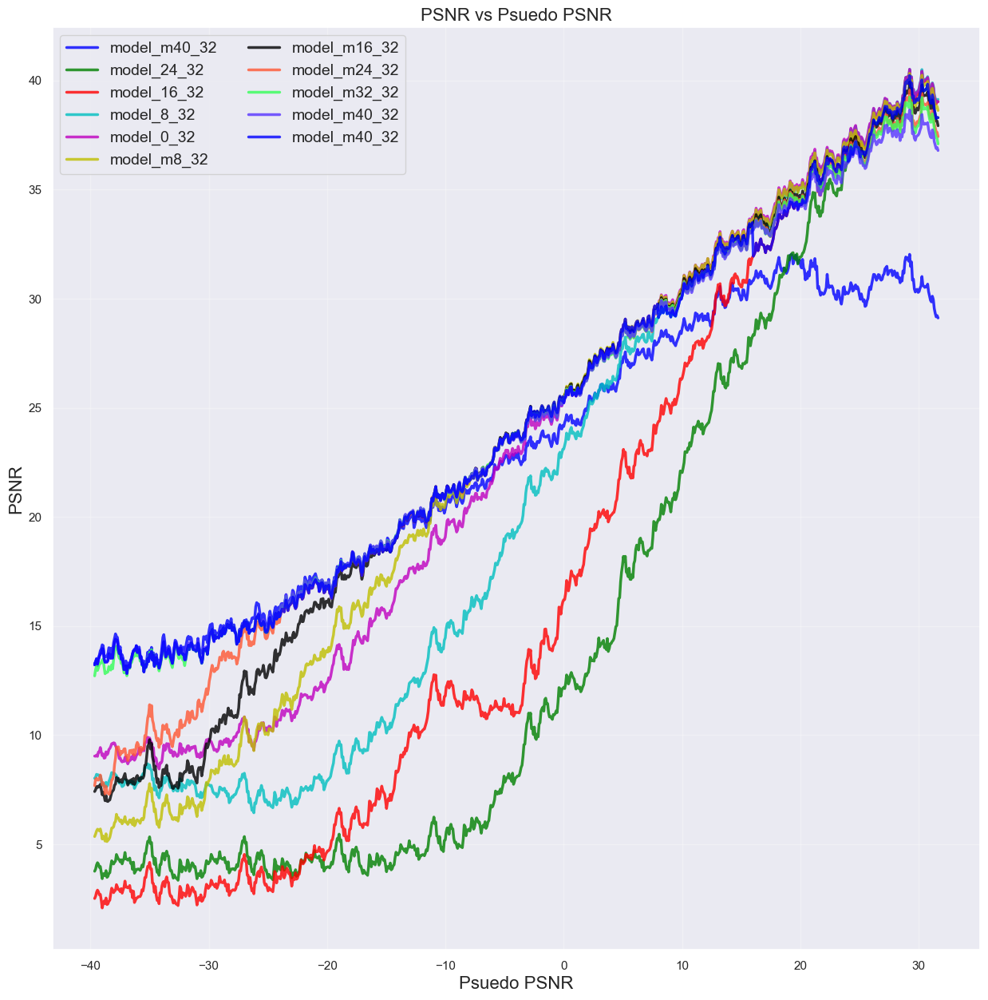

In [181]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Psnr_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [186]:
Psnr_columns = ["m40_32", "24_32", "16_24", "8_16", "0_8", "m8_0", "m16_m8", "m24_m16", "m32_m24", "m40_m32"]

In [187]:
# Combines the 9 different models into a single model.
Augmented_Psnr_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Psnr_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Psnr_Distribution.extend(Specific_Psnr_Distribution)
Augmented_Psnr_Distribution = np.array(Augmented_Psnr_Distribution)
Augmented_Psnr_Distribution.shape

(891,)

In [188]:
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32,Augmented_Psnr_Distribution_m40_32
9,-39.639600,13.287141,3.765767,2.517077,8.025613,9.042207,5.356223,7.417773,7.688767,12.716801,13.221672,13.221672
10,-39.559511,13.361748,3.859848,2.614678,8.070743,9.034447,5.467407,7.497255,7.979554,12.998515,13.356386,13.356386
11,-39.479422,13.514017,4.051239,2.799765,8.205544,9.089950,5.604562,7.643082,8.026839,13.170308,13.476192,13.476192
12,-39.399333,13.179642,4.155577,2.899596,8.174885,9.029591,5.688962,7.599191,7.944972,12.965172,13.258841,13.258841
13,-39.319244,13.476313,4.092745,2.825633,8.179771,9.227551,5.670035,7.664545,7.941990,13.086662,13.468660,13.468660
...,...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.669348,39.245765,39.347532,39.294737,39.064913,38.503733,38.004533,37.780122,37.197509,38.669348
896,31.399333,29.333183,38.460464,39.081626,39.177622,39.129538,38.901474,38.326651,37.835557,37.569367,37.044768,38.460464
897,31.479422,29.168538,38.252258,38.914645,39.023758,38.977113,38.733722,38.135886,37.645200,37.386606,36.878880,38.252258
898,31.559511,29.226247,38.297335,39.033472,39.119571,39.051338,38.813548,38.136726,37.621562,37.340601,36.931315,38.297335


In [189]:
idx = 8
print(PSNR_Ranges[idx][0], PSNR_Ranges[idx][1])
Specific_Psnr_Distribution = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
Specific_Psnr_Distribution.iloc[:, -(idx+1)]

24 32


804    36.995156
805    37.048097
806    37.139603
807    37.532881
808    37.401806
         ...    
895    39.245765
896    39.081626
897    38.914645
898    39.033472
899    39.035353
Name: Psnr_Distribution_16_24, Length: 96, dtype: float64

In [190]:
Smoothed_Psnr_Distribution["Augmented_Psnr_Distribution_m40_32"] = Augmented_Psnr_Distribution

In [193]:
Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
0,-40.000000,13.931335,2.965824,1.777926,7.752539,9.160633,4.535405,6.772977,5.889728,12.586182,13.717225
1,-39.919911,11.197247,0.114115,-1.148825,5.176312,6.927507,2.028131,4.931785,4.720398,10.493051,11.517101
2,-39.839822,15.486684,4.662463,3.402446,9.440553,10.916509,6.430429,8.531198,8.505072,13.517928,14.417404
3,-39.759733,12.448342,4.534579,3.375430,8.410361,8.484501,5.849281,7.143838,8.007141,12.737026,12.690738
4,-39.679644,11.442880,4.333899,2.964611,7.634672,8.111434,5.372209,7.071775,7.530274,11.199945,11.443750
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,26.798373,35.897502,37.385477,37.564773,37.513525,37.438087,36.369437,35.779117,35.294556,35.384882
896,31.759733,28.674237,38.076608,38.637447,38.658097,38.710158,38.585698,38.001324,37.457242,36.968291,36.523914
897,31.839822,29.096009,37.915652,38.517878,38.626107,38.647540,38.333242,37.690644,37.036801,36.917625,36.430834
898,31.919911,30.148988,39.544179,40.497673,40.417423,40.142340,39.998694,38.658032,37.966968,37.688475,37.843776


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

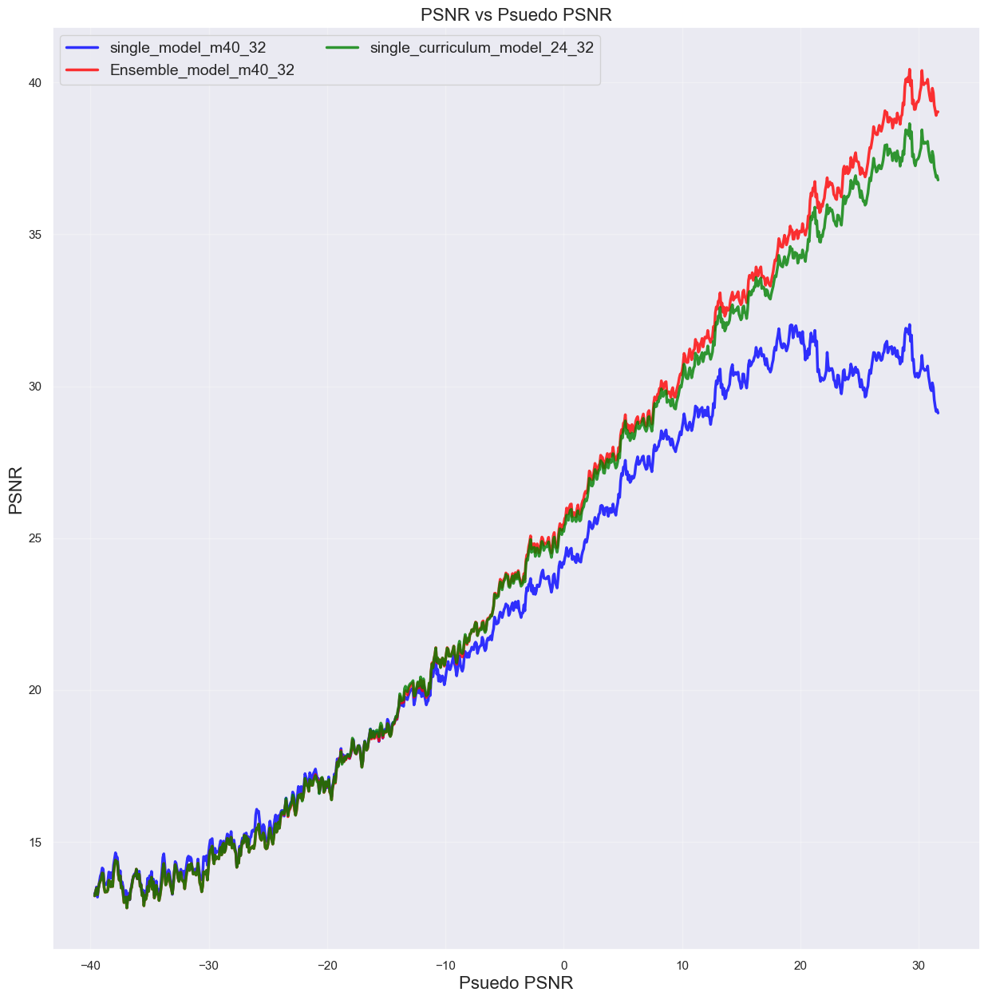

In [196]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Psnr_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Augmented_Psnr_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Psnr_Distribution_m40_m32", alpha = 0.8, color = "green", linewidth = 2.5, label = "single_curriculum_model_24_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [197]:
# Generates the SSIM Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
SSIM_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "SSIM_Distribution_m40_32":SSIM_Distribution_1, "SSIM_Distribution_24_32":SSIM_Distribution_2, "SSIM_Distribution_16_24":SSIM_Distribution_3, 
                                  "SSIM_Distribution_8_16":SSIM_Distribution_4, "SSIM_Distribution_0_8":SSIM_Distribution_5, "SSIM_Distribution_m8_0":SSIM_Distribution_6, 
                                  "SSIM_Distribution_m16_m8":SSIM_Distribution_7, "SSIM_Distribution_m24_m16":SSIM_Distribution_8, "SSIM_Distribution_m32_m24":SSIM_Distribution_9, 
                                  "SSIM_Distribution_m40_m32":SSIM_Distribution_10})
SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
0,-40.000000,0.390496,0.253798,0.196361,0.161022,0.247516,0.183858,0.124038,0.172239,0.370969,0.403045
1,-39.919911,0.526384,0.417053,0.244692,0.209443,0.261563,0.136157,0.105288,0.150743,0.434785,0.504895
2,-39.839822,0.375515,0.339386,0.229182,0.259804,0.230299,0.186205,0.202120,0.219049,0.324727,0.350918
3,-39.759733,0.356718,0.240629,0.167631,0.172278,0.196275,0.143967,0.115438,0.161235,0.362227,0.364012
4,-39.679644,0.221678,0.187922,0.133980,0.142846,0.160498,0.106759,0.098390,0.135007,0.204110,0.216898
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.918908,0.984814,0.987450,0.987436,0.987499,0.986937,0.984675,0.983575,0.982493,0.982019
896,31.759733,0.911203,0.976551,0.977515,0.978458,0.979141,0.978951,0.977613,0.975438,0.973708,0.974465
897,31.839822,0.906421,0.975027,0.978079,0.978669,0.979973,0.978733,0.977270,0.975729,0.973539,0.974554
898,31.919911,0.928583,0.982508,0.984544,0.984695,0.984485,0.983542,0.979446,0.976500,0.977109,0.976412


In [198]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Smoothed_SSIM_Distribution = SSIM_Distribution.rolling(window=10).mean()
Smoothed_SSIM_Distribution = Smoothed_SSIM_Distribution.dropna()
Smoothed_SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
9,-39.639600,0.351868,0.263678,0.177714,0.174447,0.202055,0.140045,0.121926,0.168609,0.326466,0.349899
10,-39.559511,0.356867,0.268843,0.178387,0.174019,0.195633,0.135927,0.126411,0.171980,0.332020,0.353495
11,-39.479422,0.345892,0.260380,0.172812,0.172588,0.191973,0.133917,0.125131,0.167022,0.322938,0.342285
12,-39.399333,0.332943,0.248024,0.164495,0.162927,0.187464,0.129553,0.115811,0.159027,0.312515,0.331218
13,-39.319244,0.327897,0.245457,0.163550,0.160261,0.188229,0.128384,0.117285,0.160867,0.303659,0.322997
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.925335,0.979839,0.981019,0.981817,0.981863,0.981123,0.979408,0.978500,0.977110,0.977367
896,31.399333,0.923415,0.979794,0.981022,0.981779,0.981883,0.981176,0.979458,0.978457,0.977026,0.977329
897,31.479422,0.920253,0.979157,0.980676,0.981437,0.981632,0.980867,0.979120,0.978076,0.976546,0.976898
898,31.559511,0.920735,0.979576,0.981319,0.981924,0.982101,0.981235,0.979257,0.977994,0.976677,0.976845


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

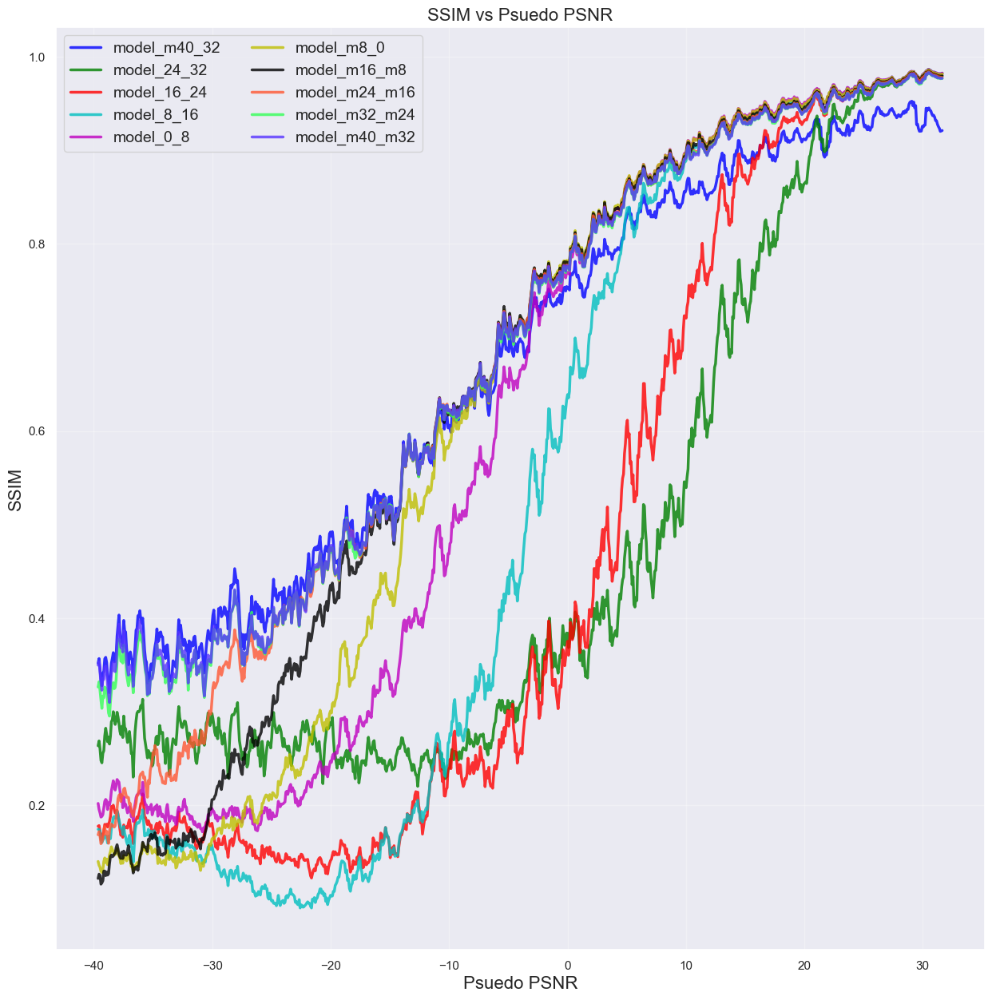

In [199]:
# Plots the SSIM vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, SSIM in enumerate(Smoothed_SSIM_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = SSIM, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [200]:
# Combines the 9 different models into a single model.
Augmented_SSIM_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_SSIM_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_SSIM_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_SSIM_Distribution.extend(Specific_SSIM_Distribution)
Augmented_SSIM_Distribution = np.array(Augmented_SSIM_Distribution)
Augmented_SSIM_Distribution.shape

(891,)

In [201]:
Smoothed_SSIM_Distribution["Augmented_SSIM_Distribution_m40_32"] = Augmented_SSIM_Distribution

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

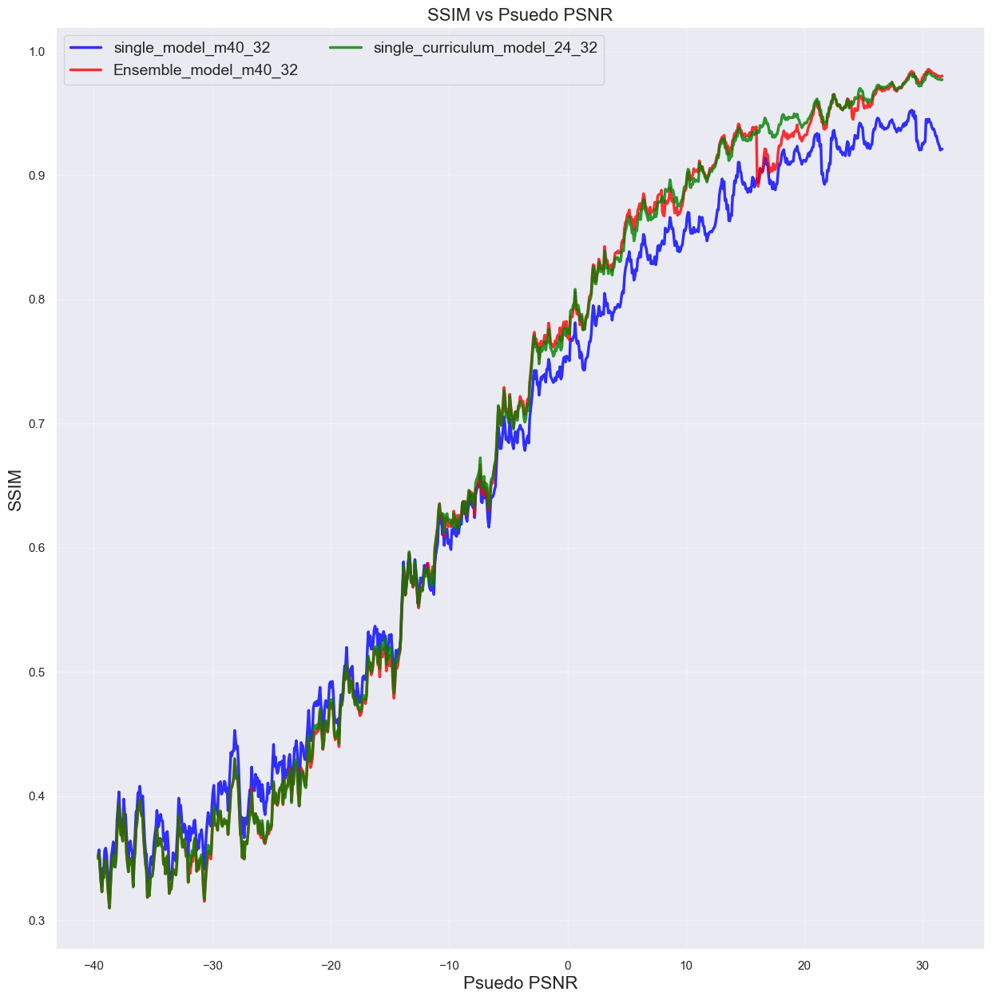

In [203]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "SSIM_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "Augmented_SSIM_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "SSIM_Distribution_m40_m32", alpha = 0.8, color = "green", linewidth = 2.5, label = "single_curriculum_model_24_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [204]:
# Generates the Perceptual Loss Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
Perceptual_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Perceptual_Distribution_m40_32":Perceptual_Distribution_1, "Perceptual_Distribution_24_32":Perceptual_Distribution_2, "Perceptual_Distribution_16_24":Perceptual_Distribution_3, 
                                  "Perceptual_Distribution_8_16":Perceptual_Distribution_4, "Perceptual_Distribution_0_8":Perceptual_Distribution_5, "Perceptual_Distribution_m8_0":Perceptual_Distribution_6, 
                                  "Perceptual_Distribution_m16_m8":Perceptual_Distribution_7, "Perceptual_Distribution_m24_m16":Perceptual_Distribution_8, "Perceptual_Distribution_m32_m24":Perceptual_Distribution_9, 
                                  "Perceptual_Distribution_m40_m32":Perceptual_Distribution_10})
Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
0,-40.000000,0.172402,0.172497,0.172497,0.172354,0.172295,0.172416,0.172348,0.172334,0.172381,0.172388
1,-39.919911,0.151720,0.151895,0.151897,0.151701,0.151643,0.151683,0.151620,0.151637,0.151700,0.151701
2,-39.839822,0.126976,0.127165,0.127179,0.126889,0.126908,0.127004,0.126913,0.126905,0.126952,0.126952
3,-39.759733,0.153367,0.153395,0.153363,0.153384,0.153202,0.153189,0.153201,0.153248,0.153345,0.153351
4,-39.679644,0.111610,0.111719,0.111644,0.111701,0.111473,0.111426,0.111448,0.111506,0.111604,0.111618
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.700143,0.755424,0.763711,0.763720,0.763434,0.762786,0.758357,0.760405,0.754817,0.756184
896,31.759733,0.675431,0.710425,0.713708,0.714281,0.713992,0.713524,0.713968,0.715812,0.711793,0.709969
897,31.839822,0.577300,0.607244,0.613820,0.614417,0.616557,0.616107,0.614117,0.615170,0.611803,0.610311
898,31.919911,0.661423,0.696174,0.699537,0.701223,0.700756,0.700253,0.695261,0.695077,0.693296,0.691690


In [205]:
# Generates the smoothed Perceptual Loss Distribution for the combined data.
Smoothed_Perceptual_Distribution = Perceptual_Distribution.rolling(window=10).mean()
Smoothed_Perceptual_Distribution = Smoothed_Perceptual_Distribution.dropna()
Smoothed_Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
9,-39.639600,0.135467,0.135591,0.135565,0.135444,0.135336,0.135360,0.135338,0.135365,0.135446,0.135455
10,-39.559511,0.136927,0.137045,0.137019,0.136906,0.136791,0.136806,0.136789,0.136817,0.136907,0.136915
11,-39.479422,0.135272,0.135384,0.135354,0.135253,0.135131,0.135142,0.135130,0.135159,0.135252,0.135261
12,-39.399333,0.134909,0.135017,0.134984,0.134904,0.134764,0.134766,0.134760,0.134785,0.134892,0.134900
13,-39.319244,0.127537,0.127652,0.127624,0.127520,0.127399,0.127407,0.127394,0.127418,0.127522,0.127531
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.648668,0.684697,0.688799,0.689769,0.689368,0.688493,0.686052,0.687853,0.685002,0.684840
896,31.399333,0.655081,0.691673,0.695832,0.696874,0.696349,0.695542,0.693413,0.695095,0.692034,0.691691
897,31.479422,0.649299,0.686905,0.691405,0.692620,0.692327,0.691415,0.689218,0.691022,0.687800,0.687199
898,31.559511,0.653860,0.692127,0.696592,0.697857,0.697509,0.696533,0.693988,0.695677,0.692385,0.691742


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

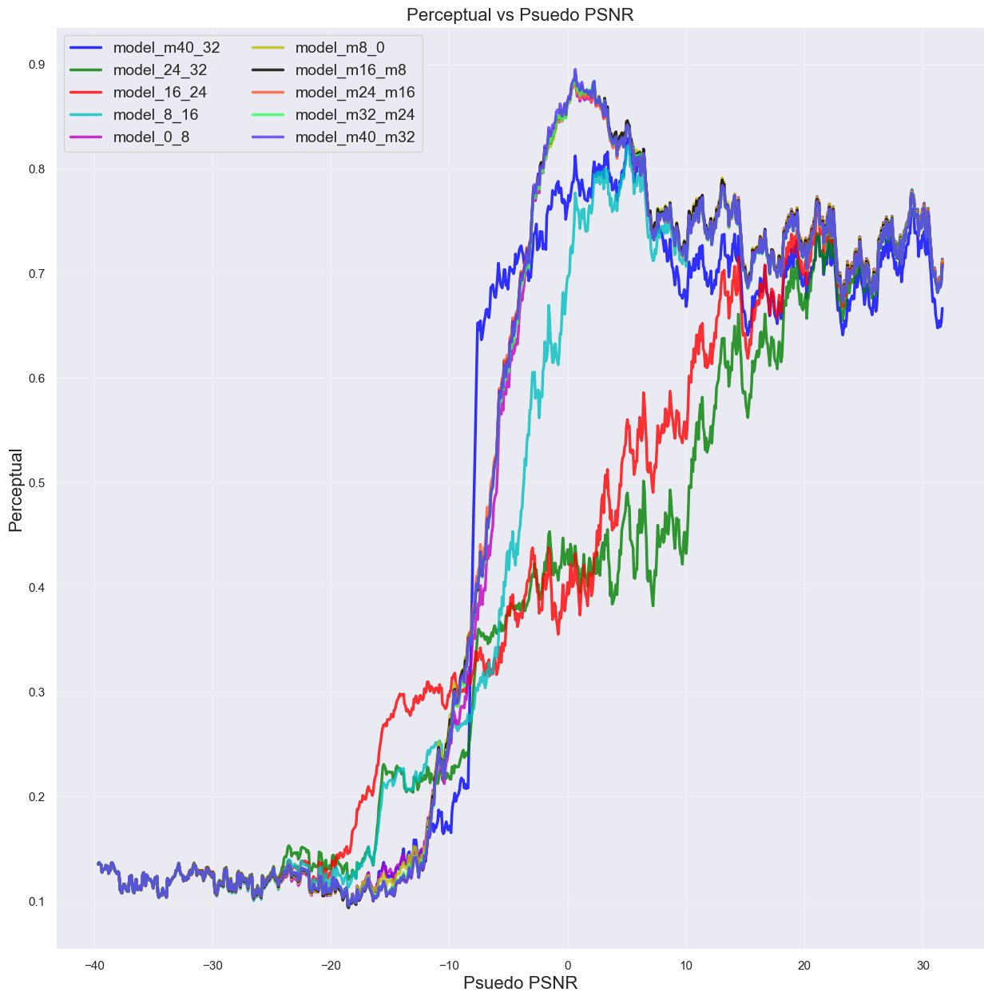

In [206]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Perceptual_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [207]:
# Combines the 9 different models into a single model.
Augmented_Perceptual_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Perceptual_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Perceptual_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Perceptual_Distribution.extend(Specific_Perceptual_Distribution)
Augmented_Perceptual_Distribution = np.array(Augmented_Perceptual_Distribution)
Augmented_Perceptual_Distribution.shape

(891,)

In [208]:
Smoothed_Perceptual_Distribution["Augmented_Perceptual_Distribution_m40_32"] = Augmented_Perceptual_Distribution

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

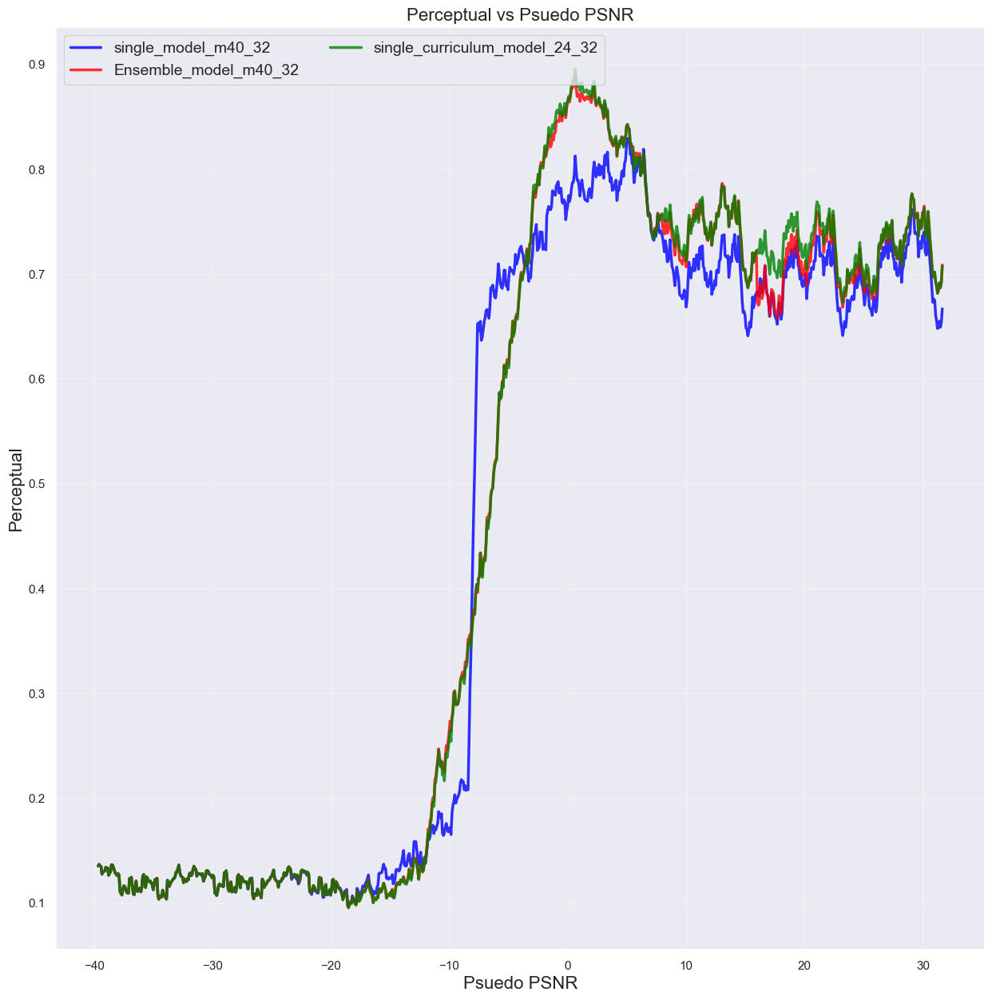

In [209]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Perceptual_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Augmented_Perceptual_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Perceptual_Distribution_m40_m32", alpha = 0.8, color = "green", linewidth = 2.5, label = "single_curriculum_model_24_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [23]:
# Loads the models from their checkpoints and combines them to form the ensemble model.
name = "FaceGenerationProgressiveUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/"
model_m40_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m32-32"
CHECKPOINT_PATH = "./models/"
model_m32_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m24-32"
CHECKPOINT_PATH = "./models/"
model_m24_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m16-32"
CHECKPOINT_PATH = "./models/"
model_m16_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m8-32"
CHECKPOINT_PATH = "./models/"
model_m8_0 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-0-32"
CHECKPOINT_PATH = "./models/"
model_0_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-8-32"
CHECKPOINT_PATH = "./models/"
model_8_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-16-32"
CHECKPOINT_PATH = "./models/"
model_16_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/"
model_24_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

Models = [model_m40_32, model_m32_24, model_m24_16, model_m16_8, model_m8_0, model_0_8, model_8_16, model_16_24, model_24_32]
Models

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


[UNet(
   (conv_final): Conv2d(50, 3, kernel_size=(1, 1), stride=(1, 1))
   (down_convs): ModuleList(
     (0): DownConv(
       (conv1): Conv2d(30, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (1): DownConv(
       (conv1): Conv2d(50, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (2): DownConv(
       (conv1): Conv2d(100, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(200, 200, kernel_size=(3, 3), stride=(1,

In [36]:
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1
    model = model.to(device)

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        print("Hello World", psnr, max_psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            print(max_photons, "Maximum Photons Reached")
            break
            
        if psnr > max_psnr:
            print(psnr, "Maximum Psnr Reached")
            break
    
        denoised = model(photons).detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    denoised_2 = denoised[...].detach().cpu().numpy()
    denoised_2 = (denoised_2 - denoised_2.min())/(denoised_2.max() - denoised_2.min())
    vmax = denoised_2.max()
    plt.figure(figsize=(5,5))
    plt.imshow(denoised_2[0].transpose(1,2,0),vmin = 0, vmax = vmax)
    plt.show()
    plt.clf()
    return denoised, photons, stack, i, psnr


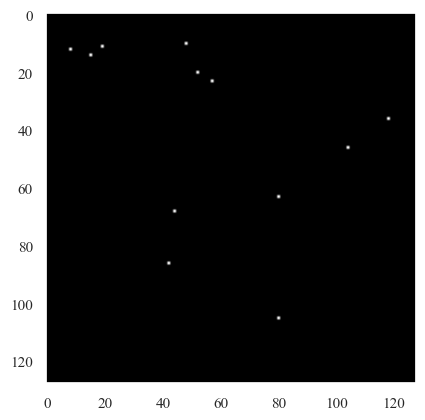

PSNR: -30.326692581176758


In [25]:
# Checks the Train_Dataset works
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(40)
plt.imshow(ImageNoise.detach().cpu().numpy().transpose(1,2,0)[:,:,0], cmap = "gray")
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")

In [26]:
PSNR_Ranges

[(-40, -32),
 (-32, -24),
 (-24, -16),
 (-16, -8),
 (-8, 0),
 (0, 8),
 (8, 16),
 (16, 24),
 (24, 32)]

PSNR: -500.0
Model: 1, psnr_level -32
Hello World -40 -32
-40
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -39.92571168970606 -32
-39.92571168970606
Hello World -38.46443124417179 -32
Hello World -38.46443124417179 -32
Hello World -37.884511940804714 -32
Hello World -36.91541173306625 -32
Hello World -36.91541173306625 -32
Hello World -36.50148499444094 -32
Hello World -36.12359947967774 -32
Hello World -36.12359947967774 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
-35.45413128753198
Hello World -35.45413128753198 -32
Hello World -34.8742119841649 -32
Hello World -34.12787582163215 -32
Hello World -33.90511177642644 -32
Hello World -33.90511177642644 -32
Hello World -33.49118503780113 -32
Hello World -33.11329952303793 -32
Hello World -33.11329952303793 -32
Hello World -32.601774298564116 -32
Hello World -32.291

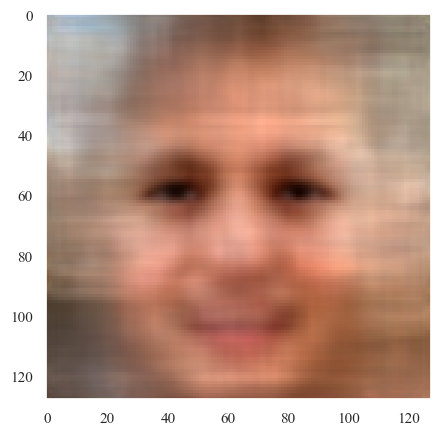

Psnr_Range -31.863912027525096 has been reached at 33 iterations
Model: 2, psnr_level -24
Hello World -31.863912027525096 -24
-31.863912027525096
Hello World -31.863912027525096 -24
Hello World -31.73027254137512 -24
Hello World -31.600622526098803 -24
Hello World -31.600622526098803 -24
Hello World -31.600622526098803 -24
Hello World -31.600622526098803 -24
Hello World -31.474731378315383 -24
Hello World -31.35238693248112 -24
Hello World -31.2333944756054 -24
Hello World -31.11757586499234 -24
-31.11757586499234
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -30.894811819786625 -24
Hello World -30.78757327193823 -24
Hello World -30.68291903617499 -24
Hello World -30.580727191718363 -24
-30.580727191718363
Hello World -30.480885081161325 -24
Hello World -30.480885081161325 -24
Hello World -30.28783344326195

<Figure size 640x480 with 0 Axes>

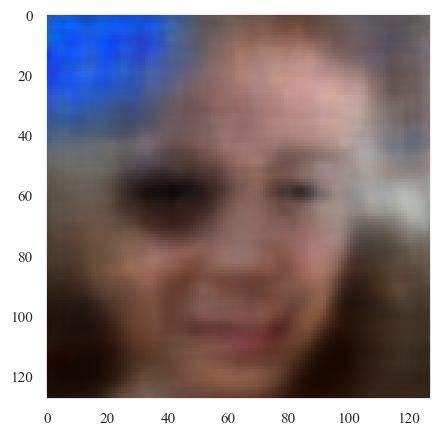

Psnr_Range -23.99285105753801 has been reached at 141 iterations
Model: 3, psnr_level -16
Hello World -23.99285105753801 -16
-23.99285105753801
Hello World -23.970749342151887 -16
Hello World -23.94876003753868 -16
Hello World -23.905111652173797 -16
Hello World -23.905111652173797 -16
Hello World -23.883451365949103 -16
Hello World -23.883451365949103 -16
Hello World -23.79787316796699 -16
Hello World -23.79787316796699 -16
Hello World -23.776739414772766 -16
Hello World -23.734778431228115 -16
-23.734778431228115
Hello World -23.65205301828121 -16
Hello World -23.631615905766616 -16
Hello World -23.570874428644682 -16
Hello World -23.510970791752808 -16
Hello World -23.412931460972736 -16
Hello World -23.412931460972736 -16
Hello World -23.355153076292908 -16
Hello World -23.29813329185599 -16
Hello World -23.27929214123255 -16
Hello World -23.18629162965599 -16
-23.18629162965599
Hello World -23.131432653400328 -16
Hello World -23.05934920417087 -16
Hello World -22.988442273411426 -

<Figure size 640x480 with 0 Axes>

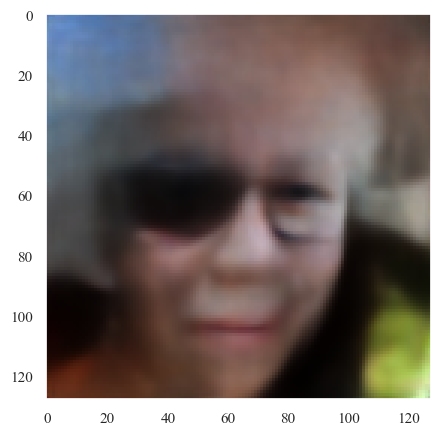

Psnr_Range -15.995227232626021 has been reached at 187 iterations
Model: 4, psnr_level -8
Hello World -15.995227232626021 -8
-15.995227232626021
Hello World -15.970700547111514 -8
Hello World -15.918605423706836 -8
Hello World -15.880795719206944 -8
Hello World -15.819626471110125 -8
Hello World -15.775978315134736 -8
Hello World -15.729458287916371 -8
Hello World -15.703097188149222 -8
Hello World -15.647606071052456 -8
Hello World -15.592815044843547 -8
Hello World -15.541870729845966 -8
-15.541870729845966
Hello World -15.497779637396112 -8
Hello World -15.43864860341122 -8
Hello World -15.392528402988106 -8
Hello World -15.337822987518345 -8
Hello World -15.286782006934732 -8
Hello World -15.221606897301147 -8
Hello World -15.186464873622052 -8
Hello World -15.15449934959718 -8
Hello World -15.094119799624009 -8
Hello World -15.068497631978005 -8
-15.068497631978005
Hello World -15.023316701417212 -8
Hello World -14.992525814472788 -8
Hello World -14.9508865231201 -8
Hello World -1

<Figure size 640x480 with 0 Axes>

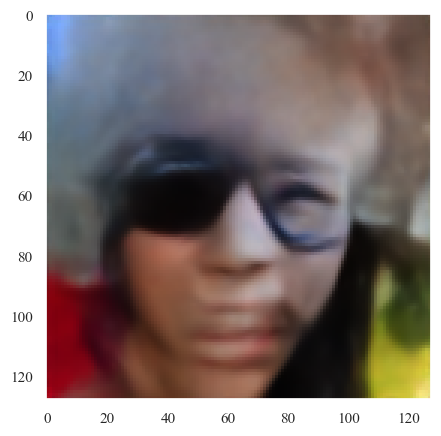

Psnr_Range -7.986122116601935 has been reached at 183 iterations
Model: 5, psnr_level 0
Hello World -7.986122116601935 0
-7.986122116601935
Hello World -7.940240511900923 0
Hello World -7.887227259331456 0
Hello World -7.8450624153198225 0
Hello World -7.809701455341407 0
Hello World -7.765109037562383 0
Hello World -7.722538535110165 0
Hello World -7.672101840647441 0
Hello World -7.6258232816014395 0
Hello World -7.581551273912156 0
Hello World -7.534219125945048 0
-7.534219125945048
Hello World -7.499303918617653 0
Hello World -7.4582646794093 0
Hello World -7.4137113420719905 0
Hello World -7.375400027587488 0
Hello World -7.335031545601015 0
Hello World -7.291718467827909 0
Hello World -7.24930195883257 0
Hello World -7.201725458985192 0
Hello World -7.1574187312549 0
Hello World -7.10901626571662 0
-7.10901626571662
Hello World -7.072389620354959 0
Hello World -7.022248672915287 0
Hello World -6.975321501416161 0
Hello World -6.920626391048268 0
Hello World -6.878652809530874 0
H

<Figure size 640x480 with 0 Axes>

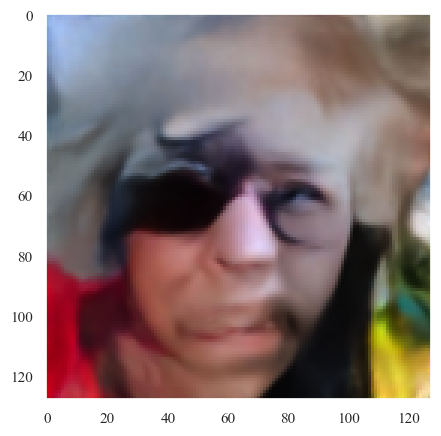

Psnr_Range 0.029587086437045947 has been reached at 186 iterations
Model: 6, psnr_level 8
Hello World 0.029587086437045947 8
0.029587086437045947
Hello World 0.06994298546601943 8
Hello World 0.11294184176529798 8
Hello World 0.15406932872396978 8
Hello World 0.20105796790352892 8
Hello World 0.24754364882341895 8
Hello World 0.2899020235797447 8
Hello World 0.33250637816014483 8
Hello World 0.3729126568872018 8
Hello World 0.41840667216470073 8
Hello World 0.46549365472273363 8
0.46549365472273363
Hello World 0.5104256794575652 8
Hello World 0.5528755292254832 8
Hello World 0.5936814027178372 8
Hello World 0.6357110219448328 8
Hello World 0.6795289812864374 8
Hello World 0.7213384247979768 8
Hello World 0.7622301495427053 8
Hello World 0.8067047226448264 8
Hello World 0.8490575821051811 8
Hello World 0.89272787899381 8
0.89272787899381
Hello World 0.9362488755956526 8
Hello World 0.9795492085894462 8
Hello World 1.0215841224543412 8
Hello World 1.0625939071541954 8
Hello World 1.10424

<Figure size 640x480 with 0 Axes>

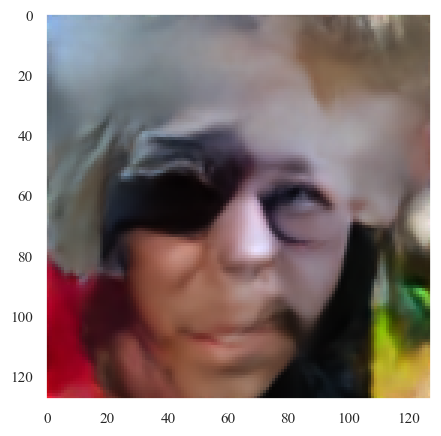

Psnr_Range 8.025354535917575 has been reached at 185 iterations
Model: 7, psnr_level 16
Hello World 8.025354535917575 16
8.025354535917575
Hello World 8.0683417597373 16
Hello World 8.111193989132389 16
Hello World 8.15410080014922 16
Hello World 8.197136766663222 16
Hello World 8.239577765543306 16
Hello World 8.283182984986519 16
Hello World 8.326393705721069 16
Hello World 8.36835534931469 16
Hello World 8.411354989370345 16
Hello World 8.453920642303382 16
8.453920642303382
Hello World 8.496735084641816 16
Hello World 8.539007775549933 16
Hello World 8.583432765530972 16
Hello World 8.62731076918196 16
Hello World 8.669681886057427 16
Hello World 8.713449990566579 16
Hello World 8.757181457076072 16
Hello World 8.799999512355875 16
Hello World 8.843460498091812 16
Hello World 8.886251077308163 16
8.886251077308163
Hello World 8.929121585017008 16
Hello World 8.970979665976236 16
Hello World 9.013913195743342 16
Hello World 9.057513323512556 16
Hello World 9.100897366010845 16
Hello

<Figure size 640x480 with 0 Axes>

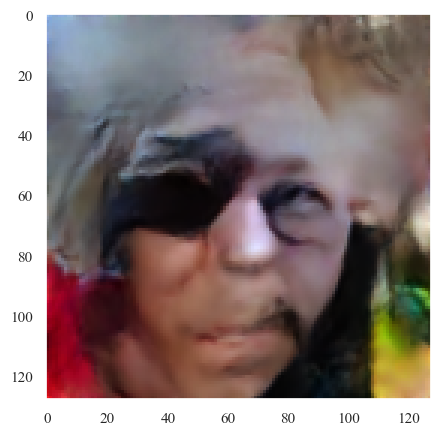

Psnr_Range 16.01636995055426 has been reached at 185 iterations
Model: 8, psnr_level 24
Hello World 16.01636995055426 24
16.01636995055426
Hello World 16.06023895303025 24
Hello World 16.103340114490102 24
Hello World 16.146403593276492 24
Hello World 16.189590453241507 24
Hello World 16.233397684563755 24
Hello World 16.277129375917024 24
Hello World 16.32013285424744 24
Hello World 16.363932971685884 24
Hello World 16.407728429093332 24
Hello World 16.451358578454514 24
16.451358578454514
Hello World 16.494687337694522 24
Hello World 16.53796458212347 24
Hello World 16.58115301312931 24
Hello World 16.624515579840093 24
Hello World 16.667641809329417 24
Hello World 16.71111671133509 24
Hello World 16.754484978045753 24
Hello World 16.79763363538796 24
Hello World 16.84076519450509 24
Hello World 16.883907540580484 24
16.883907540580484
Hello World 16.927229614626103 24
Hello World 16.97052485422059 24
Hello World 17.01410118450683 24
Hello World 17.056908590888558 24
Hello World 17.0

<Figure size 640x480 with 0 Axes>

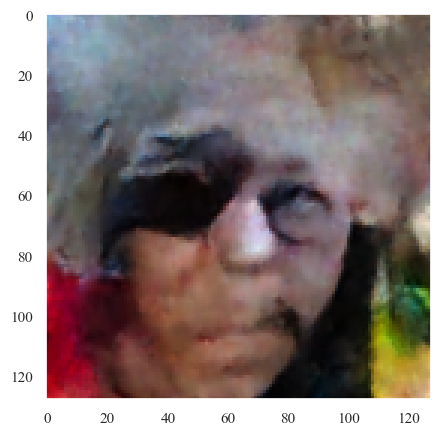

Psnr_Range 24.01409797176461 has been reached at 185 iterations
Model: 9, psnr_level 32
Hello World 24.01409797176461 32
24.01409797176461
Hello World 24.057372050059126 32
Hello World 24.100531628396027 32
Hello World 24.143770358164165 32
Hello World 24.187033675530827 32
Hello World 24.23026909024852 32
Hello World 24.27354503931772 32
Hello World 24.31673788085628 32
Hello World 24.359951725529598 32
Hello World 24.40326396622347 32
Hello World 24.44644227348774 32
24.44644227348774
Hello World 24.489637222169552 32
Hello World 24.532923453818107 32
Hello World 24.57605422372214 32
Hello World 24.61936892988165 32
Hello World 24.66259971772725 32
Hello World 24.705946206646296 32
Hello World 24.749293277617493 32
Hello World 24.79240277879507 32
Hello World 24.835794622485025 32
Hello World 24.879059316321378 32
24.879059316321378
Hello World 24.922207467947235 32
Hello World 24.965373918843166 32
Hello World 25.00870074777709 32
Hello World 25.05183276752986 32
Hello World 25.0949

<Figure size 640x480 with 0 Axes>

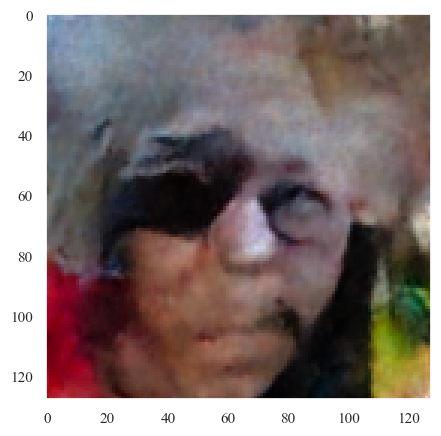

Psnr_Range 32.00938190115394 has been reached at 185 iterations


((9, 1, 3, 128, 128), (9, 1, 3, 128, 128))

<Figure size 640x480 with 0 Axes>

In [27]:
# Generates an unseen image from a blank canvas using the ensemble model.
def Sample_From_Scratch(input_image,
                        Models,
                        max_photons = None,
                        max_its = 500000,
                        max_psnr_list = None,
                        save_every_n = 5,
                        beta = 0.15
                        ):
    output_images = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    output_photons = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    stacks = []
    for i, model in enumerate(Models):
        if i == 0:
            photons = input_image.clone()
        if max_psnr_list is not None:
            max_psnr = max_psnr_list[i]
        else:
            max_psnr = -15
        print(f"Model: {i+1}, psnr_level {max_psnr_list[i]}")
        denoised, photons, stack, it, psnr = sample_image_3(photons, model, max_photons = max_photons, max_its = max_its, max_psnr = max_psnr, save_every_n = save_every_n, beta = beta)
        print(f"Psnr_Range {psnr} has been reached at {it} iterations")
        output_images[i] = denoised[...].detach().cpu().numpy()
        output_photons[i] = photons[...].detach().cpu().numpy()
        stacks.append(stack)

    return output_images, output_photons

inp_img = torch.zeros(1,3,128,128).to(device)
Psnr = np.log10(inp_img.mean().item() + 1e-50) * 10
print(f"PSNR: {Psnr}")
Output_Images, Output_Photons = Sample_From_Scratch(inp_img, Models, max_photons = 1e8, max_its = 1000, max_psnr_list = [-32, -24, -16, -8, 0, 8, 16, 24, 32], save_every_n = 5, beta = 0.01)
Output_Images.shape, Output_Photons.shape

In [28]:
# Generates the images from the blank canvas using the curriculum trained model. 
name = "FaceGenerationProgressiveUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/"
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

torch.Size([1, 3, 128, 128])
Hello World -33.6932189928148 32
-33.6932189928148
Hello World -33.6932189928148 32
Hello World -33.11329952303793 32
Hello World -32.93601152209324 32
Hello World -32.765678301147545 32
Hello World -32.443831330892166 32
Hello World -32.14419939295737 32
Hello World -32.14419939295737 32
Hello World -31.863912027525096 32
Hello World -31.73027254137512 32
Hello World -31.474731378315383 32
-31.474731378315383
Hello World -31.2333944756054 32
Hello World -31.004765869889003 32
Hello World -31.004765869889003 32
Hello World -31.004765869889003 32
Hello World -30.894811819786625 32
Hello World -30.580727191718363 32
Hello World -30.580727191718363 32
Hello World -30.480885081161325 32
Hello World -30.287833443261952 32
Hello World -30.194433272674374 32
-30.194433272674374
Hello World -30.102999566398122 32
Hello World -30.013450970817637 32
Hello World -29.925711565453422 32
Hello World -29.755378344507733 32
Hello World -29.672652931560837 32
Hello World -2

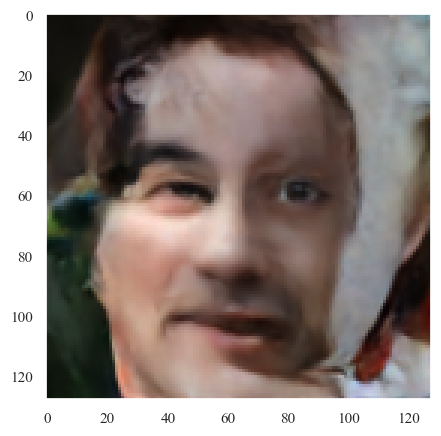

ValueError: too many values to unpack (expected 4)

<Figure size 640x480 with 0 Axes>

In [37]:
# Generates the unseen image from a blank canvas using a curricullum trained model
ImageNoise, Psnr_map, image_target = ValidationNoisyTest_Batch[0], ValidationPsnrTest_Batch[0], ValidationTargetTest_Batch[0]
model = model.to(device)
model.eval()
inp_img = ImageNoise.unsqueeze(0).to(device)
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
vmax = np.percentile(image_target.detach().cpu().numpy(), 99.9)

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 3
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 128
pixels_y = 128

#inp_img =  ImageNoise.unsqueeze(0).to(device)
print(inp_img.shape)
model = model.to(device)

for i in range(1):
    
    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image_3(inp_img,
                                                        model.to(device), 
                                                        max_its=1000,
                                                        beta = 0.01,
                                                        save_every_n = 30,
                                                        max_psnr = PSNR_Ranges[-1][1])
denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
plt.figure(figsize=(5,5))
plt.imshow(denoised[0].transpose(1,2,0),vmin = 0, vmax = vmax)
plt.title('denoised')
plt.show()
plt.clf()
print('_______________________________________', iterations)
endTime = time.time()
elapsedTime = endTime - startTime
print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])